In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
import xgboost as xgb
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score, KFold
import matplotlib.pyplot as plt
import seaborn as sns
import os

In [67]:
# # 從 Google API 上下載字體放到暫存資料夾底下
# !wget 'https://noto-website-2.storage.googleapis.com/pkgs/NotoSansCJKtc-hinted.zip'
# !mkdir /tmp/fonts
# !unzip -o NotoSansCJKtc-hinted.zip -d /tmp/fonts/
# !mv /tmp/fonts/NotoSansMonoCJKtc-Regular.otf /usr/share/fonts/truetype/NotoSansMonoCJKtc-Regular.otf -f
# !rm -rf /tmp/fonts
# !rm NotoSansCJKtc-hinted.zip

--2024-04-18 04:27:25--  https://noto-website-2.storage.googleapis.com/pkgs/NotoSansCJKtc-hinted.zip
Resolving noto-website-2.storage.googleapis.com (noto-website-2.storage.googleapis.com)... 142.251.43.27, 142.251.42.251, 172.217.163.59, ...
Connecting to noto-website-2.storage.googleapis.com (noto-website-2.storage.googleapis.com)|142.251.43.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 121247366 (116M) [application/zip]
Saving to: ‘NotoSansCJKtc-hinted.zip’

NotoSansCJKtc-hinte  43%[=======>            ]  50.78M  19.0MB/s               ^C
Archive:  NotoSansCJKtc-hinted.zip
  End-of-central-directory signature not found.  Either this file is not
  a zipfile, or it constitutes one disk of a multi-part archive.  In the
  latter case the central directory and zipfile comment will be found on
  the last disk(s) of this archive.
note:  NotoSansCJKtc-hinted.zip may be a plain executable, not an archive
unzip:  cannot find zipfile directory in one of NotoSansC

In [2]:
# 指定字體
import matplotlib.font_manager as font_manager
import matplotlib.pyplot as plt

font_dirs = ['/usr/share/fonts/truetype/']
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)

for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
plt.rcParams['font.family'] = "Noto Sans Mono CJK TC"

In [3]:
import os

font_path = '/usr/share/fonts/truetype/NotoSansMonoCJKtc-Regular.otf'
if os.path.exists(font_path):
    print("字體文件存在於系統中。")
else:
    print("字體文件不存在於系統中。")

import matplotlib.pyplot as plt

# 清除 Matplotlib 緩存
plt.rcParams.update({'font.family': 'Noto Sans Mono CJK TC'})
plt.close('all')


字體文件存在於系統中。


In [4]:
# 載入資料
def load_data(csv_file):
    data = pd.read_csv(csv_file,encoding='big5')
    data = data[data['行人性別'] != '不確定']
    X = data.drop(columns=['衝突嚴重程度'])  # 將目標變數以外的特徵當作 X
    y = data['衝突嚴重程度']  # 目標變數當作 y
    return X, y

# 切分資料集
def split_data(X, y, test_size=0.2):
    return train_test_split(X, y, test_size=test_size, random_state=42)

# 邏輯回歸模型
def logistic_regression(X_train, y_train):
    model = LogisticRegression()
    model.fit(X_train, y_train)
    return model

# 支持向量機模型
def support_vector_machine(X_train, y_train):
    model = SVC(probability=True)
    model.fit(X_train, y_train)
    return model

# 決策樹模型
def decision_tree(X_train, y_train):
    model = DecisionTreeClassifier()
    model.fit(X_train, y_train)
    return model

# 隨機森林模型
def random_forest(X_train, y_train):
    model = RandomForestClassifier()
    model.fit(X_train, y_train)
    return model

# 梯度提升模型
def gradient_boosting(X_train, y_train):
    model = GradientBoostingClassifier()
    model.fit(X_train, y_train)
    return model

# XGBoost 模型
def xgboost_model(X_train, y_train):
    model = xgb.XGBClassifier(objective ='multi:softmax', num_class=len(np.unique(y_train)))
    model.fit(X_train, y_train)
    return model

## 分析資料

In [5]:
X, y = load_data('兩段式左轉衝突_正式版.csv')
X = X.drop(columns=['衝突嚴重程度.1','衝突點座標','PET秒數'])


In [6]:
missing_values = X.isnull()

print("缺失值数量：")
print(missing_values.sum())

print("\n是否有缺失值：")
print(missing_values.any().any())

缺失值数量：
RECORD                           765
機車與行人行為                          773
 機車從前面或後面穿越                        0
兩人以上同行                             0
橫斷面分析                            774
行人性別                               0
行人年齡                               0
路口基本幾何                           775
是否機車可右轉行駛車道數為一                     0
是否有超速科技執法                          0
是否有汽車指引線                           0
最外側車道是否有汽車、機車停車格(接近路口幾公尺內30m)      0
行穿線是否位於主要幹道                        0
行穿線後方是否為標線分隔                       0
右轉機車駛入交叉口之車道數是否為一                  0
左轉機車駛離交叉口之車道數是否為一                  0
是否有汽車左轉專用道                         0
是否有左轉停等區                           0
是否有路口行車左轉導引線                       0
行人是否有早開或早關時相                       0
行車管制燈組合是否為三燈組合                     0
右轉機車可行駛的車道路肩寬度                     0
左轉機車可行駛的車道路肩寬度                     0
待轉格深度                              0
待轉格寬度                              0
行穿線至代轉格的直線距離                       0
行穿線總長度                         

In [7]:
missing_values = missing_values.any()

columns_with_missing_values = missing_values[missing_values == True].index.tolist()

X.drop(columns=columns_with_missing_values, inplace=True)

In [8]:
missing_values = X.isnull()

print("缺失值數量：")
print(missing_values.sum())

print("\n是否有缺失值：")
print(missing_values.any().any())

缺失值数量：
 機車從前面或後面穿越                      0
兩人以上同行                           0
行人性別                             0
行人年齡                             0
是否機車可右轉行駛車道數為一                   0
是否有超速科技執法                        0
是否有汽車指引線                         0
最外側車道是否有汽車、機車停車格(接近路口幾公尺內30m)    0
行穿線是否位於主要幹道                      0
行穿線後方是否為標線分隔                     0
右轉機車駛入交叉口之車道數是否為一                0
左轉機車駛離交叉口之車道數是否為一                0
是否有汽車左轉專用道                       0
是否有左轉停等區                         0
是否有路口行車左轉導引線                     0
行人是否有早開或早關時相                     0
行車管制燈組合是否為三燈組合                   0
右轉機車可行駛的車道路肩寬度                   0
左轉機車可行駛的車道路肩寬度                   0
待轉格深度                            0
待轉格寬度                            0
行穿線至代轉格的直線距離                     0
行穿線總長度                           0
行穿線總寬度                           0
衝突點至行穿線退縮距離臨向右側路口路緣的長度           0
衝突點至行穿線退縮距離臨向左側路口路緣的長度           0
衝突點離中央分隔島頂點距離                    0
衝突點離待轉格幾何中心距離                    0
衝突點右轉機車離最外側車道

In [9]:
print(X.shape,y.shape)

(775, 30) (775,)


In [10]:
X.columns

Index([' 機車從前面或後面穿越', '兩人以上同行', '行人性別', '行人年齡', '是否機車可右轉行駛車道數為一', '是否有超速科技執法',
       '是否有汽車指引線', '最外側車道是否有汽車、機車停車格(接近路口幾公尺內30m)', '行穿線是否位於主要幹道',
       '行穿線後方是否為標線分隔', '右轉機車駛入交叉口之車道數是否為一', '左轉機車駛離交叉口之車道數是否為一', '是否有汽車左轉專用道',
       '是否有左轉停等區', '是否有路口行車左轉導引線', '行人是否有早開或早關時相', '行車管制燈組合是否為三燈組合',
       '右轉機車可行駛的車道路肩寬度', '左轉機車可行駛的車道路肩寬度', '待轉格深度', '待轉格寬度', '行穿線至代轉格的直線距離',
       '行穿線總長度', '行穿線總寬度', '衝突點至行穿線退縮距離臨向右側路口路緣的長度', '衝突點至行穿線退縮距離臨向左側路口路緣的長度',
       '衝突點離中央分隔島頂點距離', '衝突點離待轉格幾何中心距離', '衝突點右轉機車離最外側車道停止線的中心點距離',
       '衝突點左轉機車離最外側車道停止線的中心點距離'],
      dtype='object')

### 在右轉衝突的行人性別有【不確定】進行移除

### 在右轉衝突的行人年齡有【孩童】、【幼童】歸類在【幼童】，【老年】歸類在【老年人】

In [12]:
X['行人性別'].value_counts()

行人性別
男    419
女    356
Name: count, dtype: int64

In [11]:
X['行人年齡'].value_counts()

行人年齡
青壯年    757
老年人     12
孩童       6
Name: count, dtype: int64

### 獨立變數統整

In [13]:
count = {}
for i in list(X.columns):
    count[i] = X[i].value_counts().shape[0]

pd.DataFrame(count,index=["unique count"]).transpose()

,unique count
機車從前面或後面穿越,3
兩人以上同行,3
行人性別,2
行人年齡,3
是否機車可右轉行駛車道數為一,2
是否有超速科技執法,2
是否有汽車指引線,2
最外側車道是否有汽車、機車停車格(接近路口幾公尺內30m),2
行穿線是否位於主要幹道,2
行穿線後方是否為標線分隔,2


___
### Encoded categorical cols
* 是否有超速科技執法 : bool
* 是否有汽車指引線 : bool
* 最外側車道是否有汽車、機車停車格(接近路口幾公尺內30m) : bool
* 行穿線是否位於主要幹道 : bool
* 行穿線後方是否為標線分隔 : bool
* 是否有汽車左轉專用道 : bool
* 是否有左轉停等區 : bool
* 是否有路口行車左轉導引線 : bool
* 行人是否有早開或早關時相 : bool
* 行車管制燈組合是否為三燈組合 : bool
___
### Not encoded categorical cols
* 機車從前面或後面穿越 : bool
* 兩人以上同行 : bool
* 行人年齡 : cat
* 行人性別 : bool
* 是否機車可右轉行駛車道數為一 : bool
* 右轉機車駛入交叉口之車道數是否為一 : bool
* 左轉機車駛離交叉口之車道數是否為一 : bool
___
### Continuous cols
* 右轉機車可行駛的車道路肩寬度 : float
* 左轉機車可行駛的車道路肩寬度 : float
* 待轉格深度 : float
* 待轉格寬度 : float
* 行穿線至代轉格的直線距離 : float
* 行穿線總長度 : float
* 行穿線總寬度 : float
* 衝突點至行穿線退縮距離臨向右側路口路緣的長度 : float
* 衝突點至行穿線退縮距離臨向左側路口路緣的長度 : float
* 衝突點離中央分隔島頂點距離 : float
* 衝突點離待轉格幾何中心距離 : float
* 衝突點右轉機車離最外側車道停止線的中心點距離 : float
* 衝突點左轉機車離最外側車道停止線的中心點距離 : float

# 資料清洗/整理

In [14]:
X['兩人以上同行'] = X['兩人以上同行'].replace('否 ', '否')

In [15]:
X.columns

Index([' 機車從前面或後面穿越', '兩人以上同行', '行人性別', '行人年齡', '是否機車可右轉行駛車道數為一', '是否有超速科技執法',
       '是否有汽車指引線', '最外側車道是否有汽車、機車停車格(接近路口幾公尺內30m)', '行穿線是否位於主要幹道',
       '行穿線後方是否為標線分隔', '右轉機車駛入交叉口之車道數是否為一', '左轉機車駛離交叉口之車道數是否為一', '是否有汽車左轉專用道',
       '是否有左轉停等區', '是否有路口行車左轉導引線', '行人是否有早開或早關時相', '行車管制燈組合是否為三燈組合',
       '右轉機車可行駛的車道路肩寬度', '左轉機車可行駛的車道路肩寬度', '待轉格深度', '待轉格寬度', '行穿線至代轉格的直線距離',
       '行穿線總長度', '行穿線總寬度', '衝突點至行穿線退縮距離臨向右側路口路緣的長度', '衝突點至行穿線退縮距離臨向左側路口路緣的長度',
       '衝突點離中央分隔島頂點距離', '衝突點離待轉格幾何中心距離', '衝突點右轉機車離最外側車道停止線的中心點距離',
       '衝突點左轉機車離最外側車道停止線的中心點距離'],
      dtype='object')

In [16]:
X[' 機車從前面或後面穿越'] = X[' 機車從前面或後面穿越'].replace('\n後面', '後面')
X.rename(columns={' 機車從前面或後面穿越': '機車從前面或後面穿越'}, inplace=True)
X.rename(columns={'最外側車道是否有汽車、機車停車格(接近路口幾公尺內30m)': '最外側車道是否有汽車或機車停車格'}, inplace=True)

In [17]:
#新增修改內容
X.rename(columns={'衝突點右轉機車離最外側車道停止線的中心點距離': '衝突點離機車可右轉行駛車道停止線中心點距離'}, inplace=True)
X.rename(columns={'最外側車道是否有汽車或機車停車格': '機車可右轉行駛車道旁是否有汽車或機車停車格'}, inplace=True)
X.rename(columns={'兩人以上同行': '是否兩人以上同行'}, inplace=True)
X.rename(columns={'衝突點離中央分隔島頂點距離': '衝突點離中央分隔頂點距離'}, inplace=True)
X.rename(columns={'右轉機車可行駛的車道路肩寬度': '機車停等區右側至路緣緣石的寬度'}, inplace=True)
X.rename(columns={'行穿線至代轉格的直線距離': '行穿線至待轉格的直線距離'}, inplace=True)

## Encoding

In [18]:
X['機車從前面或後面穿越'] = X['機車從前面或後面穿越'].map({'前面': 1, '後面': 0})
X['是否兩人以上同行'] = X['是否兩人以上同行'].map({'是': 1, '否': 0})
X['行人性別'] = X['行人性別'].map({'男': 1, '女': 0})
X['行人年齡'] = X['行人年齡'].map({'青壯年': 2, '老年人': 1, '老年': 1, '孩童': 0, '幼童': 0})

## Check type

In [19]:
X.dtypes

機車從前面或後面穿越                  int64
是否兩人以上同行                    int64
行人性別                        int64
行人年齡                        int64
是否機車可右轉行駛車道數為一              int64
是否有超速科技執法                   int64
是否有汽車指引線                    int64
機車可右轉行駛車道旁是否有汽車或機車停車格       int64
行穿線是否位於主要幹道                 int64
行穿線後方是否為標線分隔                int64
右轉機車駛入交叉口之車道數是否為一           int64
左轉機車駛離交叉口之車道數是否為一           int64
是否有汽車左轉專用道                  int64
是否有左轉停等區                    int64
是否有路口行車左轉導引線                int64
行人是否有早開或早關時相                int64
行車管制燈組合是否為三燈組合              int64
機車停等區右側至路緣緣石的寬度           float64
左轉機車可行駛的車道路肩寬度            float64
待轉格深度                     float64
待轉格寬度                     float64
行穿線至待轉格的直線距離              float64
行穿線總長度                    float64
行穿線總寬度                    float64
衝突點至行穿線退縮距離臨向右側路口路緣的長度    float64
衝突點至行穿線退縮距離臨向左側路口路緣的長度    float64
衝突點離中央分隔頂點距離              float64
衝突點離待轉格幾何中心距離             float64
衝突點離機車可右轉行駛車道停止線中心點距離     float64
衝突點左轉機車離最外側車道停

In [20]:
missing_values = X.isnull()

print("缺失值數量：")
print(missing_values.sum())

print("\n是否有缺失值：")
print(missing_values.any().any())

缺失值数量：
機車從前面或後面穿越                0
是否兩人以上同行                  0
行人性別                      0
行人年齡                      0
是否機車可右轉行駛車道數為一            0
是否有超速科技執法                 0
是否有汽車指引線                  0
機車可右轉行駛車道旁是否有汽車或機車停車格     0
行穿線是否位於主要幹道               0
行穿線後方是否為標線分隔              0
右轉機車駛入交叉口之車道數是否為一         0
左轉機車駛離交叉口之車道數是否為一         0
是否有汽車左轉專用道                0
是否有左轉停等區                  0
是否有路口行車左轉導引線              0
行人是否有早開或早關時相              0
行車管制燈組合是否為三燈組合            0
機車停等區右側至路緣緣石的寬度           0
左轉機車可行駛的車道路肩寬度            0
待轉格深度                     0
待轉格寬度                     0
行穿線至待轉格的直線距離              0
行穿線總長度                    0
行穿線總寬度                    0
衝突點至行穿線退縮距離臨向右側路口路緣的長度    0
衝突點至行穿線退縮距離臨向左側路口路緣的長度    0
衝突點離中央分隔頂點距離              0
衝突點離待轉格幾何中心距離             0
衝突點離機車可右轉行駛車道停止線中心點距離     0
衝突點左轉機車離最外側車道停止線的中心點距離    0
dtype: int64

是否有缺失值：
False


### 應變數比例圖

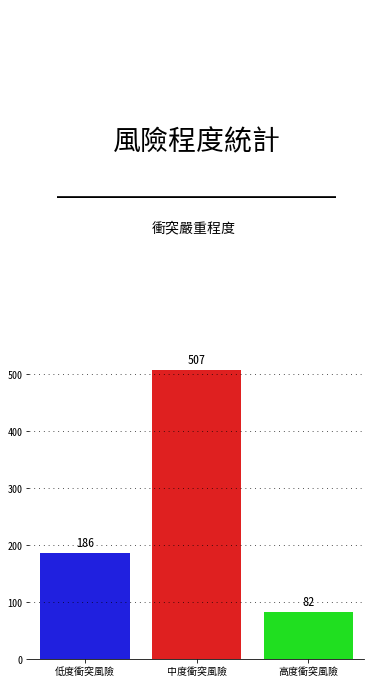

In [69]:
fig = plt.figure(figsize=(6,12))
gs = fig.add_gridspec(2,1)
gs.update(wspace=0.3, hspace=0.15)
ax0 = fig.add_subplot(gs[0,0])
ax1 = fig.add_subplot(gs[1,0])

background_color = "#FFFFFF"
color_palette = ["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"]
fig.patch.set_facecolor(background_color) 
ax0.set_facecolor(background_color) 
ax1.set_facecolor(background_color) 


ax0.text(0.5,0.5,
         '風險程度統計\n',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=28, fontweight='bold',
         fontfamily='Noto Sans Mono CJK TC',
         color="#000000")
ax0.text(0.5,0.4,
         '_______________________________',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=18, fontweight='bold',
         fontfamily='serif',
         color="#000000")

ax0.set_xticklabels([])
ax0.set_yticklabels([])
ax0.tick_params(left=False, bottom=False)


ax1.text(0.6,750,"衝突嚴重程度",fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax1.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax1, data=pd.DataFrame(y), x = '衝突嚴重程度',palette = color_palette)
ax1.set_xlabel("")
ax1.set_ylabel("")
ax1.set_xticklabels(["低度衝突風險","中度衝突風險","高度衝突風險"])

# 在每個條形上方顯示計數
for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), 
                 (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', 
                 xytext = (0, 10), 
                 textcoords = 'offset points',
                 fontsize=12,
                 fontweight='bold')

ax0.spines["top"].set_visible(False)
ax0.spines["left"].set_visible(False)
ax0.spines["bottom"].set_visible(False)
ax0.spines["right"].set_visible(False)
ax1.spines["top"].set_visible(False)
ax1.spines["left"].set_visible(False)
ax1.spines["right"].set_visible(False)

plt.show()


# 原始17個變數

In [70]:
new_feature = ['是否機車可右轉行駛車道數為一','機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線是否位於主要幹道','行穿線後方是否為標線分隔',
              '行人是否有早開或早關時相','機車停等區右側至路緣緣石的寬度',
              '待轉格寬度','機車從前面或後面穿越',
              '是否兩人以上同行','衝突點離待轉格幾何中心距離','衝突點離機車可右轉行駛車道停止線中心點距離',
               '行穿線總長度','衝突點離中央分隔頂點距離','行穿線至待轉格的直線距離',
               '衝突點至行穿線退縮距離臨向右側路口路緣的長度','行穿線總寬度','待轉格深度'
              ]

backup_X = X[new_feature].copy()
X = X[new_feature]
len(new_feature)

17

### 自變數四分位數

In [71]:
X.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
是否機車可右轉行駛車道數為一,775.0,1.574194,0.494784,1.0,1.0,2.0,2.0,2.0
機車可右轉行駛車道旁是否有汽車或機車停車格,775.0,0.790968,0.406880,0.0,1.0,1.0,1.0,1.0
行穿線是否位於主要幹道,775.0,0.416774,0.493343,0.0,0.0,0.0,1.0,1.0
行穿線後方是否為標線分隔,775.0,0.517419,0.500019,0.0,0.0,1.0,1.0,1.0
行人是否有早開或早關時相,775.0,0.104516,0.306126,0.0,0.0,0.0,0.0,1.0
機車停等區右側至路緣緣石的寬度,775.0,1.499484,0.510307,0.0,1.2,1.5,2.1,2.1
待轉格寬度,775.0,4.318839,1.054831,3.1,3.1,4.2,5.2,5.9
機車從前面或後面穿越,775.0,0.532903,0.499238,0.0,0.0,1.0,1.0,1.0
是否兩人以上同行,775.0,0.243871,0.429693,0.0,0.0,0.0,0.0,1.0
衝突點離待轉格幾何中心距離,775.0,7.071742,4.182221,2.0,3.8,6.0,9.7,24.0


### 資料分類

In [72]:
cat_cols = ['機車從前面或後面穿越','是否機車可右轉行駛車道數為一',
            '是否兩人以上同行','行人是否有早開或早關時相','機車可右轉行駛車道旁是否有汽車或機車停車格',
           '行穿線是否位於主要幹道','行穿線後方是否為標線分隔']#'是否有超速科技執法','是否有汽車指引線','右轉機車駛入交叉口之車道數是否為一',
con_cols = ['機車停等區右側至路緣緣石的寬度','待轉格深度','待轉格寬度','行穿線至待轉格的直線距離',
            '行穿線總長度','行穿線總寬度','衝突點至行穿線退縮距離臨向右側路口路緣的長度',
            '衝突點離中央分隔頂點距離','衝突點離待轉格幾何中心距離','衝突點離機車可右轉行駛車道停止線中心點距離']
target_col = ["衝突嚴重程度"]
print("The categorial cols are : ", cat_cols)
print(len(cat_cols),"個")
print("\nThe continuous cols are : ", con_cols)
print(len(con_cols),"個")
print("\nThe target variable is :  ", target_col)


The categorial cols are :  ['機車從前面或後面穿越', '是否機車可右轉行駛車道數為一', '是否兩人以上同行', '行人是否有早開或早關時相', '機車可右轉行駛車道旁是否有汽車或機車停車格', '行穿線是否位於主要幹道', '行穿線後方是否為標線分隔']
7 個

The continuous cols are :  ['機車停等區右側至路緣緣石的寬度', '待轉格深度', '待轉格寬度', '行穿線至待轉格的直線距離', '行穿線總長度', '行穿線總寬度', '衝突點至行穿線退縮距離臨向右側路口路緣的長度', '衝突點離中央分隔頂點距離', '衝突點離待轉格幾何中心距離', '衝突點離機車可右轉行駛車道停止線中心點距離']
10 個

The target variable is :   ['衝突嚴重程度']


### 原始組合變數與風險程度統計(類別型)

In [73]:
merged_data_cat_cols = pd.concat([X[cat_cols], y], axis=1)

In [74]:
import pandas as pd

result_data = []

for column in X[cat_cols].columns:
    variable_values = merged_data_cat_cols[column].unique()
    
    value_counts = merged_data_cat_cols[column].value_counts().to_dict()
    
    # 計算每個值對應到應變數的比例
    value_proportions = {}
    for value, count in value_counts.items():
        proportions = merged_data_cat_cols[merged_data_cat_cols[column] == value]['衝突嚴重程度'].value_counts(normalize=True).to_dict()
        value_proportions[value] = proportions
        
#         proportions_data = {'低衝突風險(%)': round(proportions.get(0, 0) * 100, 2),
#                             '中衝突風險(%)': round(proportions.get(1, 0) * 100, 2),
#                             '高衝突風險(%)': round(proportions.get(2, 0) * 100, 2)}
    
    # 將這些資訊添加到列表中
    for value, count in value_counts.items():
        proportions = value_proportions.get(value, {})
        result_data.append({'變數': column, 
                            '變數描述': value,  
                            '衝突風險程度件數': count,
                            **proportions})

result_df = pd.DataFrame(result_data)

result_df.rename(columns={0: '低衝突風險',1: '中衝突風險',2: '高衝突風險'}, inplace=True)

result_df.insert(3, '低衝突風險', result_df.pop('低衝突風險'))

result_df

,變數,變數描述,衝突風險程度件數,低衝突風險,中衝突風險,高衝突風險
0,機車從前面或後面穿越,1,413,0.213075,0.719128,0.067797
1,機車從前面或後面穿越,0,362,0.270718,0.580110,0.149171
2,是否機車可右轉行駛車道數為一,2,445,0.177528,0.773034,0.049438
3,是否機車可右轉行駛車道數為一,1,330,0.324242,0.493939,0.181818
4,是否兩人以上同行,0,586,0.259386,0.656997,0.083618
5,是否兩人以上同行,1,189,0.179894,0.645503,0.174603
6,行人是否有早開或早關時相,0,694,0.253602,0.657061,0.089337
7,行人是否有早開或早關時相,1,81,0.123457,0.629630,0.246914
8,機車可右轉行駛車道旁是否有汽車或機車停車格,1,613,0.192496,0.698206,0.109299
9,機車可右轉行駛車道旁是否有汽車或機車停車格,0,162,0.419753,0.487654,0.092593


### 類別型自變數統計

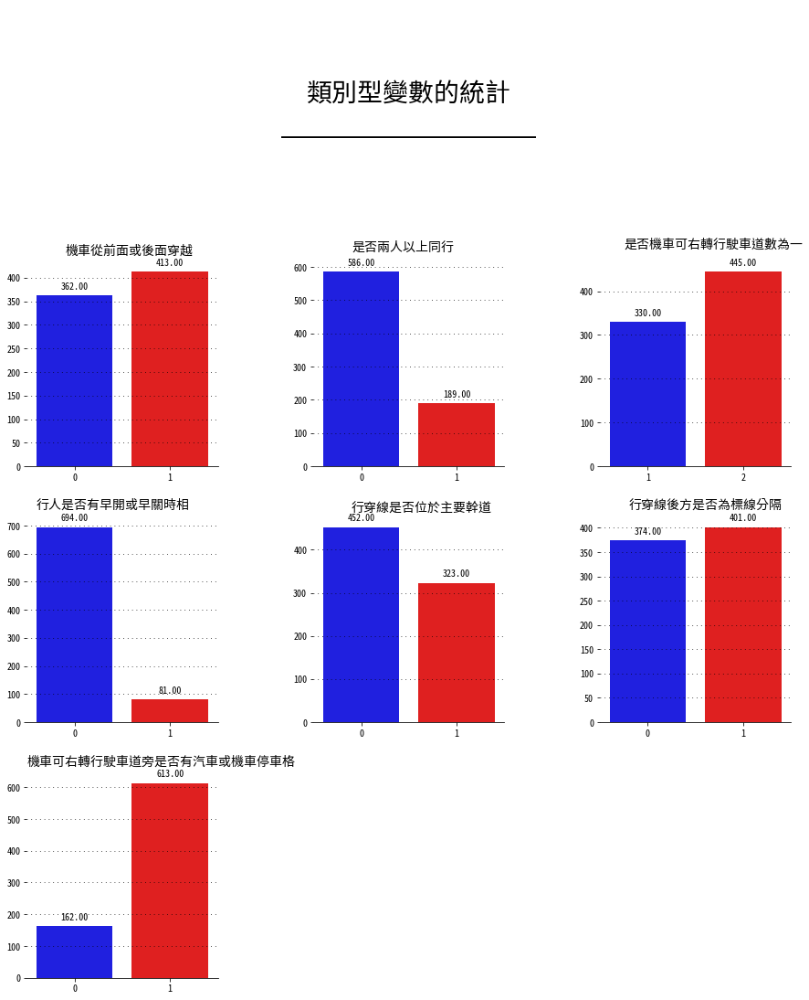

In [75]:
import warnings
warnings.filterwarnings("ignore")

fig = plt.figure(figsize=(15,35))
gs = fig.add_gridspec(7,3)
gs.update(wspace=0.5, hspace=0.25)
ax0 = fig.add_subplot(gs[0,0])
ax1 = fig.add_subplot(gs[0,1])
ax2 = fig.add_subplot(gs[0,2])
ax3 = fig.add_subplot(gs[1,0])
ax4 = fig.add_subplot(gs[1,1])
ax5 = fig.add_subplot(gs[1,2])
ax6 = fig.add_subplot(gs[2,0])
ax7 = fig.add_subplot(gs[2,1])
ax8 = fig.add_subplot(gs[2,2])
ax9 = fig.add_subplot(gs[3,0])


background_color = "#FFFFFF"
color_palette = ["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"]
fig.patch.set_facecolor(background_color) 
ax0.set_facecolor(background_color) 
ax1.set_facecolor(background_color) 
ax2.set_facecolor(background_color) 
ax3.set_facecolor(background_color) 
ax4.set_facecolor(background_color) 
ax5.set_facecolor(background_color) 
ax6.set_facecolor(background_color) 
ax7.set_facecolor(background_color) 
ax8.set_facecolor(background_color) 
ax9.set_facecolor(background_color) 


ax0.spines["bottom"].set_visible(False)
ax0.spines["left"].set_visible(False)
ax0.spines["top"].set_visible(False)
ax0.spines["right"].set_visible(False)
ax0.tick_params(left=False, bottom=False)
ax0.set_xticklabels([])
ax0.set_yticklabels([])

ax1.spines["bottom"].set_visible(False)
ax1.spines["left"].set_visible(False)
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax1.tick_params(left=False, bottom=False)
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.text(0.5,0.5,
         '類別型變數的統計\n',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=28, fontweight='bold',
         fontfamily='Noto Sans Mono CJK TC',
         color="#000000")
ax1.text(0.5,0.4,
         '_______________________________',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=18, fontweight='bold',
         fontfamily='serif',
         color="#000000")

ax2.spines["bottom"].set_visible(False)
ax2.spines["left"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax2.spines["right"].set_visible(False)
ax2.tick_params(left=False, bottom=False)
ax2.set_xticklabels([])
ax2.set_yticklabels([])

ax3.text(-0.1, 450, '機車從前面或後面穿越', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax3.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax3,data=X,x='機車從前面或後面穿越',palette=color_palette)
ax3.set_xlabel("")
ax3.set_ylabel("")
for p in ax3.patches:
    ax3.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax4.text(-0.1, 650, '是否兩人以上同行', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax4.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax4,data=X,x='是否兩人以上同行',palette=color_palette)
ax4.set_xlabel("")
ax4.set_ylabel("")
for p in ax4.patches:
    ax4.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax5.text(-0.25, 500, '是否機車可右轉行駛車道數為一', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax5.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax5,data=X,x='是否機車可右轉行駛車道數為一',palette=color_palette)
ax5.set_xlabel("")
ax5.set_ylabel("")
for p in ax5.patches:
    ax5.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax6.text(-0.4, 760, '行人是否有早開或早關時相', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax6.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax6,data=X,x='行人是否有早開或早關時相',palette=color_palette)
ax6.set_xlabel("")
ax6.set_ylabel("")
for p in ax6.patches:
    ax6.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax7.text(-0.1, 490, '行穿線是否位於主要幹道', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax7.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax7,data=X,x='行穿線是否位於主要幹道',palette=color_palette)
ax7.set_xlabel("")
ax7.set_ylabel("")
for p in ax7.patches:
    ax7.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax8.text(-0.2, 440, '行穿線後方是否為標線分隔', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax8.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax8,data=X,x='行穿線後方是否為標線分隔',palette=color_palette)
ax8.set_xlabel("")
ax8.set_ylabel("")
for p in ax8.patches:
    ax8.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax9.text(-0.5, 670, '機車可右轉行駛車道旁是否有汽車或機車停車格', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax9.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax9,data=X,x='機車可右轉行駛車道旁是否有汽車或機車停車格',palette=color_palette)
ax9.set_xlabel("")
ax9.set_ylabel("")
for p in ax9.patches:
    ax9.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')



for s in ["top","right","left"]:
    ax3.spines[s].set_visible(False)
    ax4.spines[s].set_visible(False)
    ax5.spines[s].set_visible(False)
    ax6.spines[s].set_visible(False)
    ax7.spines[s].set_visible(False)
    ax8.spines[s].set_visible(False)
    ax9.spines[s].set_visible(False)

### 數值型自變數統計

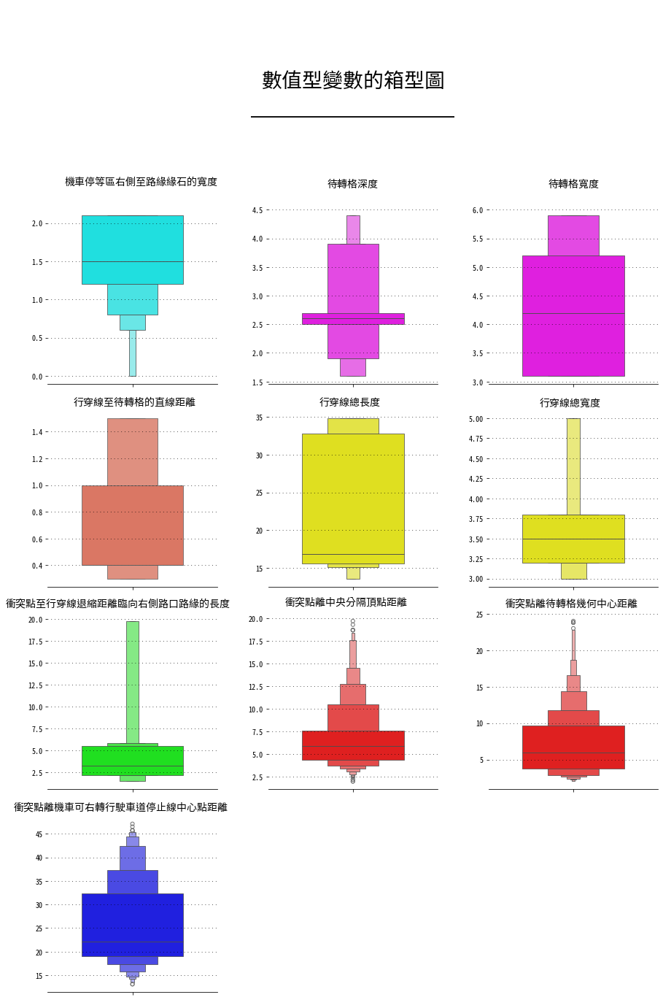

In [76]:
fig = plt.figure(figsize=(15,30))
gs = fig.add_gridspec(6,3)
gs.update(wspace=0.3, hspace=0.15)
ax0 = fig.add_subplot(gs[0,0])
ax1 = fig.add_subplot(gs[0,1])
ax2 = fig.add_subplot(gs[0,2])
ax3 = fig.add_subplot(gs[1,0])
ax4 = fig.add_subplot(gs[1,1])
ax5 = fig.add_subplot(gs[1,2])
ax6 = fig.add_subplot(gs[2,0])
ax7 = fig.add_subplot(gs[2,1])
ax8 = fig.add_subplot(gs[2,2])
ax9 = fig.add_subplot(gs[3,0])
ax10 = fig.add_subplot(gs[3,1])
ax11 = fig.add_subplot(gs[3,2])
ax12 = fig.add_subplot(gs[4,0])


background_color = "#FFFFFF"
fig.patch.set_facecolor(background_color) 
ax0.set_facecolor(background_color) 
ax1.set_facecolor(background_color) 
ax2.set_facecolor(background_color) 
ax3.set_facecolor(background_color) 
ax4.set_facecolor(background_color) 
ax5.set_facecolor(background_color) 
ax6.set_facecolor(background_color) 
ax7.set_facecolor(background_color) 
ax8.set_facecolor(background_color) 
ax9.set_facecolor(background_color) 
ax10.set_facecolor(background_color) 
ax11.set_facecolor(background_color) 
ax12.set_facecolor(background_color) 


ax0.spines["bottom"].set_visible(False)
ax0.spines["left"].set_visible(False)
ax0.spines["top"].set_visible(False)
ax0.spines["right"].set_visible(False)
ax0.tick_params(left=False, bottom=False)
ax0.set_xticklabels([])
ax0.set_yticklabels([])

ax1.spines["bottom"].set_visible(False)
ax1.spines["left"].set_visible(False)
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax1.tick_params(left=False, bottom=False)
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.text(0.5,0.5,
         '數值型變數的箱型圖\n',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=28, fontweight='bold',
         fontfamily='Noto Sans Mono CJK TC',
         color="#000000")
ax1.text(0.5,0.4,
         '_______________________________',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=18, fontweight='bold',
         fontfamily='serif',
         color="#000000")

ax2.spines["bottom"].set_visible(False)
ax2.spines["left"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax2.spines["right"].set_visible(False)
ax2.tick_params(left=False, bottom=False)
ax2.set_xticklabels([])
ax2.set_yticklabels([])

ax3.text(-0.4, 2.5, '機車停等區右側至路緣緣石的寬度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax3.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax3,y=X['機車停等區右側至路緣緣石的寬度'],palette=["#00FFFF"],width=0.6)
ax3.set_xlabel("")
ax3.set_ylabel("")

ax4.text(-0.15, 4.9, '待轉格深度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax4.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax4,y=X['待轉格深度'],palette=["#FF00FF"],width=0.6)
ax4.set_xlabel("")
ax4.set_ylabel("")
 
ax5.text(-0.15, 6.4, '待轉格寬度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax5.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax5,y=X['待轉格寬度'],palette=["#FF00FF"],width=0.6)
ax5.set_xlabel("")
ax5.set_ylabel("")

ax6.text(-0.35, 1.6, '行穿線至待轉格的直線距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax6.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax6,y=X['行穿線至待轉格的直線距離'],palette=["#EE6A50"],width=0.6)
ax6.set_xlabel("")
ax6.set_ylabel("")

ax7.text(-0.2, 36.5, '行穿線總長度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax7.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax7,y=X['行穿線總長度'],palette=["#FFFF00"],width=0.6)
ax7.set_xlabel("")
ax7.set_ylabel("")

ax8.text(-0.2, 5.15, '行穿線總寬度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax8.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax8,y=X['行穿線總寬度'],palette=["#FFFF00"],width=0.6)
ax8.set_xlabel("")
ax8.set_ylabel("")

ax9.text(-0.75, 21.5, '衝突點至行穿線退縮距離臨向右側路口路緣的長度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax9.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax9,y=X['衝突點至行穿線退縮距離臨向右側路口路緣的長度'],palette=["#00FF00"],width=0.6)
ax9.set_xlabel("")
ax9.set_ylabel("")

ax10.text(-0.4, 21.5, '衝突點離中央分隔頂點距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax10.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax10,y=X['衝突點離中央分隔頂點距離'],palette=["#FF0000"],width=0.6)
ax10.set_xlabel("")
ax10.set_ylabel("")

ax11.text(-0.4, 26, '衝突點離待轉格幾何中心距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax11.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax11,y=X['衝突點離待轉格幾何中心距離'],palette=["#FF0000"],width=0.6)
ax11.set_xlabel("")
ax11.set_ylabel("")

ax12.text(-0.7, 50, '衝突點離機車可右轉行駛車道停止線中心點距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax12.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax12,y=X['衝突點離機車可右轉行駛車道停止線中心點距離'],palette=["#0000FF"],width=0.6)
ax12.set_xlabel("")
ax12.set_ylabel("")

for s in ["top","right","left"]:
    ax3.spines[s].set_visible(False)
    ax4.spines[s].set_visible(False)
    ax5.spines[s].set_visible(False)
    ax6.spines[s].set_visible(False)
    ax7.spines[s].set_visible(False)
    ax8.spines[s].set_visible(False)
    ax9.spines[s].set_visible(False)
    ax10.spines[s].set_visible(False)
    ax11.spines[s].set_visible(False)
    ax12.spines[s].set_visible(False)

## 10 fold

### 原始組合SHAP VALUE

  0%|          | 0/77 [00:00<?, ?it/s]

Logistic Regression


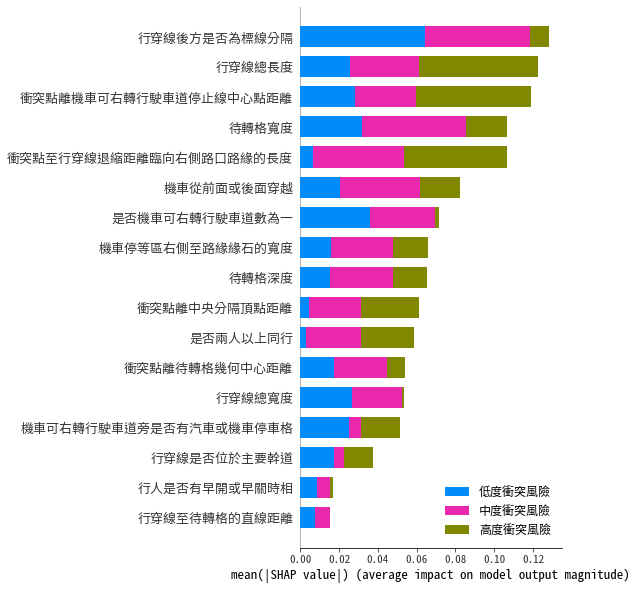

  0%|          | 0/77 [00:00<?, ?it/s]

Support Vector Machine


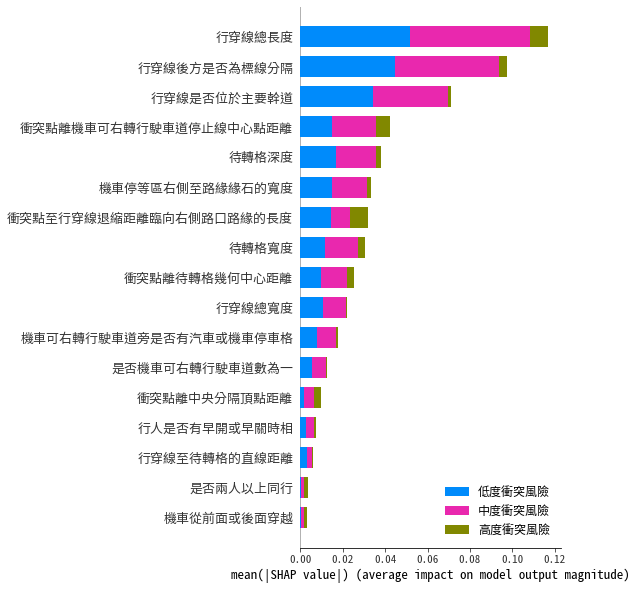

Decision Tree


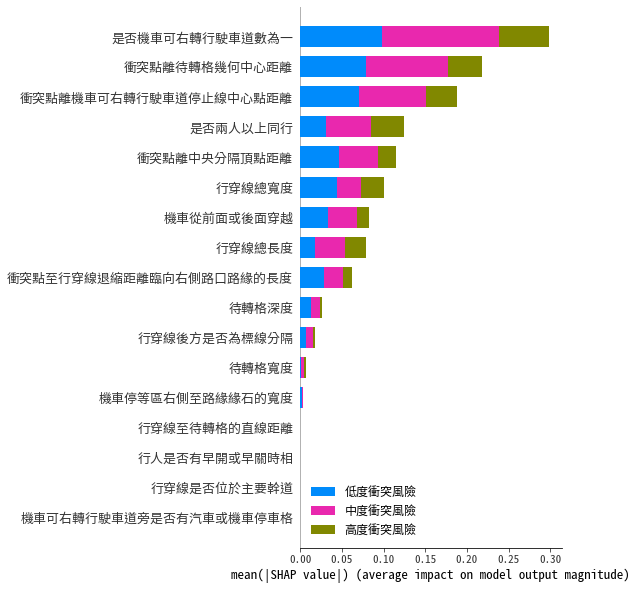

Random Forest


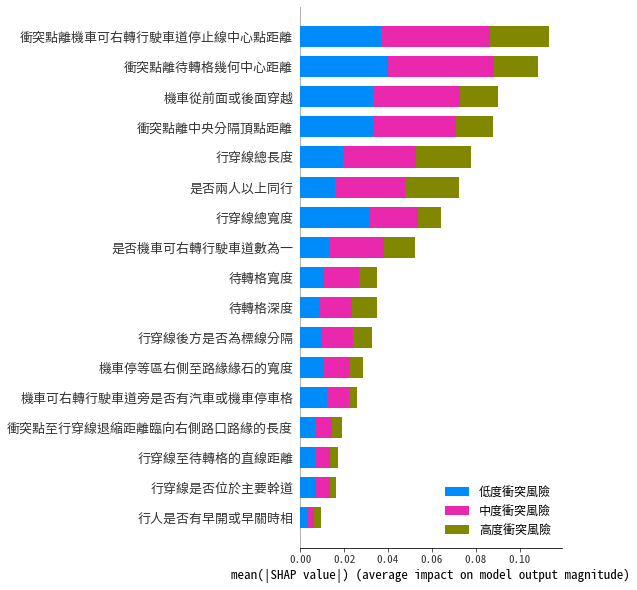

XGBoost


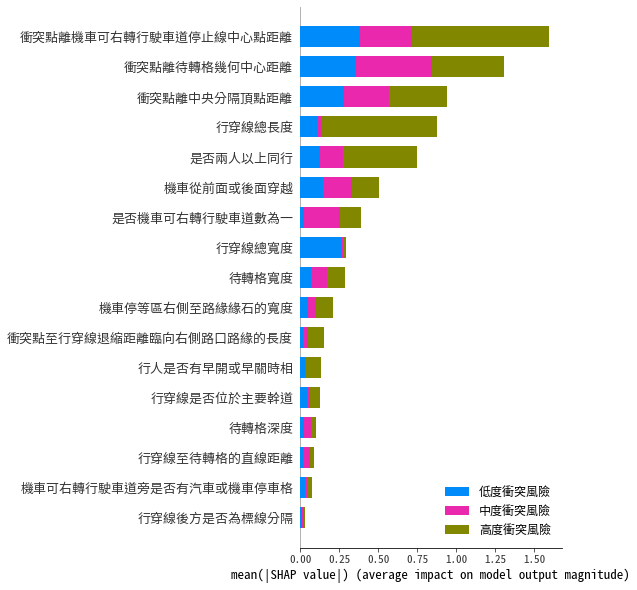


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.664502,0.416214,0.706500,0.683331,0.402090,0.675413,0.420671,0.739095,0.565806,0.420856
1,Support Vector Machine,0.654212,0.263369,0.667025,0.884737,0.333333,0.654194,0.263647,0.722956,0.884731,0.333333
2,Decision Tree,0.642641,0.519031,0.668442,0.534912,0.487186,0.837992,0.750307,0.959587,0.820165,0.733555
3,Random Forest,0.664552,0.512457,0.719098,0.560192,0.512199,0.837992,0.758650,0.955544,0.787802,0.739366
4,XGBoost,0.656810,0.498832,0.717138,0.550892,0.502119,0.837849,0.758049,0.958339,0.792647,0.735419


In [77]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix
from sklearn.metrics import classification_report
import warnings
from sklearn.exceptions import ConvergenceWarning
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

# 建立模型
models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

# 切分資料集
def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)

results = []
step_results = []

for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    
    for train_index, test_index in split_data(X, y):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        #new metrics
        train_report = classification_report(y_train, train_y_pred)
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro', zero_division=1)
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        test_report = classification_report(y_test, y_pred)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)
    

    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    


results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [78]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.666667,0.378248,0.706131,0.745572,0.396667,0.682927,0.428707,0.736653,0.538286,0.430121
1,Logistic Regression,0.730769,0.435078,0.717353,0.752381,0.458090,0.672884,0.431846,0.739756,0.541639,0.431448
2,Logistic Regression,0.589744,0.342087,0.684407,0.700980,0.380051,0.687231,0.419533,0.742780,0.744872,0.423568
3,Logistic Regression,0.653846,0.372906,0.711015,0.727273,0.386957,0.675753,0.419126,0.738360,0.574537,0.421439
4,Logistic Regression,0.692308,0.450607,0.687747,0.572222,0.451887,0.662841,0.441674,0.737273,0.524149,0.434938
5,Logistic Regression,0.662338,0.385870,0.686337,0.721554,0.399381,0.669054,0.409075,0.742390,0.557313,0.409359
6,Logistic Regression,0.649351,0.349862,0.768319,0.700000,0.373856,0.663324,0.387754,0.730806,0.495705,0.394201
7,Logistic Regression,0.623377,0.666667,0.706002,0.348881,0.355556,0.686246,0.444141,0.738595,0.599849,0.433883
8,Logistic Regression,0.714286,0.405983,0.717468,0.737374,0.419753,0.684814,0.408113,0.739970,0.540066,0.417385
9,Logistic Regression,0.662338,0.374830,0.680223,0.827074,0.398705,0.669054,0.416743,0.744366,0.541647,0.412218


### 原始組合spearman相關係數矩陣(all)

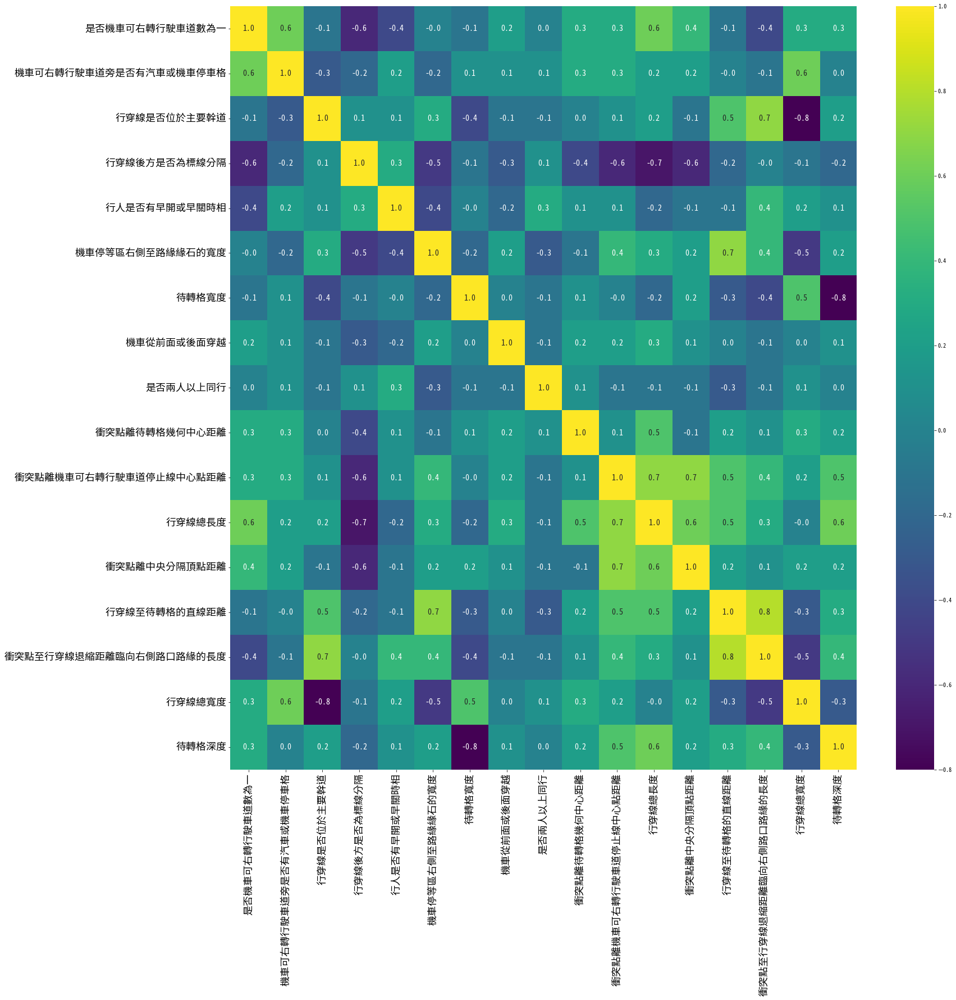

In [79]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X)
correlation_df = pd.DataFrame(correlation_matrix, index=X.columns, columns=X.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

### 原始組合spearman相關係數矩陣(x > 0.7 & x < -0.7)

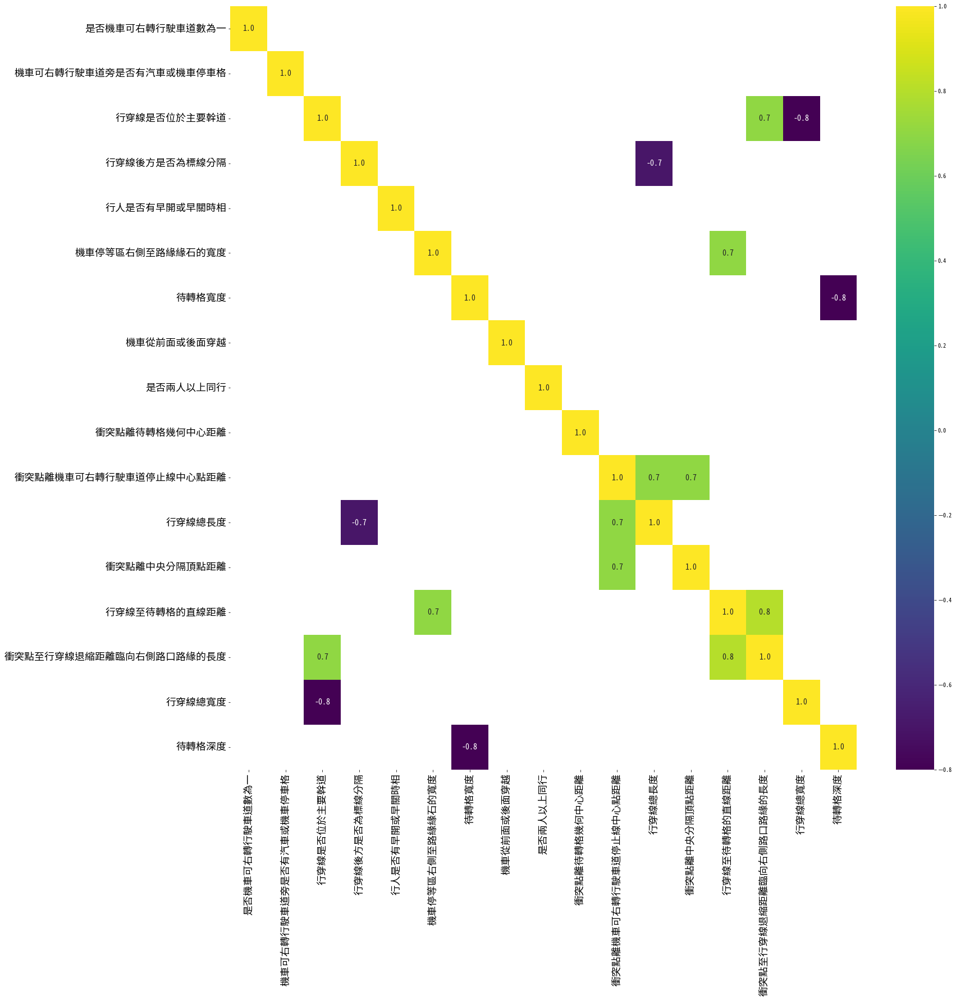

In [80]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X)
correlation_df = pd.DataFrame(correlation_matrix, index=X.columns, columns=X.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

### SHAP下載

In [113]:
# ! pip install shap
# !pip install xgboost


[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python -m pip install --upgrade pip


### SMOTE + 17個變數 + SHAP

In [119]:
# !pip install imbalanced-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 258.0/258.0 kB 1.5 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python -m pip install --upgrade pip


In [21]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# 顯示原始數據的類別分佈
print('Original dataset shape %s' % Counter(y))

# SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

# 顯示經過SMOTE處理後的數據集的類別分佈
print('Resampled dataset shape %s' % Counter(y_res))


Original dataset shape Counter({1: 507, 0: 186, 2: 82})
Resampled dataset shape Counter({2: 507, 1: 507, 0: 507})


### SMOTE + 17個變數自變數四分位數

In [22]:
X_res.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
機車從前面或後面穿越,1521.0,0.384615,0.486664,0.0,0.000000,0.000000,1.000000,1.0
是否兩人以上同行,1521.0,0.201183,0.401017,0.0,0.000000,0.000000,0.000000,1.0
行人性別,1521.0,0.399080,0.489870,0.0,0.000000,0.000000,1.000000,1.0
行人年齡,1521.0,1.939513,0.274384,0.0,2.000000,2.000000,2.000000,2.0
是否機車可右轉行駛車道數為一,1521.0,1.441815,0.496766,1.0,1.000000,1.000000,2.000000,2.0
是否有超速科技執法,1521.0,0.122945,0.328483,0.0,0.000000,0.000000,0.000000,1.0
是否有汽車指引線,1521.0,0.227482,0.419344,0.0,0.000000,0.000000,0.000000,1.0
機車可右轉行駛車道旁是否有汽車或機車停車格,1521.0,0.765286,0.423959,0.0,1.000000,1.000000,1.000000,1.0
行穿線是否位於主要幹道,1521.0,0.368179,0.482469,0.0,0.000000,0.000000,1.000000,1.0
行穿線後方是否為標線分隔,1521.0,0.610782,0.487733,0.0,0.000000,1.000000,1.000000,1.0


### SMOTE後組合變數與風險程度統計(類別型)

In [83]:
merged_data_cat_cols = pd.concat([X_res[cat_cols], y_res], axis=1)

import pandas as pd

result_data = []

for column in X_res[cat_cols].columns:
    variable_values = merged_data_cat_cols[column].unique()
    
    value_counts = merged_data_cat_cols[column].value_counts().to_dict()
    
    value_proportions = {}
    for value, count in value_counts.items():
        proportions = merged_data_cat_cols[merged_data_cat_cols[column] == value]['衝突嚴重程度'].value_counts(normalize=True).to_dict()
        value_proportions[value] = proportions
        
#         proportions_data = {'低衝突風險(%)': round(proportions.get(0, 0) * 100, 2),
#                             '中衝突風險(%)': round(proportions.get(1, 0) * 100, 2),
#                             '高衝突風險(%)': round(proportions.get(2, 0) * 100, 2)}
    
    for value, count in value_counts.items():
        proportions = value_proportions.get(value, {})
        result_data.append({'變數': column, 
                            '變數描述': value,  
                            '衝突風險程度件數': count,
                            **proportions})

result_df = pd.DataFrame(result_data)

result_df.rename(columns={0: '低衝突風險',1: '中衝突風險',2: '高衝突風險'}, inplace=True)
result_df.insert(3, '低衝突風險', result_df.pop('低衝突風險'))

result_df

,變數,變數描述,衝突風險程度件數,低衝突風險,高衝突風險,中衝突風險
0,機車從前面或後面穿越,0,936,0.342949,0.432692,0.224359
1,機車從前面或後面穿越,1,585,0.317949,0.174359,0.507692
2,是否機車可右轉行駛車道數為一,1,863,0.333720,0.477404,0.188876
3,是否機車可右轉行駛車道數為一,2,658,0.332827,0.144377,0.522796
4,是否兩人以上同行,0,1228,0.369707,0.316775,0.313518
5,是否兩人以上同行,1,293,0.180887,0.402730,0.416382
6,行人是否有早開或早關時相,0,1351,0.364175,0.298298,0.337528
7,行人是否有早開或早關時相,1,170,0.088235,0.611765,0.300000
8,機車可右轉行駛車道旁是否有汽車或機車停車格,1,1150,0.286957,0.340870,0.372174
9,機車可右轉行駛車道旁是否有汽車或機車停車格,0,371,0.477089,0.309973,0.212938


### SMOTE後應變數比例圖

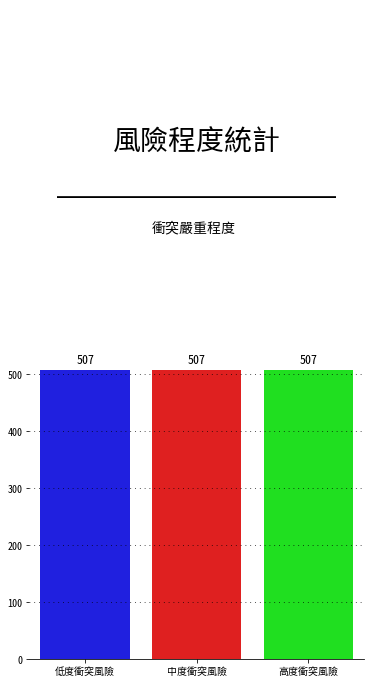

In [84]:
fig = plt.figure(figsize=(6,12))
gs = fig.add_gridspec(2,1)
gs.update(wspace=0.3, hspace=0.15)
ax0 = fig.add_subplot(gs[0,0])
ax1 = fig.add_subplot(gs[1,0])

background_color = "#FFFFFF"
color_palette = ["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"]
fig.patch.set_facecolor(background_color) 
ax0.set_facecolor(background_color) 
ax1.set_facecolor(background_color) 

ax0.text(0.5,0.5,
         '風險程度統計\n',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=28, fontweight='bold',
         fontfamily='Noto Sans Mono CJK TC',
         color="#000000")
ax0.text(0.5,0.4,
         '_______________________________',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=18, fontweight='bold',
         fontfamily='serif',
         color="#000000")

ax0.set_xticklabels([])
ax0.set_yticklabels([])
ax0.tick_params(left=False, bottom=False)

ax1.text(0.6,750,"衝突嚴重程度",fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax1.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax1, data=pd.DataFrame(y_res), x = '衝突嚴重程度',palette = color_palette)
ax1.set_xlabel("")
ax1.set_ylabel("")
ax1.set_xticklabels(["低度衝突風險","中度衝突風險","高度衝突風險"])

for p in ax1.patches:
    ax1.annotate(format(p.get_height(), '.0f'), 
                 (p.get_x() + p.get_width() / 2., p.get_height()), 
                 ha = 'center', va = 'center', 
                 xytext = (0, 10), 
                 textcoords = 'offset points',
                 fontsize=12,
                 fontweight='bold')

ax0.spines["top"].set_visible(False)
ax0.spines["left"].set_visible(False)
ax0.spines["bottom"].set_visible(False)
ax0.spines["right"].set_visible(False)
ax1.spines["top"].set_visible(False)
ax1.spines["left"].set_visible(False)
ax1.spines["right"].set_visible(False)

plt.show()


### SMOTE後類別型自變數統計

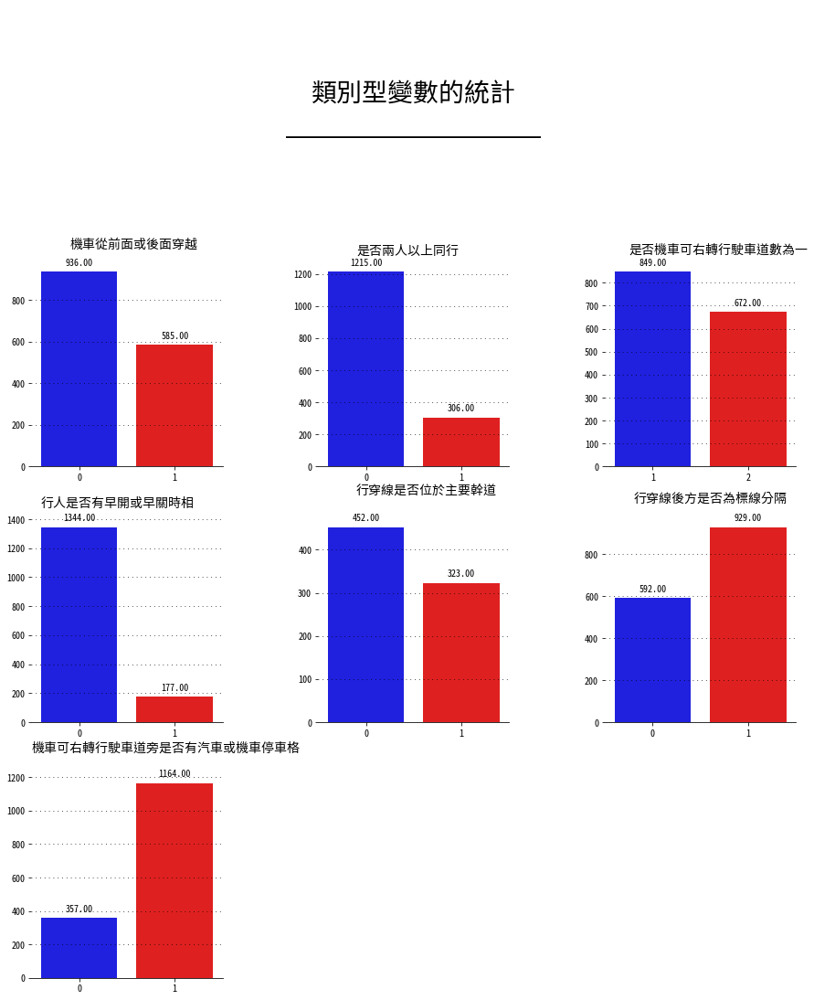

In [36]:
import warnings
warnings.filterwarnings("ignore")

fig = plt.figure(figsize=(15,35))
gs = fig.add_gridspec(7,3)
gs.update(wspace=0.5, hspace=0.25)
ax0 = fig.add_subplot(gs[0,0])
ax1 = fig.add_subplot(gs[0,1])
ax2 = fig.add_subplot(gs[0,2])
ax3 = fig.add_subplot(gs[1,0])
ax4 = fig.add_subplot(gs[1,1])
ax5 = fig.add_subplot(gs[1,2])
ax6 = fig.add_subplot(gs[2,0])
ax7 = fig.add_subplot(gs[2,1])
ax8 = fig.add_subplot(gs[2,2])
ax9 = fig.add_subplot(gs[3,0])


background_color = "#FFFFFF"
color_palette = ["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"]
fig.patch.set_facecolor(background_color) 
ax0.set_facecolor(background_color) 
ax1.set_facecolor(background_color) 
ax2.set_facecolor(background_color) 
ax3.set_facecolor(background_color) 
ax4.set_facecolor(background_color) 
ax5.set_facecolor(background_color) 
ax6.set_facecolor(background_color) 
ax7.set_facecolor(background_color) 
ax8.set_facecolor(background_color) 
ax9.set_facecolor(background_color) 


ax0.spines["bottom"].set_visible(False)
ax0.spines["left"].set_visible(False)
ax0.spines["top"].set_visible(False)
ax0.spines["right"].set_visible(False)
ax0.tick_params(left=False, bottom=False)
ax0.set_xticklabels([])
ax0.set_yticklabels([])

ax1.spines["bottom"].set_visible(False)
ax1.spines["left"].set_visible(False)
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax1.tick_params(left=False, bottom=False)
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.text(0.5,0.5,
         '類別型變數的統計\n',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=28, fontweight='bold',
         fontfamily='Noto Sans Mono CJK TC',
         color="#000000")
ax1.text(0.5,0.4,
         '_______________________________',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=18, fontweight='bold',
         fontfamily='serif',
         color="#000000")

ax2.spines["bottom"].set_visible(False)
ax2.spines["left"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax2.spines["right"].set_visible(False)
ax2.tick_params(left=False, bottom=False)
ax2.set_xticklabels([])
ax2.set_yticklabels([])

ax3.text(-0.1, 1050, '機車從前面或後面穿越', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax3.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax3,data=X_res,x='機車從前面或後面穿越',palette=color_palette)
ax3.set_xlabel("")
ax3.set_ylabel("")
for p in ax3.patches:
    ax3.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax4.text(-0.1, 1325, '是否兩人以上同行', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax4.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax4,data=X_res,x='是否兩人以上同行',palette=color_palette)
ax4.set_xlabel("")
ax4.set_ylabel("")
for p in ax4.patches:
    ax4.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')

ax5.text(-0.25, 930, '是否機車可右轉行駛車道數為一', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax5.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax5,data=X_res,x='是否機車可右轉行駛車道數為一',palette=color_palette)
ax5.set_xlabel("")
ax5.set_ylabel("")
for p in ax5.patches:
    ax5.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')


ax6.text(-0.4, 1490, '行人是否有早開或早關時相', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax6.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax6,data=X_res,x='行人是否有早開或早關時相',palette=color_palette)
ax6.set_xlabel("")
ax6.set_ylabel("")
for p in ax6.patches:
    ax6.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')


ax7.text(-0.1, 530, '行穿線是否位於主要幹道', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax7.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax7,data=X,x='行穿線是否位於主要幹道',palette=color_palette)
ax7.set_xlabel("")
ax7.set_ylabel("")
for p in ax7.patches:
    ax7.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')


ax8.text(-0.2, 1050, '行穿線後方是否為標線分隔', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax8.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax8,data=X_res,x='行穿線後方是否為標線分隔',palette=color_palette)
ax8.set_xlabel("")
ax8.set_ylabel("")
for p in ax8.patches:
    ax8.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')


ax9.text(-0.5, 1350, '機車可右轉行駛車道旁是否有汽車或機車停車格', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax9.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.countplot(ax=ax9,data=X_res,x='機車可右轉行駛車道旁是否有汽車或機車停車格',palette=color_palette)
ax9.set_xlabel("")
ax9.set_ylabel("")
for p in ax9.patches:
    ax9.annotate(format(p.get_height(), '.2f'), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha = 'center', va = 'center', 
                   xytext = (0, 10), 
                   textcoords = 'offset points')



for s in ["top","right","left"]:
    ax3.spines[s].set_visible(False)
    ax4.spines[s].set_visible(False)
    ax5.spines[s].set_visible(False)
    ax6.spines[s].set_visible(False)
    ax7.spines[s].set_visible(False)
    ax8.spines[s].set_visible(False)
    ax9.spines[s].set_visible(False)

### SMOTE後數值型自變數統計

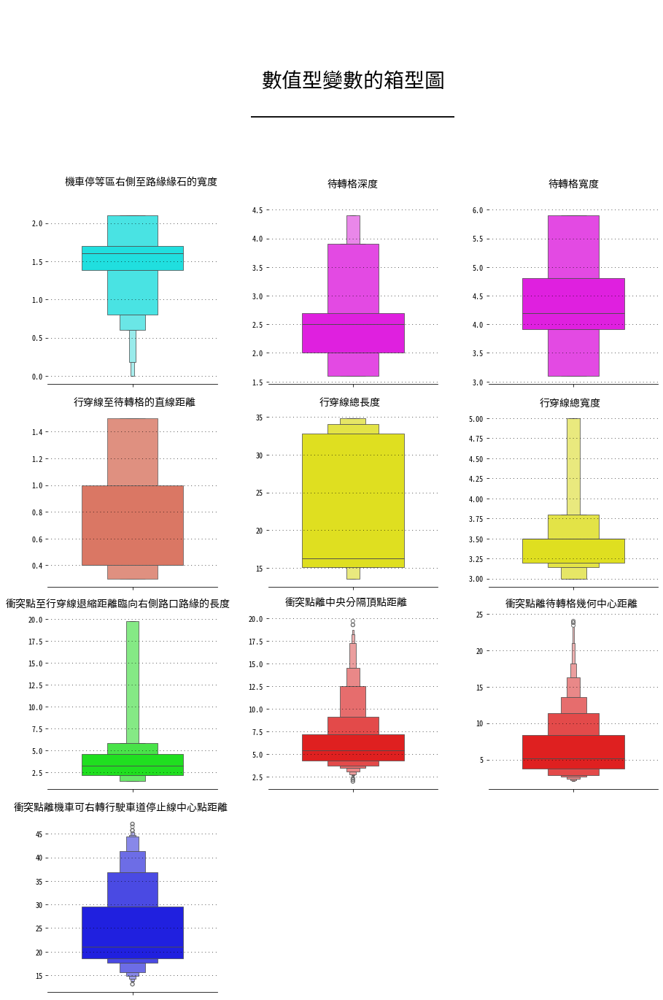

In [24]:
fig = plt.figure(figsize=(15,30))
gs = fig.add_gridspec(6,3)
gs.update(wspace=0.3, hspace=0.15)
ax0 = fig.add_subplot(gs[0,0])
ax1 = fig.add_subplot(gs[0,1])
ax2 = fig.add_subplot(gs[0,2])
ax3 = fig.add_subplot(gs[1,0])
ax4 = fig.add_subplot(gs[1,1])
ax5 = fig.add_subplot(gs[1,2])
ax6 = fig.add_subplot(gs[2,0])
ax7 = fig.add_subplot(gs[2,1])
ax8 = fig.add_subplot(gs[2,2])
ax9 = fig.add_subplot(gs[3,0])
ax10 = fig.add_subplot(gs[3,1])
ax11 = fig.add_subplot(gs[3,2])
ax12 = fig.add_subplot(gs[4,0])


background_color = "#FFFFFF"
fig.patch.set_facecolor(background_color) 
ax0.set_facecolor(background_color) 
ax1.set_facecolor(background_color) 
ax2.set_facecolor(background_color) 
ax3.set_facecolor(background_color) 
ax4.set_facecolor(background_color) 
ax5.set_facecolor(background_color) 
ax6.set_facecolor(background_color) 
ax7.set_facecolor(background_color) 
ax8.set_facecolor(background_color) 
ax9.set_facecolor(background_color) 
ax10.set_facecolor(background_color) 
ax11.set_facecolor(background_color) 
ax12.set_facecolor(background_color) 


ax0.spines["bottom"].set_visible(False)
ax0.spines["left"].set_visible(False)
ax0.spines["top"].set_visible(False)
ax0.spines["right"].set_visible(False)
ax0.tick_params(left=False, bottom=False)
ax0.set_xticklabels([])
ax0.set_yticklabels([])

ax1.spines["bottom"].set_visible(False)
ax1.spines["left"].set_visible(False)
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax1.tick_params(left=False, bottom=False)
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.text(0.5,0.5,
         '數值型變數的箱型圖\n',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=28, fontweight='bold',
         fontfamily='Noto Sans Mono CJK TC',
         color="#000000")
ax1.text(0.5,0.4,
         '_______________________________',
         horizontalalignment='center',
         verticalalignment='center',
         fontsize=18, fontweight='bold',
         fontfamily='serif',
         color="#000000")

ax2.spines["bottom"].set_visible(False)
ax2.spines["left"].set_visible(False)
ax2.spines["top"].set_visible(False)
ax2.spines["right"].set_visible(False)
ax2.tick_params(left=False, bottom=False)
ax2.set_xticklabels([])
ax2.set_yticklabels([])

ax3.text(-0.4, 2.5, '機車停等區右側至路緣緣石的寬度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax3.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax3,y=X_res['機車停等區右側至路緣緣石的寬度'],palette=["#00FFFF"],width=0.6)
ax3.set_xlabel("")
ax3.set_ylabel("")


ax4.text(-0.15, 4.9, '待轉格深度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax4.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax4,y=X_res['待轉格深度'],palette=["#FF00FF"],width=0.6)
ax4.set_xlabel("")
ax4.set_ylabel("")


ax5.text(-0.15, 6.4, '待轉格寬度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax5.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax5,y=X_res['待轉格寬度'],palette=["#FF00FF"],width=0.6)
ax5.set_xlabel("")
ax5.set_ylabel("")


ax6.text(-0.35, 1.6, '行穿線至待轉格的直線距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax6.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax6,y=X['行穿線至待轉格的直線距離'],palette=["#EE6A50"],width=0.6)
ax6.set_xlabel("")
ax6.set_ylabel("")

ax7.text(-0.2, 36.5, '行穿線總長度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax7.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax7,y=X_res['行穿線總長度'],palette=["#FFFF00"],width=0.6)
ax7.set_xlabel("")
ax7.set_ylabel("")

ax8.text(-0.2, 5.15, '行穿線總寬度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax8.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax8,y=X_res['行穿線總寬度'],palette=["#FFFF00"],width=0.6)
ax8.set_xlabel("")
ax8.set_ylabel("")

ax9.text(-0.75, 21.5, '衝突點至行穿線退縮距離臨向右側路口路緣的長度', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax9.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax9,y=X_res['衝突點至行穿線退縮距離臨向右側路口路緣的長度'],palette=["#00FF00"],width=0.6)
ax9.set_xlabel("")
ax9.set_ylabel("")

ax10.text(-0.4, 21.5, '衝突點離中央分隔頂點距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax10.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax10,y=X_res['衝突點離中央分隔頂點距離'],palette=["#FF0000"],width=0.6)
ax10.set_xlabel("")
ax10.set_ylabel("")

ax11.text(-0.4, 26, '衝突點離待轉格幾何中心距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax11.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax11,y=X_res['衝突點離待轉格幾何中心距離'],palette=["#FF0000"],width=0.6)
ax11.set_xlabel("")
ax11.set_ylabel("")

ax12.text(-0.7, 50, '衝突點離機車可右轉行駛車道停止線中心點距離', fontsize=14, fontweight='bold', fontfamily='Noto Sans Mono CJK TC', color="#000000")
ax12.grid(color='#000000', linestyle=':', axis='y', zorder=0,  dashes=(1,5))
sns.boxenplot(ax=ax12,y=X_res['衝突點離機車可右轉行駛車道停止線中心點距離'],palette=["#0000FF"],width=0.6)
ax12.set_xlabel("")
ax12.set_ylabel("")

for s in ["top","right","left"]:
    ax3.spines[s].set_visible(False)
    ax4.spines[s].set_visible(False)
    ax5.spines[s].set_visible(False)
    ax6.spines[s].set_visible(False)
    ax7.spines[s].set_visible(False)
    ax8.spines[s].set_visible(False)
    ax9.spines[s].set_visible(False)
    ax10.spines[s].set_visible(False)
    ax11.spines[s].set_visible(False)
    ax12.spines[s].set_visible(False)

  0%|          | 0/152 [00:00<?, ?it/s]

Logistic Regression


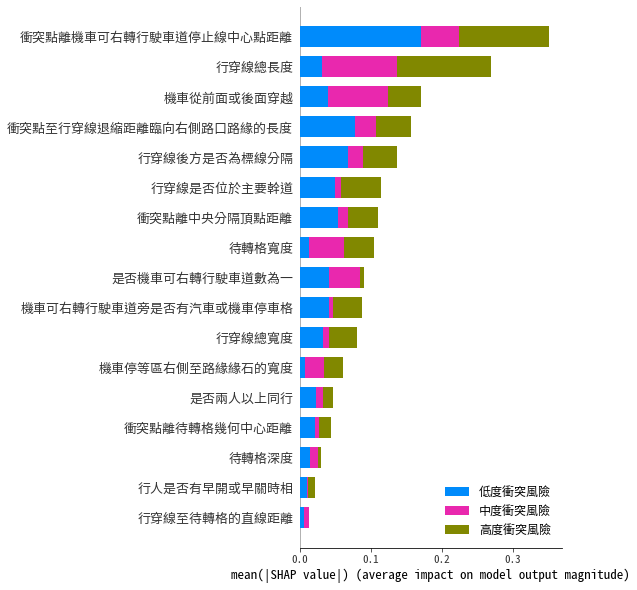

  0%|          | 0/152 [00:00<?, ?it/s]

Support Vector Machine


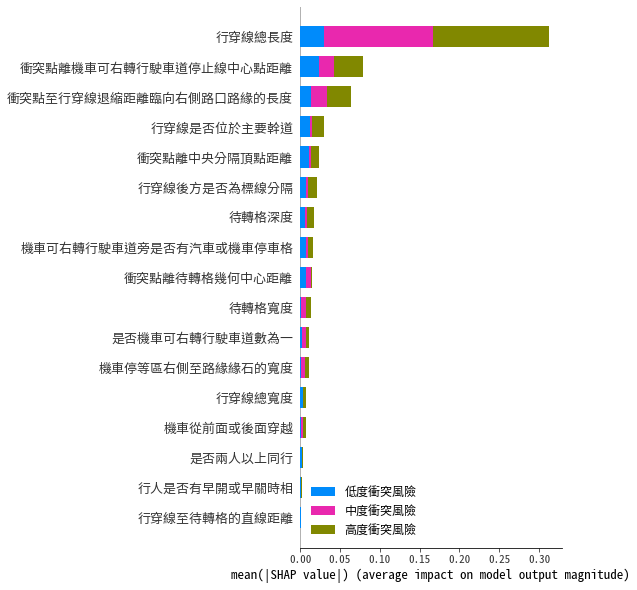

Decision Tree


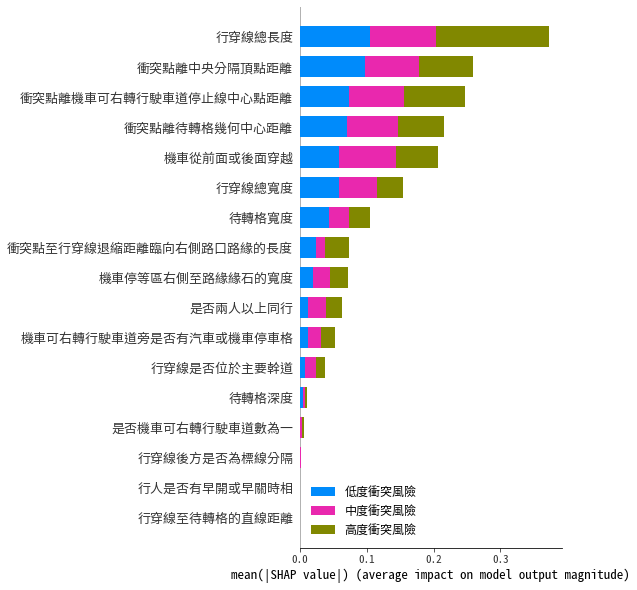

Random Forest


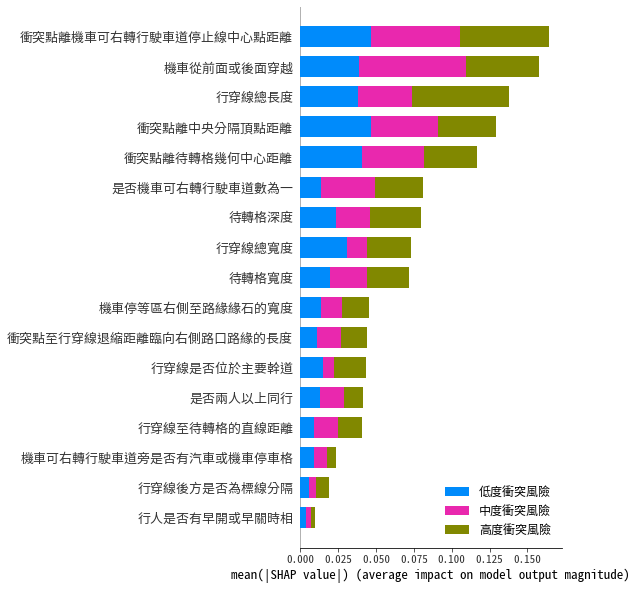

XGBoost


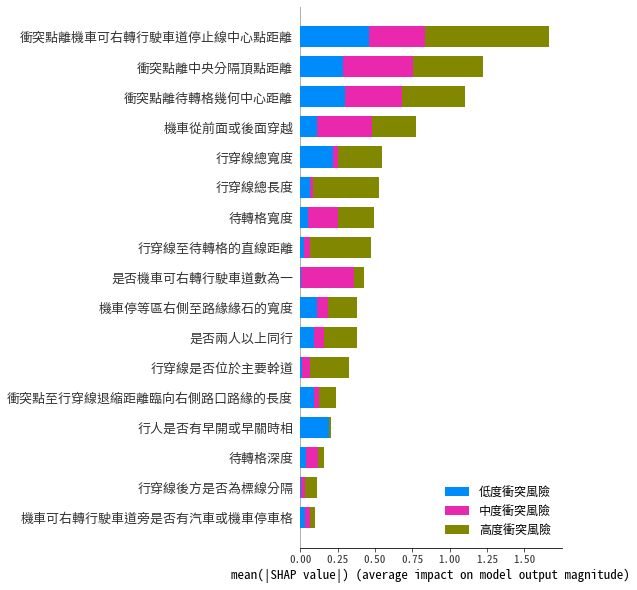


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.590420,0.577031,0.760796,0.588279,0.589309,0.595003,0.586535,0.769441,0.592960,0.594936
1,Support Vector Machine,0.501673,0.427861,0.747030,0.609998,0.503876,0.512529,0.444701,0.756611,0.579155,0.512229
2,Decision Tree,0.732439,0.732256,0.822839,0.735108,0.733702,0.896340,0.896398,0.984292,0.898227,0.896317
3,Random Forest,0.741615,0.740150,0.880929,0.742826,0.741505,0.896340,0.896300,0.978125,0.896593,0.896341
4,XGBoost,0.755435,0.753957,0.890129,0.755986,0.755654,0.895171,0.895124,0.980865,0.895384,0.895184


In [87]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)

results = []
step_results = []

for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res, y_res):
        X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)
    
    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    

results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [88]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.562092,0.559139,0.723609,0.569015,0.577369,0.593567,0.583565,0.770593,0.589906,0.591890
1,Logistic Regression,0.605263,0.580426,0.701008,0.598325,0.602217,0.592403,0.586094,0.772849,0.592560,0.592762
2,Logistic Regression,0.618421,0.597342,0.814457,0.600284,0.603221,0.591673,0.584366,0.764534,0.588567,0.592998
3,Logistic Regression,0.618421,0.601845,0.770757,0.608627,0.617554,0.589481,0.580222,0.771738,0.586584,0.589432
4,Logistic Regression,0.578947,0.575789,0.766110,0.585161,0.580485,0.598977,0.591248,0.769234,0.596079,0.598799
5,Logistic Regression,0.611842,0.589942,0.776265,0.608225,0.608479,0.597516,0.590042,0.764147,0.594982,0.597848
6,Logistic Regression,0.526316,0.524515,0.741718,0.526286,0.532246,0.604091,0.596670,0.773820,0.603690,0.603105
7,Logistic Regression,0.585526,0.584261,0.770067,0.592102,0.596255,0.597516,0.586634,0.771177,0.594309,0.595913
8,Logistic Regression,0.625000,0.591137,0.769328,0.593690,0.590939,0.588751,0.583273,0.770264,0.588214,0.592779
9,Logistic Regression,0.572368,0.565909,0.774644,0.601077,0.584321,0.596056,0.583237,0.766058,0.594714,0.593837


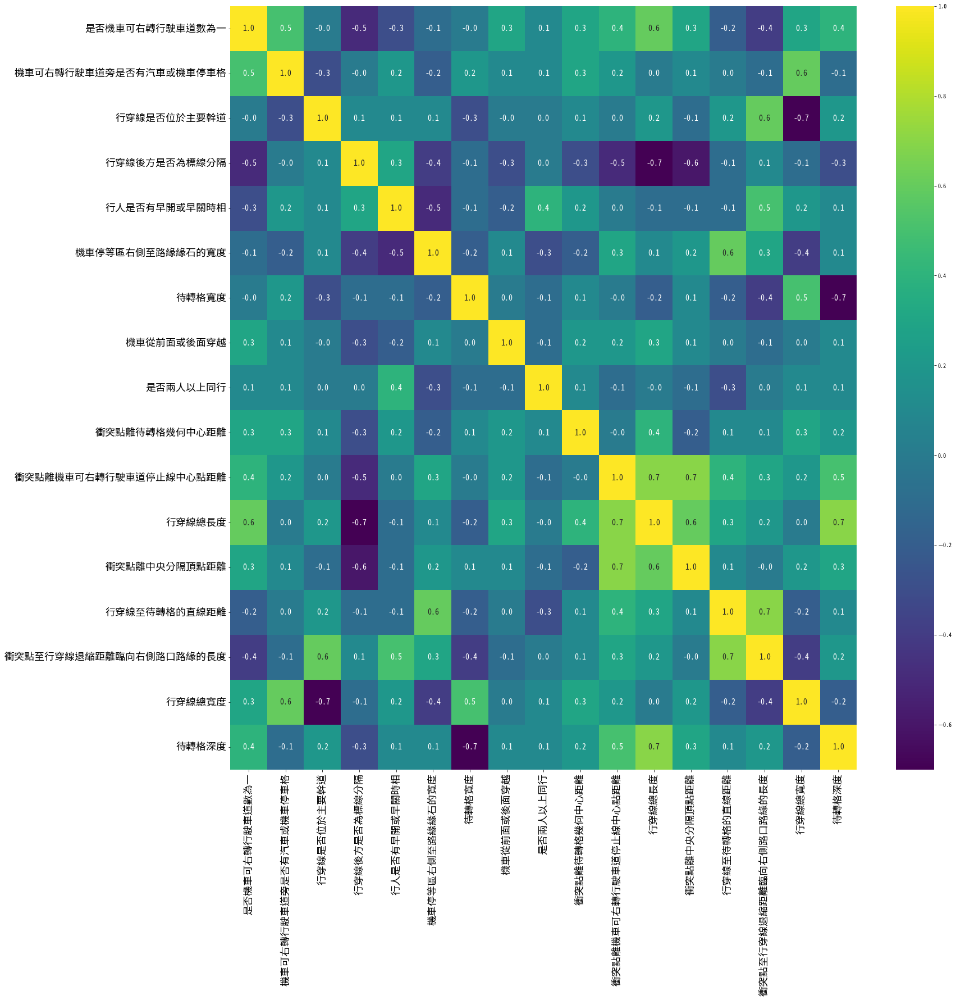

In [89]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

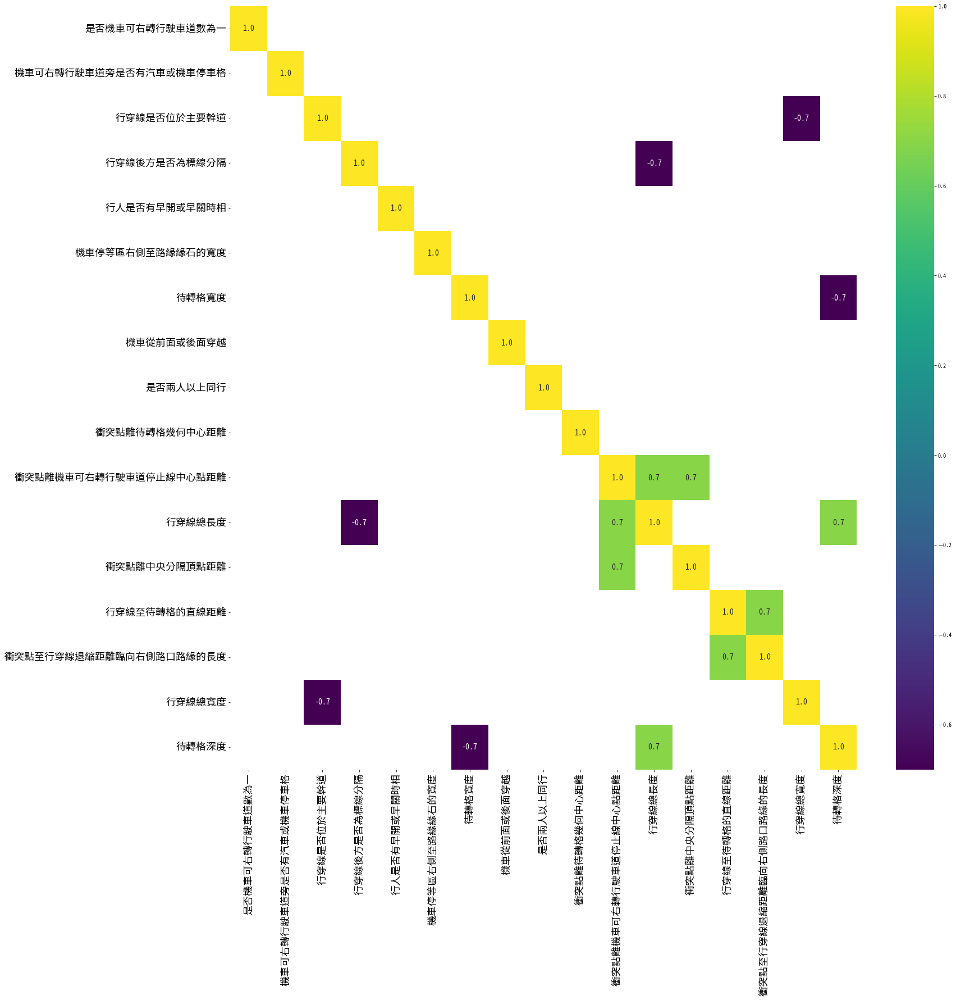

In [90]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr < 0.7) & (X_corr > -0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

In [91]:
import numpy as np
import pandas as pd
import scipy.stats as stats

def check_normality(data):
    results = pd.DataFrame(columns=['Variable', 'Test Statistic', 'P-Value', 'Normality Assumption'])
    for column in data.columns:
        stat, p_value = stats.shapiro(data[column])
        normality_assumption = p_value > 0.05
        results = pd.concat([results, pd.DataFrame({'Variable': [column], 'Test Statistic': [stat], 'P-Value': [p_value], 'Normality Assumption': [normality_assumption]})], ignore_index=True)
    return results

normality_test_results = check_normality(X)
normality_test_results



,Variable,Test Statistic,P-Value,Normality Assumption
0,是否機車可右轉行駛車道數為一,0.628529,7.992352e-38,False
1,機車可右轉行駛車道旁是否有汽車或機車停車格,0.499535,5.039069e-42,False
2,行穿線是否位於主要幹道,0.626428,6.688350e-38,False
3,行穿線後方是否為標線分隔,0.636138,1.533719e-37,False
4,行人是否有早開或早關時相,0.350781,1.401298e-45,False
5,機車停等區右側至路緣緣石的寬度,0.875362,2.115954e-24,False
6,待轉格寬度,0.850860,2.145161e-26,False
7,機車從前面或後面穿越,0.634994,1.389640e-37,False
8,是否兩人以上同行,0.533177,5.053503e-41,False
9,衝突點離待轉格幾何中心距離,0.889739,4.359987e-23,False


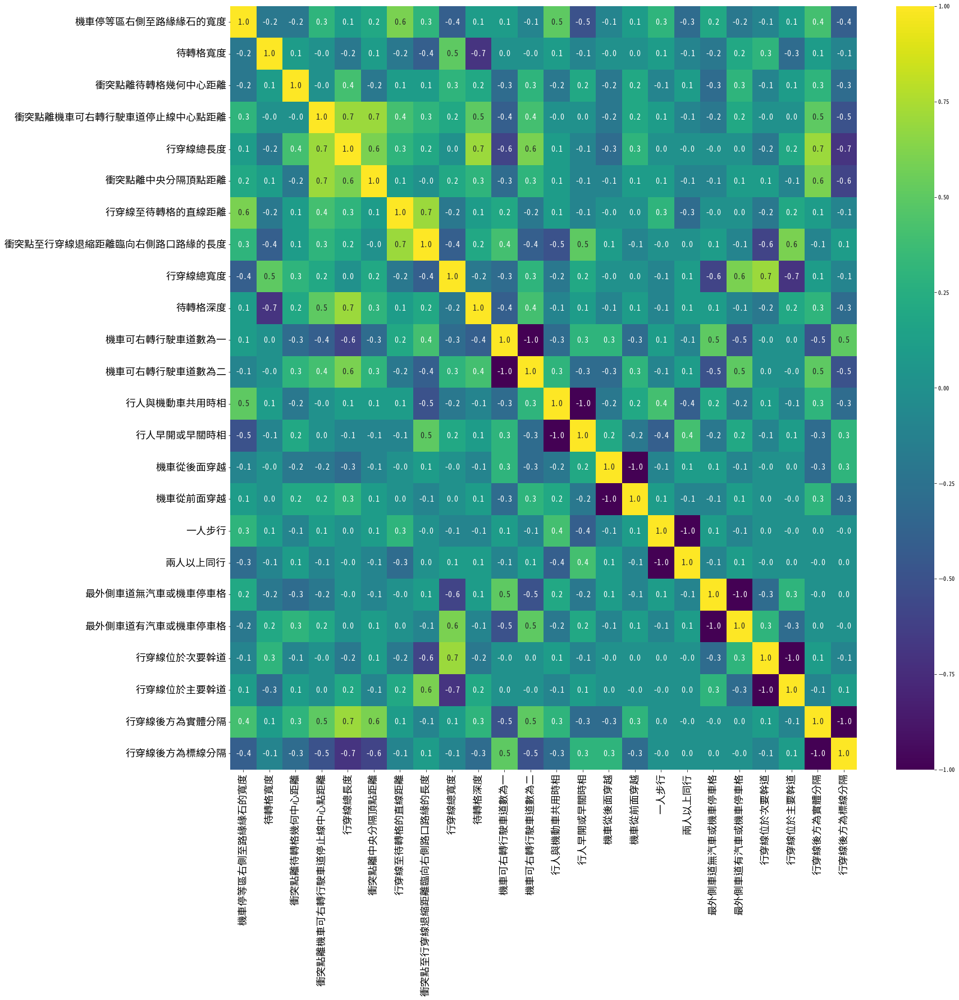

In [93]:
from scipy.stats import spearmanr

X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線是否位於主要幹道','行穿線後方是否為標線分隔'])

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

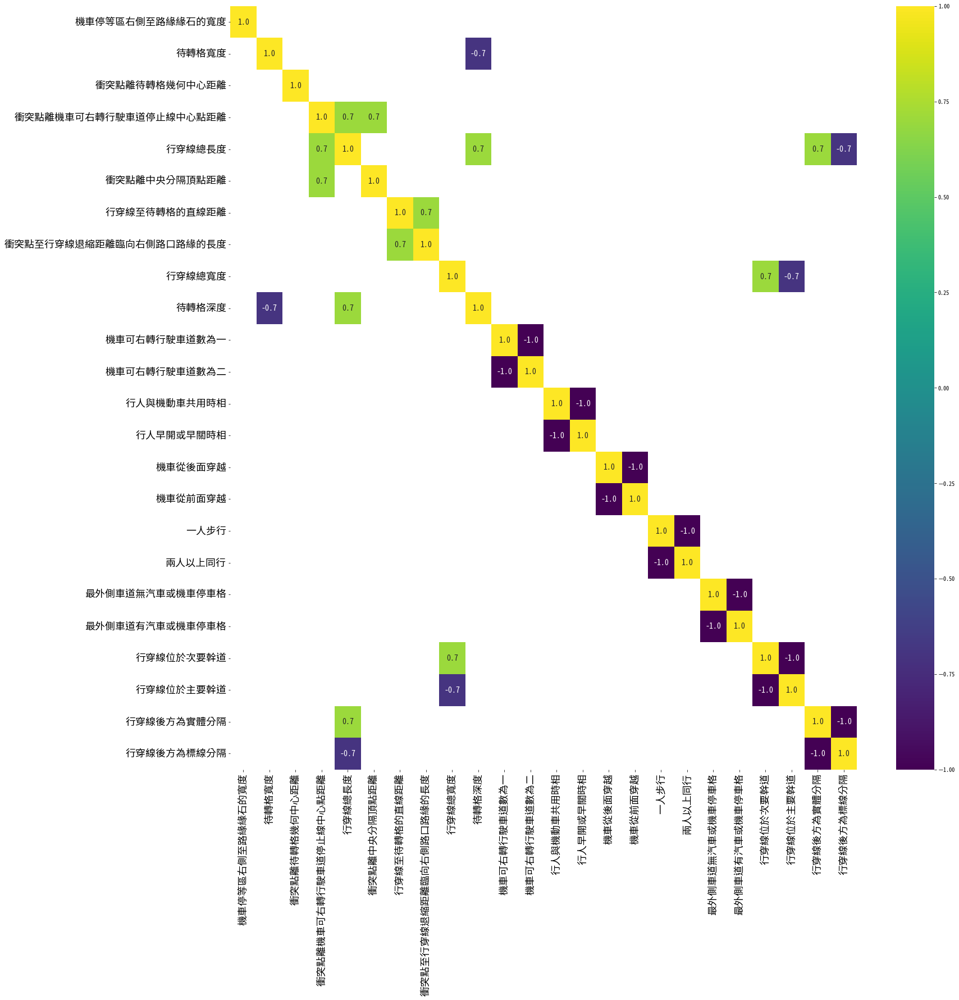

In [94]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線是否位於主要幹道','行穿線後方是否為標線分隔'])

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

# Logistic Regression15個變數

In [95]:
new_feature = ['是否機車可右轉行駛車道數為一','機車可右轉行駛車道旁是否有汽車或機車停車格',
              '行人是否有早開或早關時相',
              '機車從前面或後面穿越',
              '是否兩人以上同行','衝突點離待轉格幾何中心距離','衝突點離機車可右轉行駛車道停止線中心點距離',
               '行穿線總長度','衝突點離中央分隔頂點距離',
               '機車停等區右側至路緣緣石的寬度','衝突點至行穿線退縮距離臨向右側路口路緣的長度',
              '行穿線後方是否為標線分隔','行穿線是否位於主要幹道','行穿線至待轉格的直線距離','待轉格寬度']#'行穿線總寬度','待轉格深度'

# backup_X = X[new_feature].copy()
X = backup_X[new_feature]
len(new_feature)

15

In [96]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# 顯示原始數據的類別分佈
print('Original dataset shape %s' % Counter(y))

# SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

# 顯示經過SMOTE處理後的數據集的類別分佈
print('Resampled dataset shape %s' % Counter(y_res))


Original dataset shape Counter({1: 507, 0: 186, 2: 82})
Resampled dataset shape Counter({2: 507, 1: 507, 0: 507})


  0%|          | 0/152 [00:00<?, ?it/s]

Logistic Regression


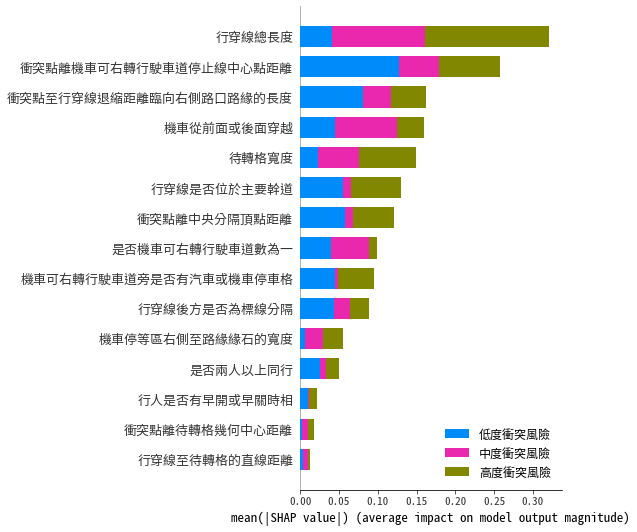

  0%|          | 0/152 [00:00<?, ?it/s]

Support Vector Machine


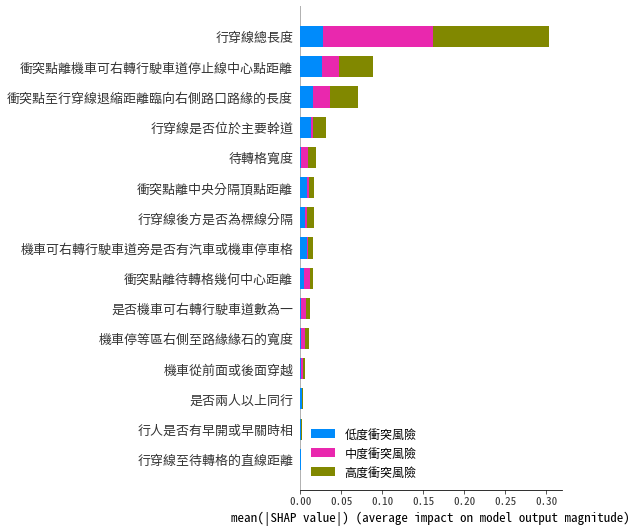

Decision Tree


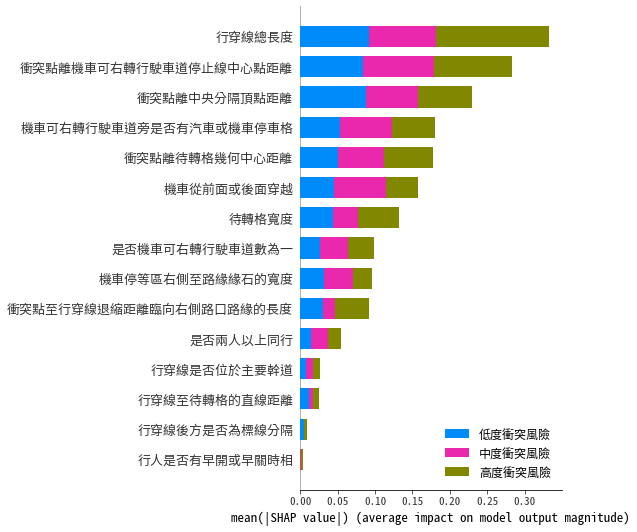

Random Forest


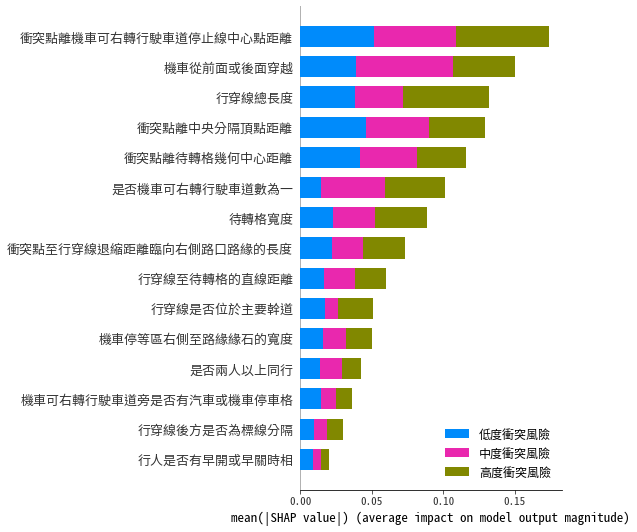

XGBoost


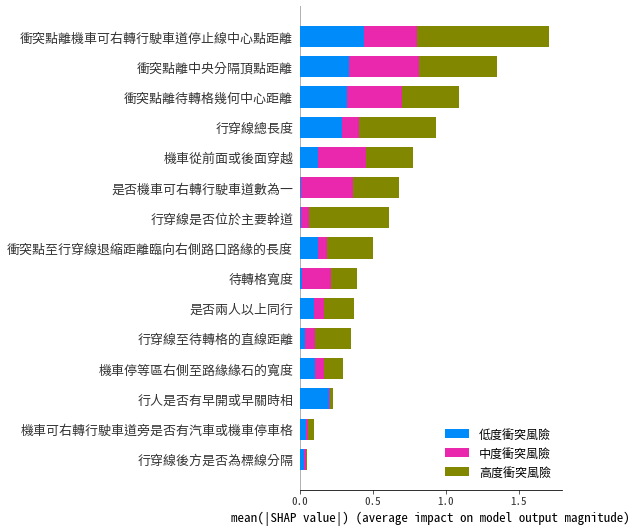


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.587160,0.574725,0.748299,0.581327,0.585135,0.590621,0.582102,0.759792,0.586821,0.590616
1,Support Vector Machine,0.487221,0.399870,0.747708,0.624241,0.489299,0.493389,0.408453,0.757787,0.510307,0.493141
2,Decision Tree,0.739650,0.739198,0.828636,0.741282,0.740326,0.896778,0.896859,0.984335,0.898265,0.896773
3,Random Forest,0.742927,0.741959,0.879735,0.744438,0.743759,0.896778,0.896706,0.978111,0.897089,0.896791
4,XGBoost,0.752146,0.750532,0.886765,0.753980,0.751924,0.895536,0.895471,0.980773,0.895780,0.895543


In [97]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)


results = []
step_results = []


for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res, y_res):
        X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)

    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    


results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [98]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.516340,0.511794,0.711828,0.515586,0.533640,0.597222,0.586964,0.762383,0.592800,0.595498
1,Logistic Regression,0.585526,0.568606,0.694877,0.578094,0.583595,0.590212,0.581618,0.762305,0.588571,0.590515
2,Logistic Regression,0.644737,0.619133,0.795477,0.621689,0.627326,0.582907,0.575635,0.757332,0.578627,0.584269
3,Logistic Regression,0.572368,0.559744,0.756914,0.560989,0.569860,0.590942,0.582635,0.759723,0.587154,0.590976
4,Logistic Regression,0.585526,0.582033,0.773083,0.593923,0.587288,0.593134,0.583655,0.759111,0.589050,0.592942
5,Logistic Regression,0.572368,0.558194,0.760680,0.572814,0.570018,0.596056,0.589388,0.758397,0.592708,0.596383
6,Logistic Regression,0.546053,0.544014,0.720984,0.542402,0.556164,0.599708,0.591976,0.762023,0.596697,0.598643
7,Logistic Regression,0.625000,0.621568,0.767049,0.631791,0.636792,0.579985,0.569631,0.762164,0.574380,0.578499
8,Logistic Regression,0.651316,0.612632,0.755445,0.621188,0.610263,0.579255,0.572471,0.757918,0.576830,0.583696
9,Logistic Regression,0.572368,0.569536,0.746652,0.574796,0.576406,0.596786,0.587041,0.756568,0.591389,0.594743


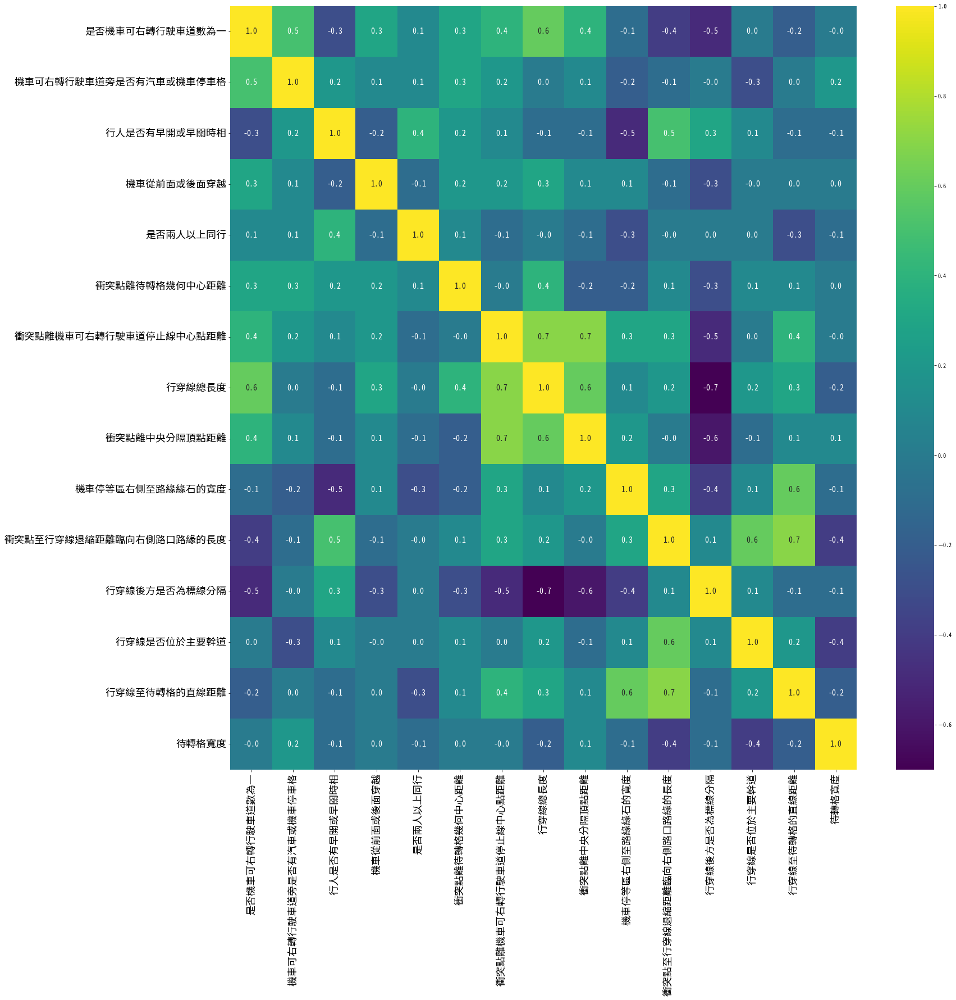

In [99]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

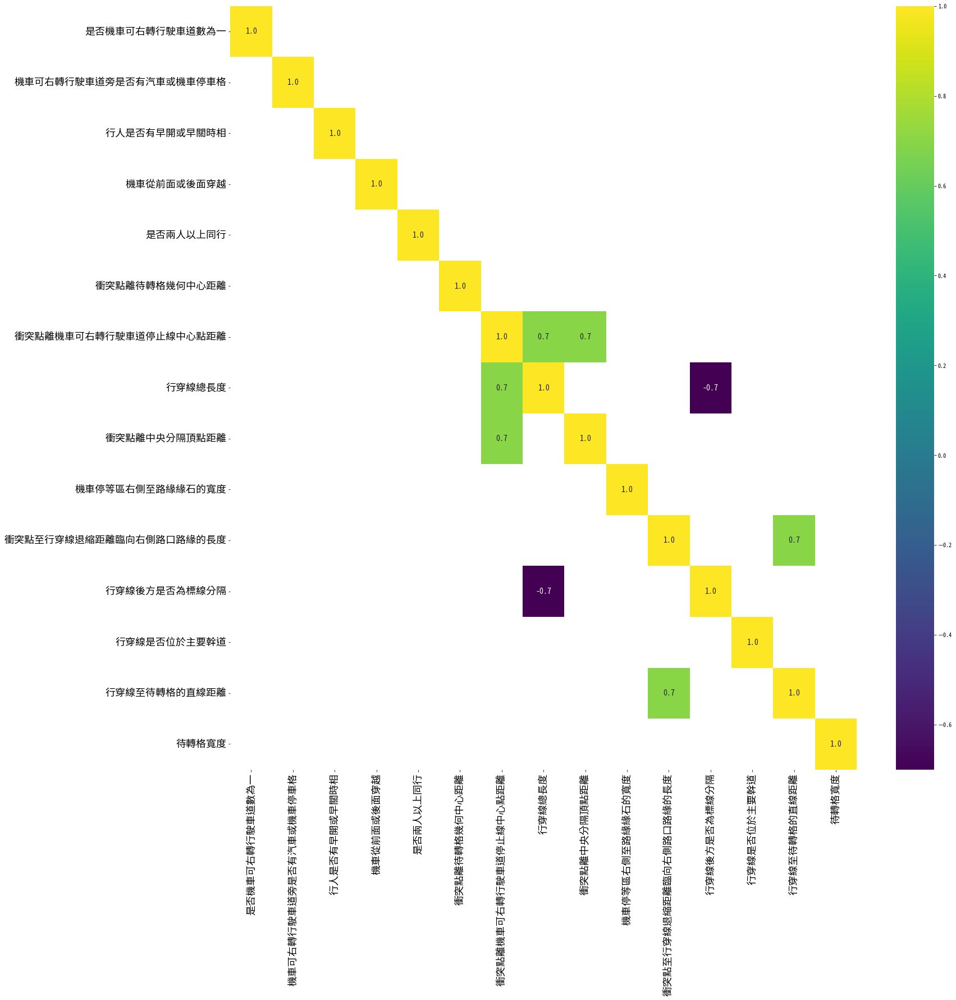

In [100]:
from scipy.stats import spearmanr

correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

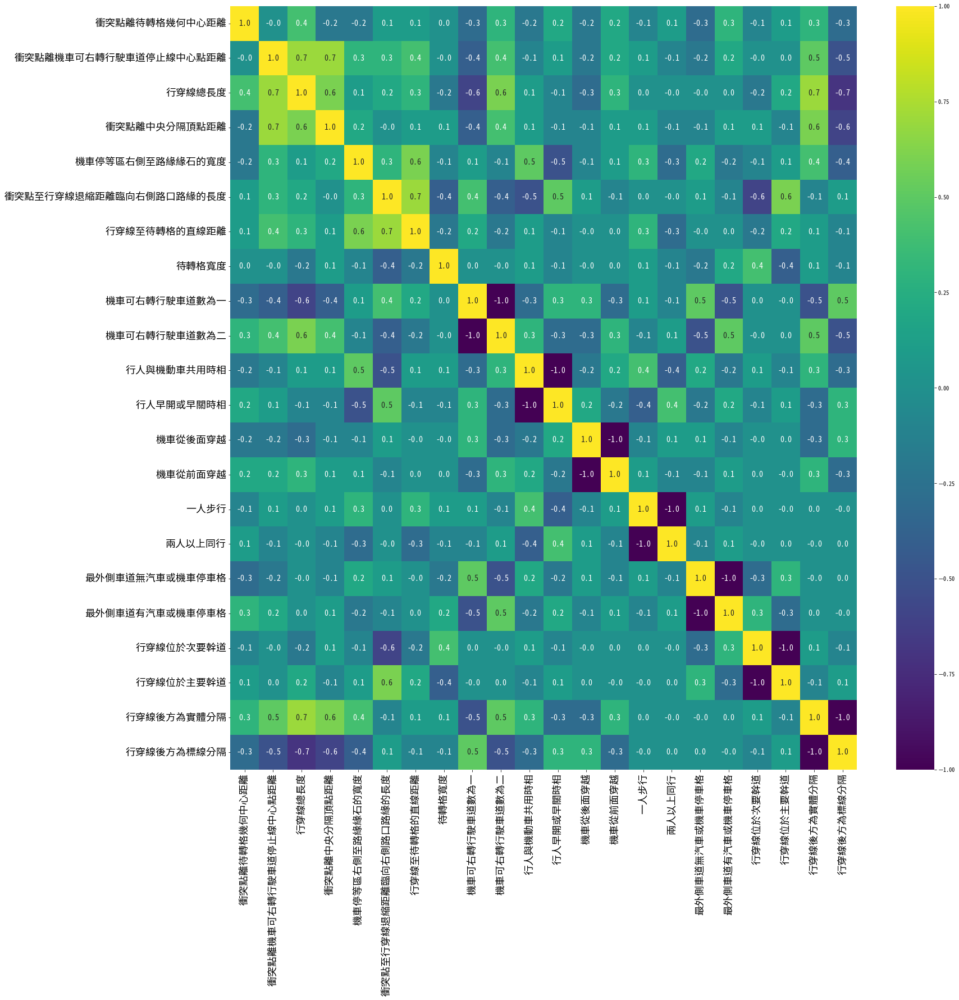

In [101]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線是否位於主要幹道','行穿線後方是否為標線分隔'])

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

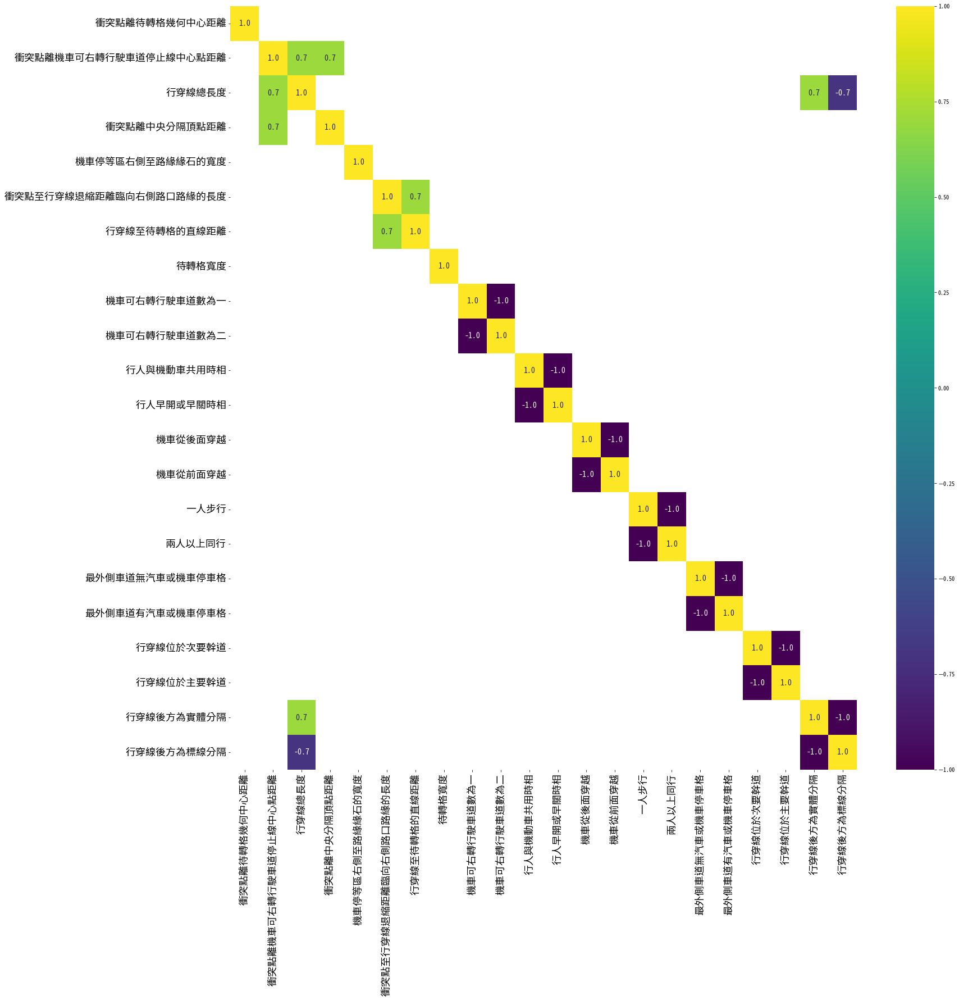

In [102]:
from scipy.stats import spearmanr


X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線是否位於主要幹道','行穿線後方是否為標線分隔'])

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

# SVM14個變數

In [103]:
new_feature = ['是否機車可右轉行駛車道數為一','機車可右轉行駛車道旁是否有汽車或機車停車格',
              '行人是否有早開或早關時相',
              '機車從前面或後面穿越',
              '是否兩人以上同行','衝突點離待轉格幾何中心距離','衝突點離機車可右轉行駛車道停止線中心點距離',
               '行穿線總長度','衝突點離中央分隔頂點距離',
               '機車停等區右側至路緣緣石的寬度','衝突點至行穿線退縮距離臨向右側路口路緣的長度',
              '行穿線後方是否為標線分隔','行穿線是否位於主要幹道','待轉格深度']#,'行穿線至代轉格的直線距離','待轉格寬度','行穿線總寬度'

# backup_X = X[new_feature].copy()
X = backup_X[new_feature]
len(new_feature)

14

In [104]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# 顯示原始數據的類別分佈
print('Original dataset shape %s' % Counter(y))

# SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

# 顯示經過SMOTE處理後的數據集的類別分佈
print('Resampled dataset shape %s' % Counter(y_res))


Original dataset shape Counter({1: 507, 0: 186, 2: 82})
Resampled dataset shape Counter({2: 507, 1: 507, 0: 507})


  0%|          | 0/152 [00:00<?, ?it/s]

Logistic Regression


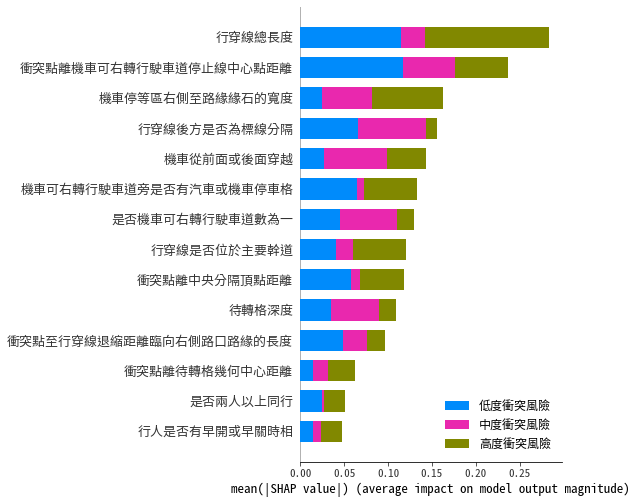

  0%|          | 0/152 [00:00<?, ?it/s]

Support Vector Machine


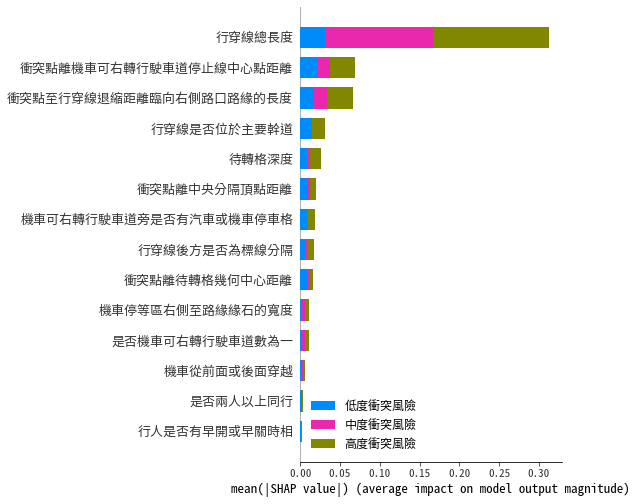

Decision Tree


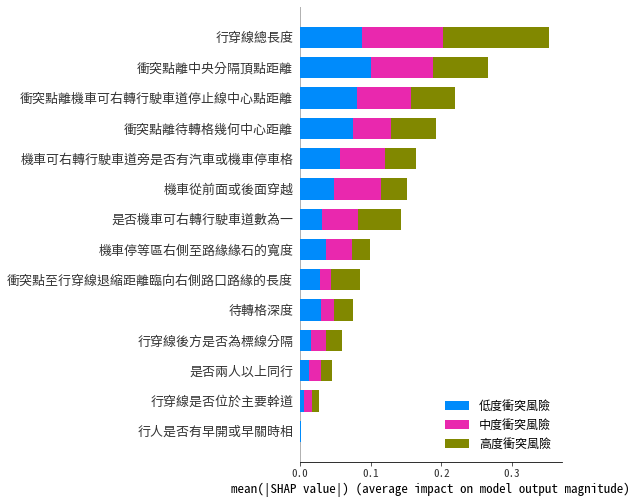

Random Forest


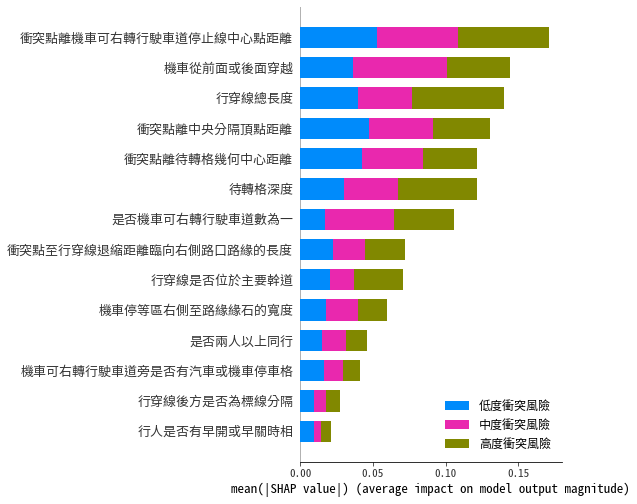

XGBoost


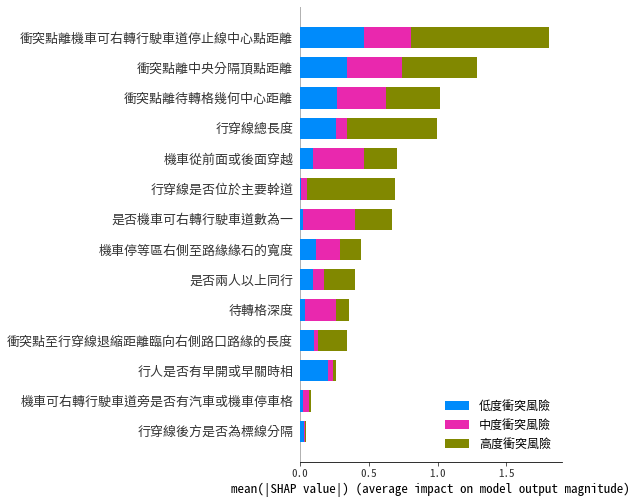


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.589108,0.578147,0.751467,0.584109,0.588864,0.598438,0.590382,0.761654,0.595052,0.598272
1,Support Vector Machine,0.495115,0.415552,0.749775,0.584914,0.497587,0.506246,0.432885,0.759358,0.578563,0.505917
2,Decision Tree,0.738351,0.737482,0.827128,0.740768,0.738560,0.896340,0.896398,0.984292,0.898227,0.896317
3,Random Forest,0.749518,0.748316,0.881149,0.750573,0.750175,0.896340,0.896272,0.978332,0.896938,0.896321
4,XGBoost,0.754777,0.754208,0.889311,0.757466,0.755791,0.895463,0.895420,0.980776,0.895663,0.895470


In [105]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)

results = []
step_results = []

for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res, y_res):
        X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)
    
    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    

results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [106]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.555556,0.553018,0.727671,0.562697,0.570702,0.614766,0.604942,0.763230,0.610051,0.613045
1,Logistic Regression,0.565789,0.546323,0.694848,0.553763,0.564234,0.613587,0.604715,0.768215,0.611867,0.613897
2,Logistic Regression,0.631579,0.609238,0.786065,0.612193,0.616005,0.582907,0.576272,0.757608,0.579384,0.584209
3,Logistic Regression,0.592105,0.583478,0.751838,0.587963,0.589514,0.599708,0.590025,0.760281,0.595696,0.599854
4,Logistic Regression,0.592105,0.587852,0.763593,0.597379,0.592686,0.588020,0.581065,0.760148,0.582606,0.587985
5,Logistic Regression,0.598684,0.588574,0.761199,0.594580,0.595628,0.591673,0.585146,0.760607,0.587803,0.592018
6,Logistic Regression,0.572368,0.568745,0.736744,0.569003,0.580407,0.593134,0.587290,0.765143,0.589039,0.592329
7,Logistic Regression,0.605263,0.602834,0.767418,0.611224,0.618982,0.599708,0.590487,0.760871,0.594954,0.598224
8,Logistic Regression,0.631579,0.600120,0.772129,0.600147,0.600199,0.588020,0.584760,0.759589,0.586503,0.591063
9,Logistic Regression,0.546053,0.541284,0.753169,0.552137,0.560287,0.612856,0.599119,0.760847,0.612617,0.610096


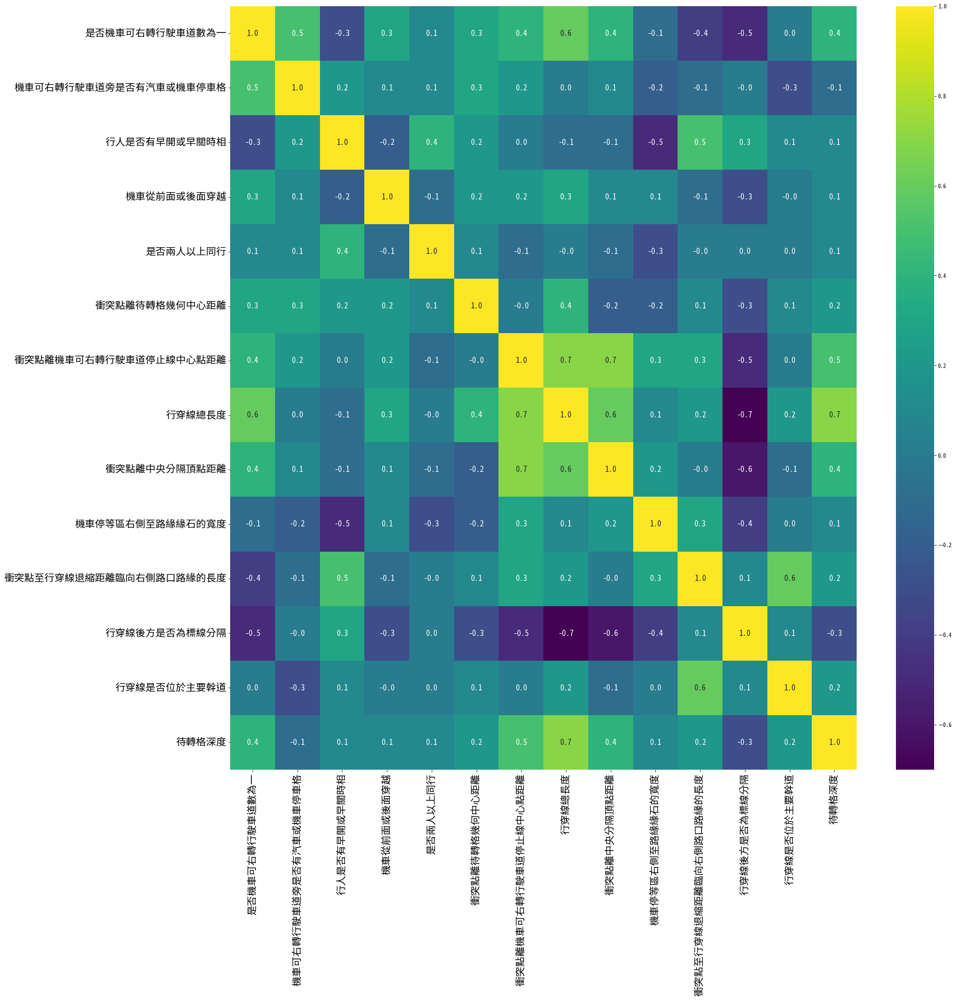

In [107]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

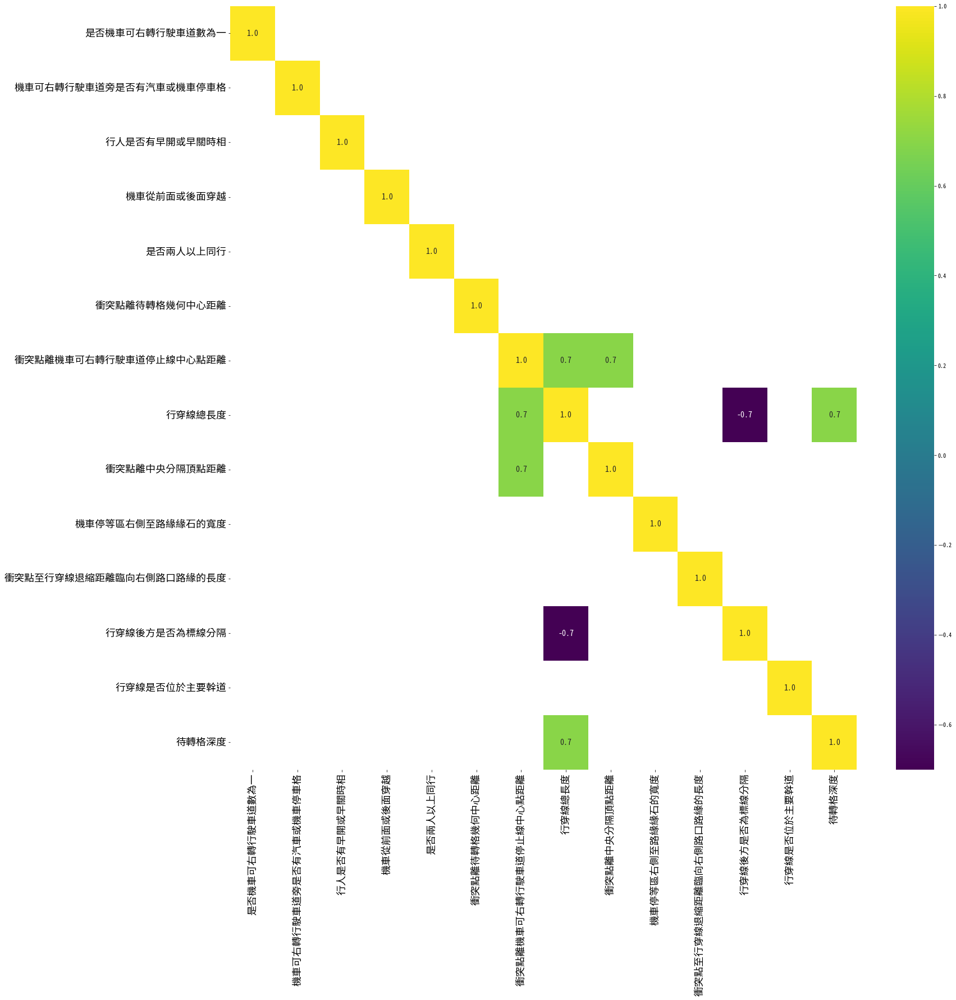

In [108]:
from scipy.stats import spearmanr

correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

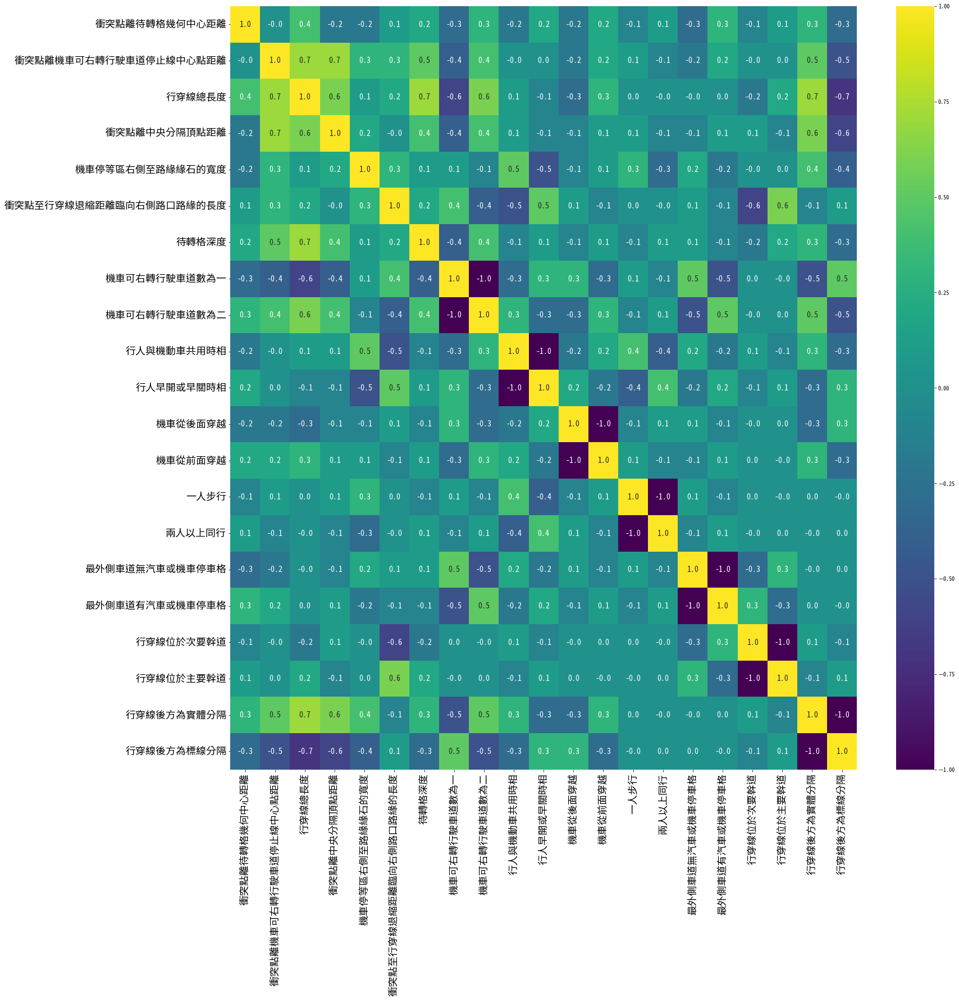

In [109]:
from scipy.stats import spearmanr

X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線是否位於主要幹道','行穿線後方是否為標線分隔'])

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

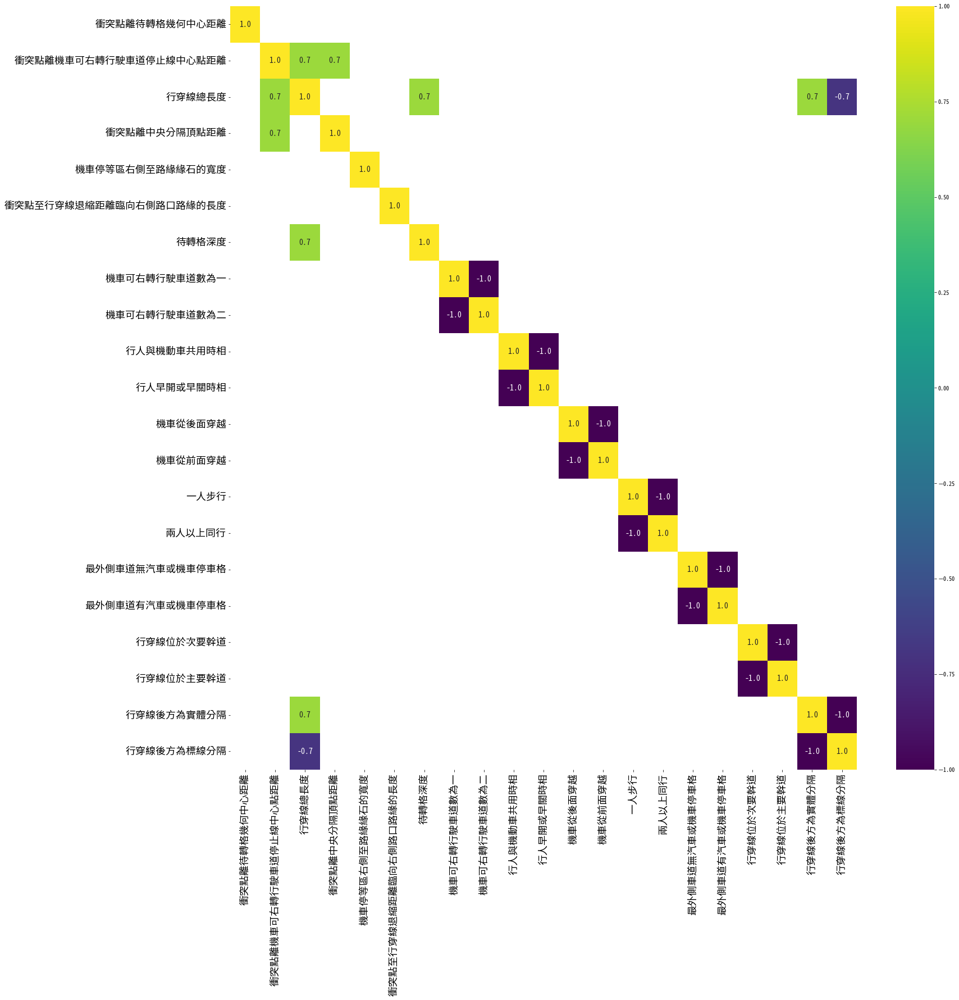

In [110]:
from scipy.stats import spearmanr

X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線是否位於主要幹道','行穿線後方是否為標線分隔'])

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])
X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

# Decision tree13個變數

In [111]:
new_feature = ['是否機車可右轉行駛車道數為一','機車可右轉行駛車道旁是否有汽車或機車停車格',
              '行人是否有早開或早關時相',
              '待轉格寬度','機車從前面或後面穿越',
              '是否兩人以上同行','衝突點離待轉格幾何中心距離','衝突點離機車可右轉行駛車道停止線中心點距離',
               '行穿線總長度','衝突點離中央分隔頂點距離',
               '機車停等區右側至路緣緣石的寬度','衝突點至行穿線退縮距離臨向右側路口路緣的長度','行穿線總寬度'
              ]#'行穿線後方是否為標線分隔','行穿線是否位於主要幹道','待轉格深度',,'行穿線至代轉格的直線距離',

# backup_X = X[new_feature].copy()
X = backup_X[new_feature]
len(new_feature)

13

In [112]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# 顯示原始數據的類別分佈
print('Original dataset shape %s' % Counter(y))

# SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

# 顯示經過SMOTE處理後的數據集的類別分佈
print('Resampled dataset shape %s' % Counter(y_res))


Original dataset shape Counter({1: 507, 0: 186, 2: 82})
Resampled dataset shape Counter({2: 507, 1: 507, 0: 507})


  0%|          | 0/152 [00:00<?, ?it/s]

Logistic Regression


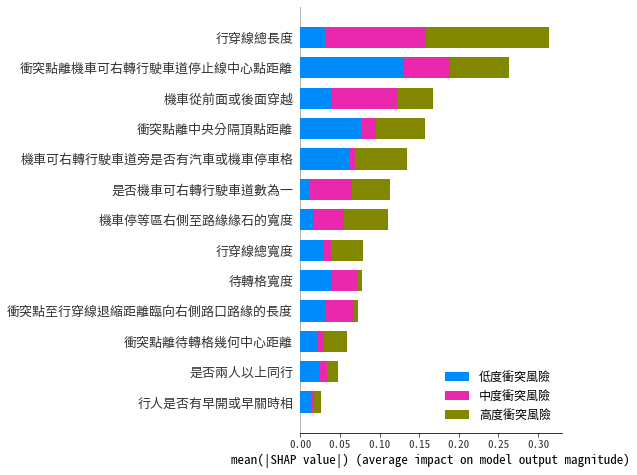

  0%|          | 0/152 [00:00<?, ?it/s]

Support Vector Machine


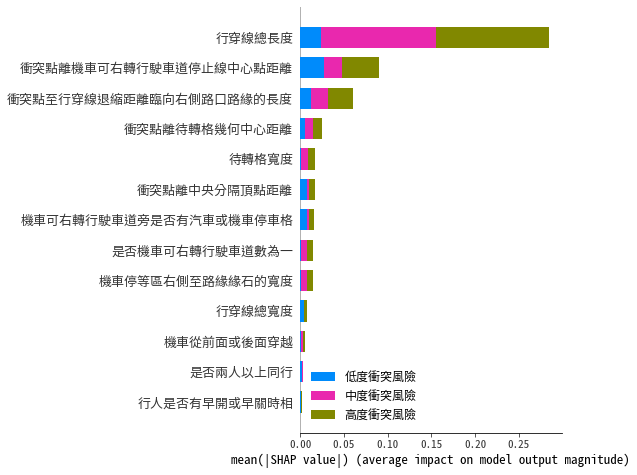

Decision Tree


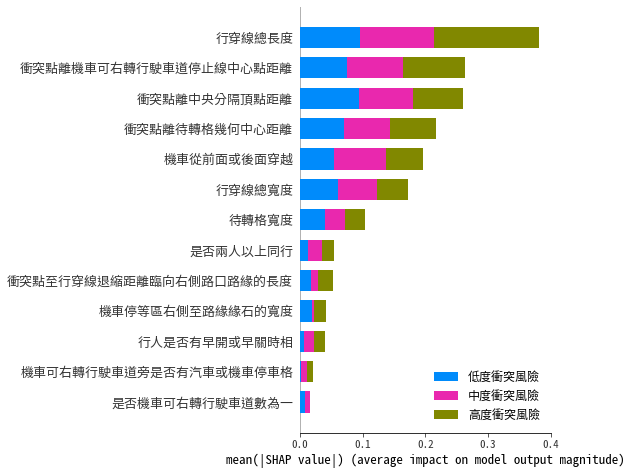

Random Forest


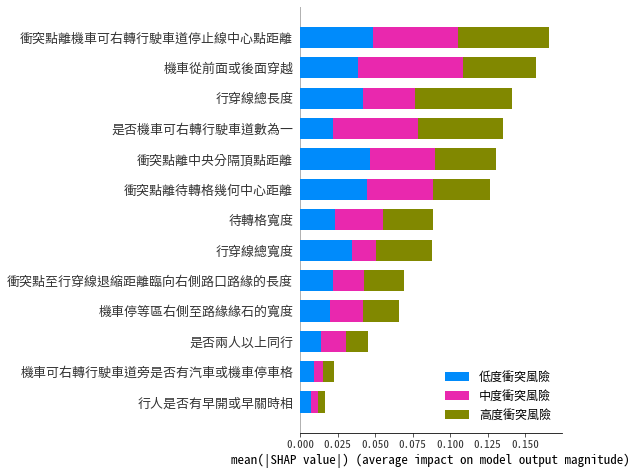

XGBoost


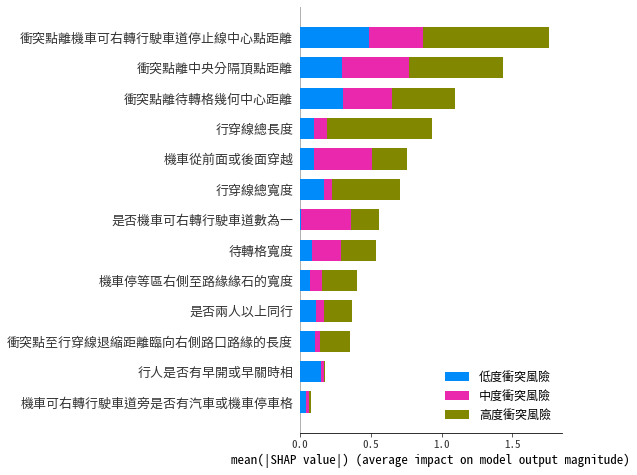


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.575963,0.564744,0.745797,0.572026,0.575053,0.589306,0.581397,0.755287,0.585535,0.589240
1,Support Vector Machine,0.483931,0.392759,0.741920,0.600065,0.485618,0.486668,0.396254,0.751459,0.465317,0.486478
2,Decision Tree,0.737685,0.737743,0.825419,0.742105,0.739092,0.896121,0.896163,0.984296,0.898343,0.896095
3,Random Forest,0.737014,0.735811,0.878292,0.738325,0.737697,0.896121,0.896015,0.978059,0.896739,0.896110
4,XGBoost,0.750826,0.749915,0.888507,0.753568,0.751298,0.895025,0.894965,0.980747,0.895351,0.895016


In [113]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)

results = []
step_results = []

for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res, y_res):
        X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)
    
    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    


results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [114]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.535948,0.530911,0.713299,0.539031,0.553461,0.597953,0.588486,0.756387,0.593574,0.596291
1,Logistic Regression,0.546053,0.521355,0.689086,0.524634,0.543563,0.595325,0.586674,0.762434,0.594753,0.595797
2,Logistic Regression,0.618421,0.600748,0.786113,0.601496,0.604676,0.583638,0.576396,0.748965,0.580312,0.584950
3,Logistic Regression,0.592105,0.582184,0.752106,0.581871,0.589755,0.584368,0.576620,0.753743,0.579978,0.584357
4,Logistic Regression,0.611842,0.607677,0.776252,0.620121,0.613849,0.600438,0.593779,0.755605,0.595694,0.600253
5,Logistic Regression,0.532895,0.527774,0.750975,0.550118,0.531949,0.574872,0.570201,0.751123,0.572312,0.575162
6,Logistic Regression,0.526316,0.521249,0.711828,0.522884,0.531546,0.590942,0.584821,0.761214,0.587210,0.590209
7,Logistic Regression,0.598684,0.597290,0.765804,0.601905,0.610120,0.585099,0.574452,0.753918,0.578659,0.583515
8,Logistic Regression,0.638158,0.603230,0.769748,0.604473,0.602768,0.587290,0.582373,0.756721,0.584411,0.591206
9,Logistic Regression,0.559211,0.555024,0.742765,0.573723,0.568841,0.593134,0.580165,0.752755,0.588446,0.590658


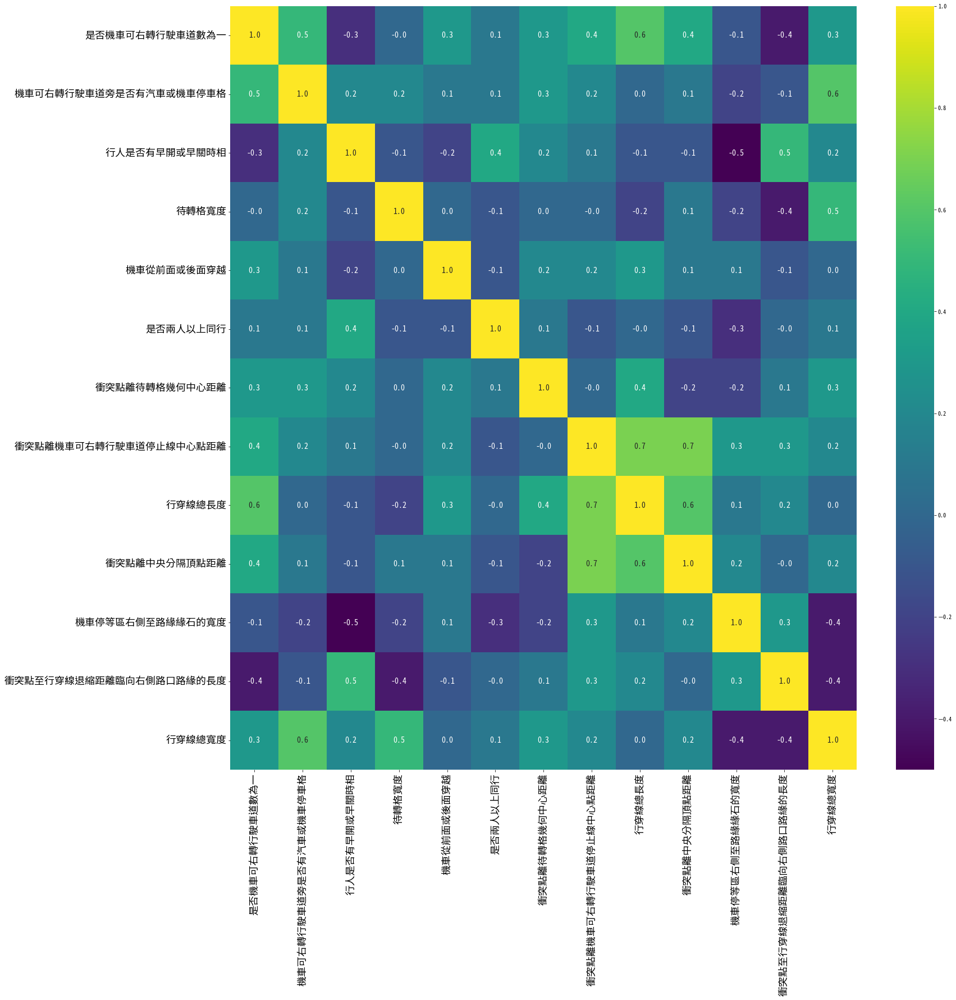

In [115]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

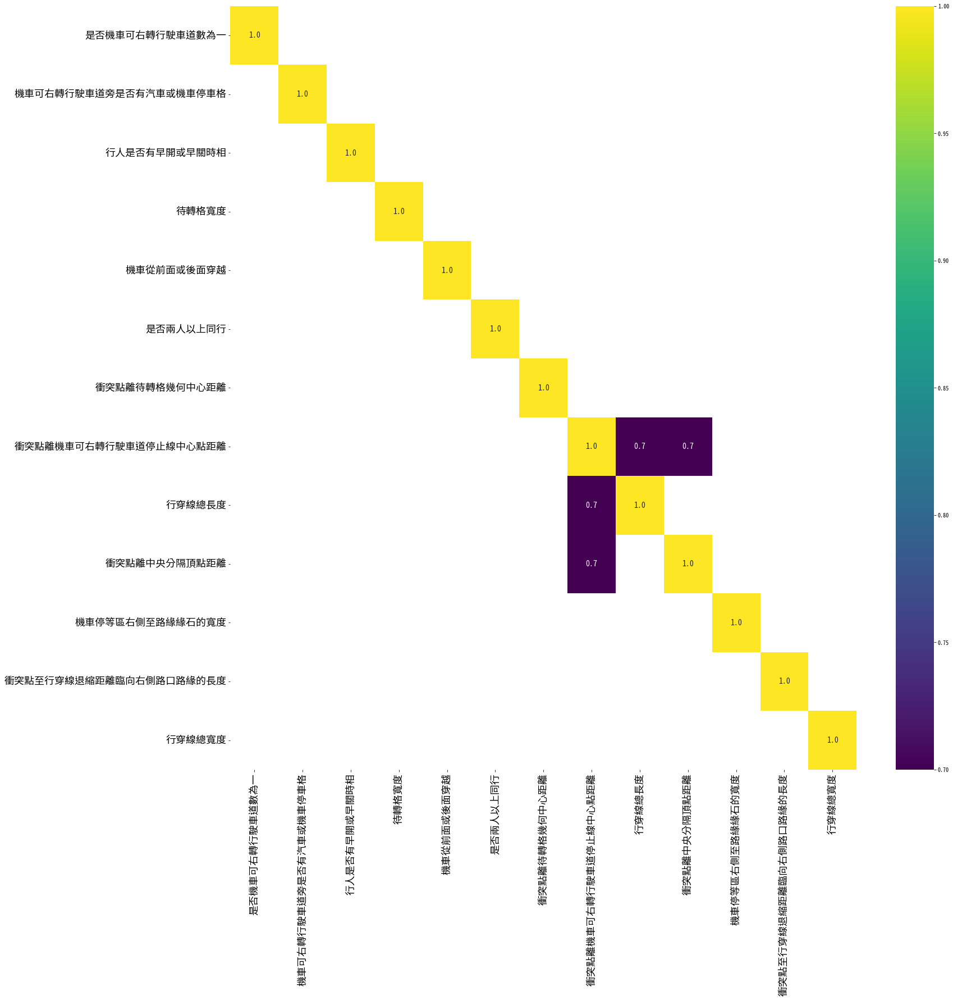

In [116]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

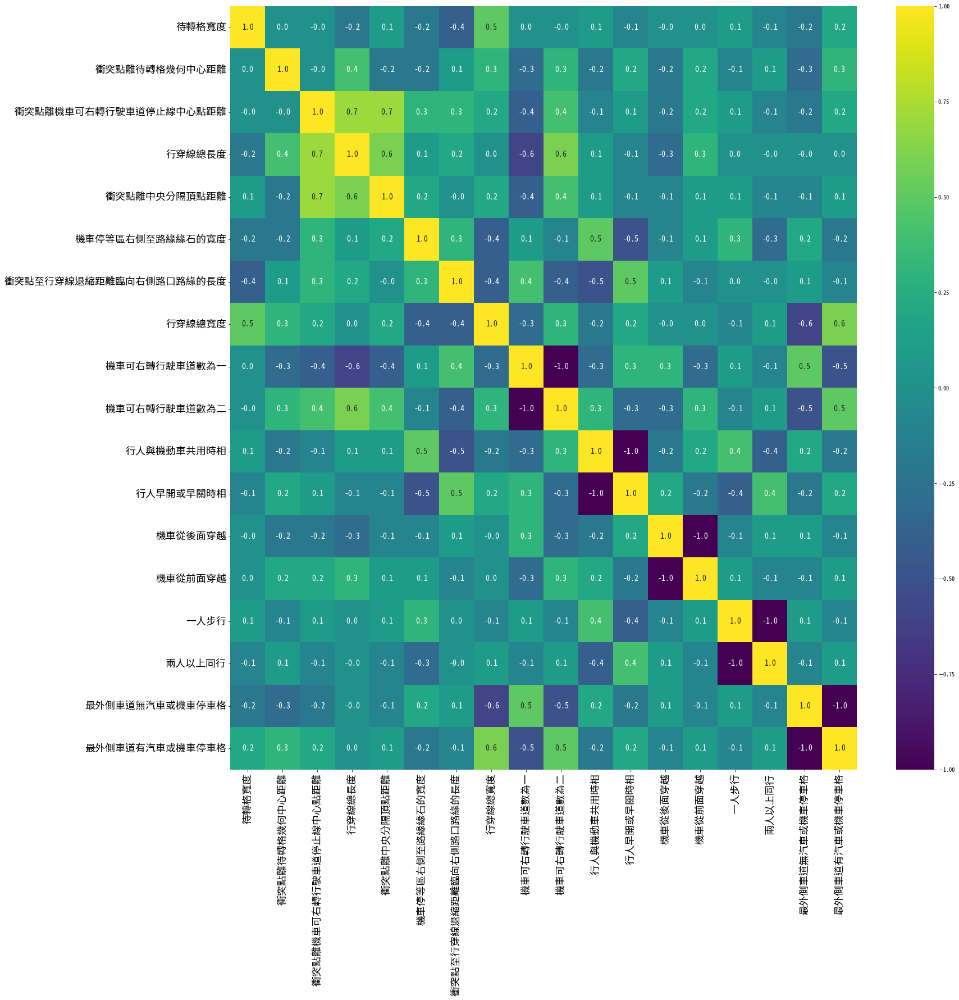

In [117]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格'])#,'行穿線是否位於主要幹道','行穿線後方是否為標線分隔'

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

# X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
# X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

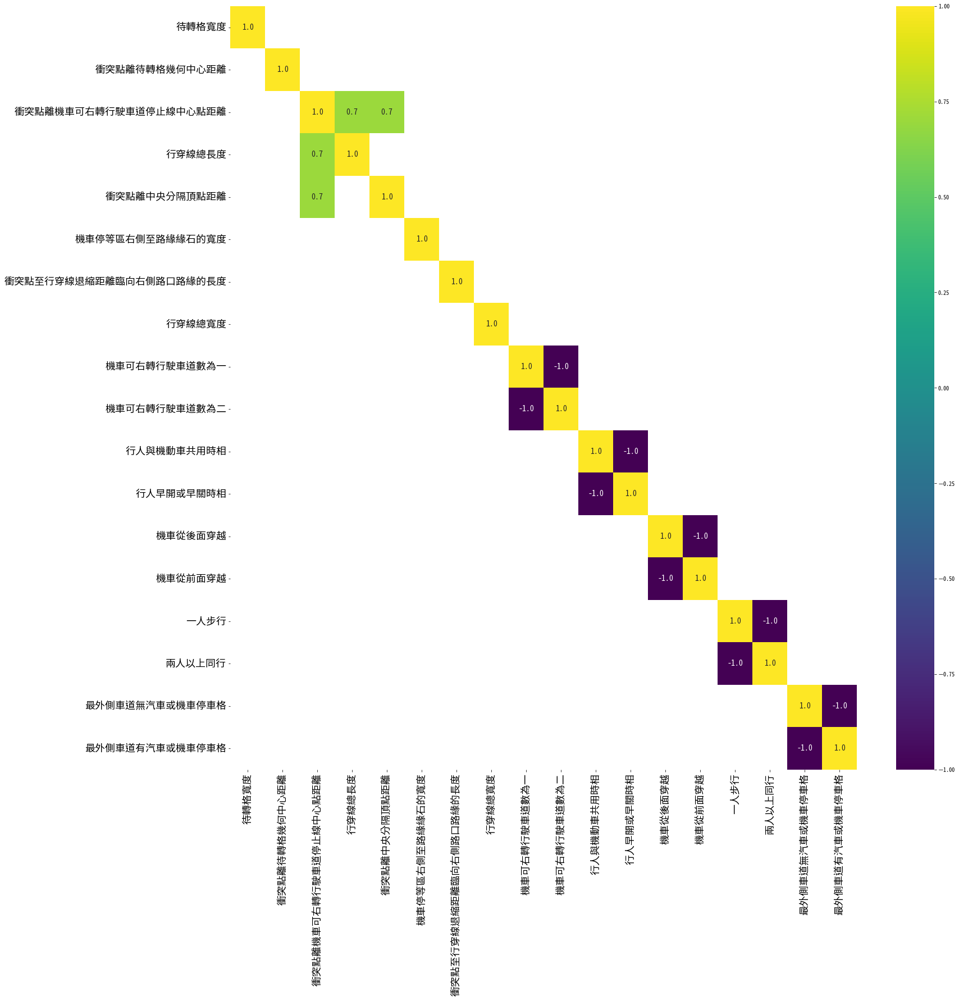

In [118]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格'])#,'行穿線是否位於主要幹道','行穿線後方是否為標線分隔'

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

# X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
# X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])
X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

# Random forest14個變數

In [119]:
new_feature = ['是否機車可右轉行駛車道數為一','機車可右轉行駛車道旁是否有汽車或機車停車格',
              '行人是否有早開或早關時相',
              '待轉格寬度','機車從前面或後面穿越',
              '是否兩人以上同行','衝突點離待轉格幾何中心距離','衝突點離機車可右轉行駛車道停止線中心點距離',
               '行穿線總長度','衝突點離中央分隔頂點距離',
               '行穿線後方是否為標線分隔','機車停等區右側至路緣緣石的寬度',
              '待轉格深度','行穿線是否位於主要幹道']#'衝突點至行穿線退縮距離臨向右側路口路緣的長度','行穿線總寬度','行穿線至代轉格的直線距離',

# backup_X = X[new_feature].copy()
X = backup_X[new_feature]
len(new_feature)

14

In [120]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# 顯示原始數據的類別分佈
print('Original dataset shape %s' % Counter(y))

# SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

# 顯示經過SMOTE處理後的數據集的類別分佈
print('Resampled dataset shape %s' % Counter(y_res))


Original dataset shape Counter({1: 507, 0: 186, 2: 82})
Resampled dataset shape Counter({2: 507, 1: 507, 0: 507})


  0%|          | 0/152 [00:00<?, ?it/s]

Logistic Regression


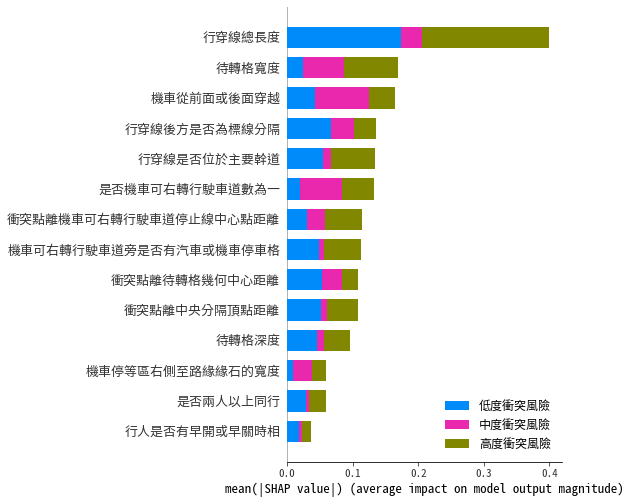

  0%|          | 0/152 [00:00<?, ?it/s]

Support Vector Machine


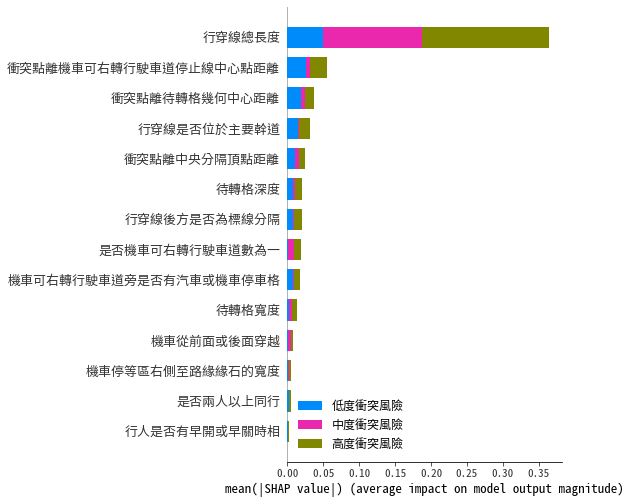

Decision Tree


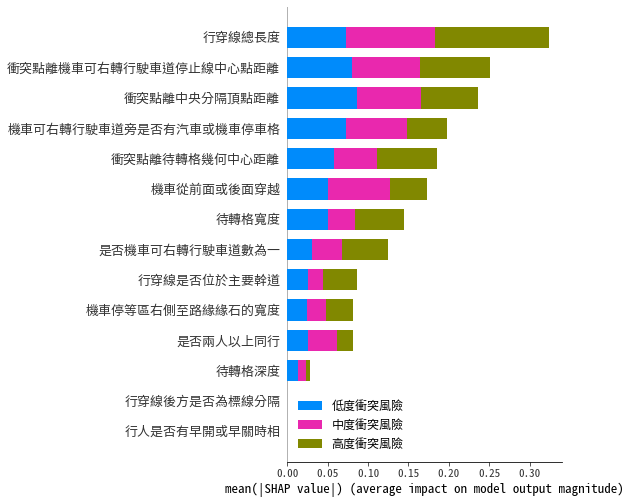

Random Forest


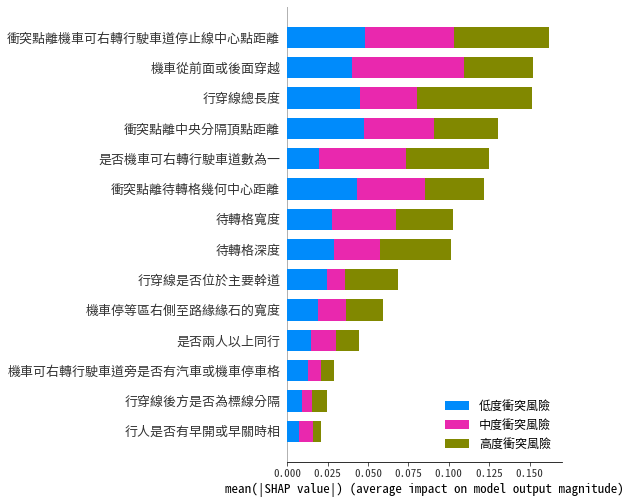

XGBoost


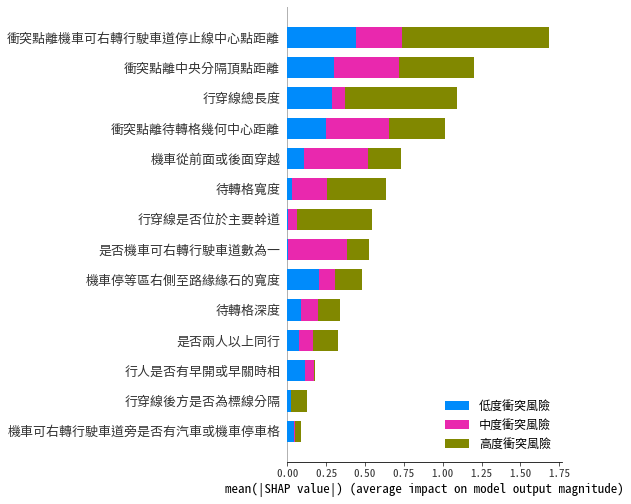


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.602288,0.587108,0.760186,0.600173,0.601952,0.611733,0.600582,0.771478,0.610450,0.611697
1,Support Vector Machine,0.508252,0.438527,0.750428,0.549924,0.510795,0.518082,0.454377,0.759771,0.536024,0.517750
2,Decision Tree,0.744913,0.744477,0.830563,0.748278,0.746351,0.896121,0.896163,0.984296,0.898343,0.896095
3,Random Forest,0.746229,0.744104,0.883160,0.745955,0.745992,0.896121,0.896033,0.978515,0.896671,0.896072
4,XGBoost,0.756072,0.754258,0.888567,0.757605,0.755628,0.895317,0.895263,0.980962,0.895616,0.895309


In [121]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}


def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)


results = []
step_results = []


for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res, y_res):
        X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)
    
    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    

    
results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [122]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.522876,0.512606,0.733213,0.528996,0.544368,0.620614,0.607941,0.774159,0.618849,0.618670
1,Logistic Regression,0.605263,0.581709,0.707787,0.609436,0.602872,0.612856,0.602930,0.773251,0.614255,0.613217
2,Logistic Regression,0.657895,0.629382,0.792674,0.635880,0.639231,0.603360,0.593828,0.766928,0.602403,0.604879
3,Logistic Regression,0.598684,0.584437,0.780254,0.589854,0.596663,0.604091,0.593532,0.771223,0.601466,0.604125
4,Logistic Regression,0.598684,0.593200,0.763651,0.611307,0.600516,0.618700,0.605569,0.775390,0.615721,0.618457
5,Logistic Regression,0.598684,0.581338,0.769156,0.595751,0.596051,0.611395,0.601257,0.772230,0.608972,0.611811
6,Logistic Regression,0.578947,0.572267,0.740684,0.579551,0.590158,0.613587,0.600928,0.771613,0.613035,0.612363
7,Logistic Regression,0.618421,0.613966,0.772919,0.623522,0.633305,0.617969,0.606770,0.773887,0.616514,0.616311
8,Logistic Regression,0.671053,0.631479,0.771188,0.641684,0.629278,0.594595,0.585928,0.768080,0.593466,0.599624
9,Logistic Regression,0.572368,0.570701,0.770333,0.585753,0.587073,0.620161,0.607137,0.768020,0.619817,0.617516


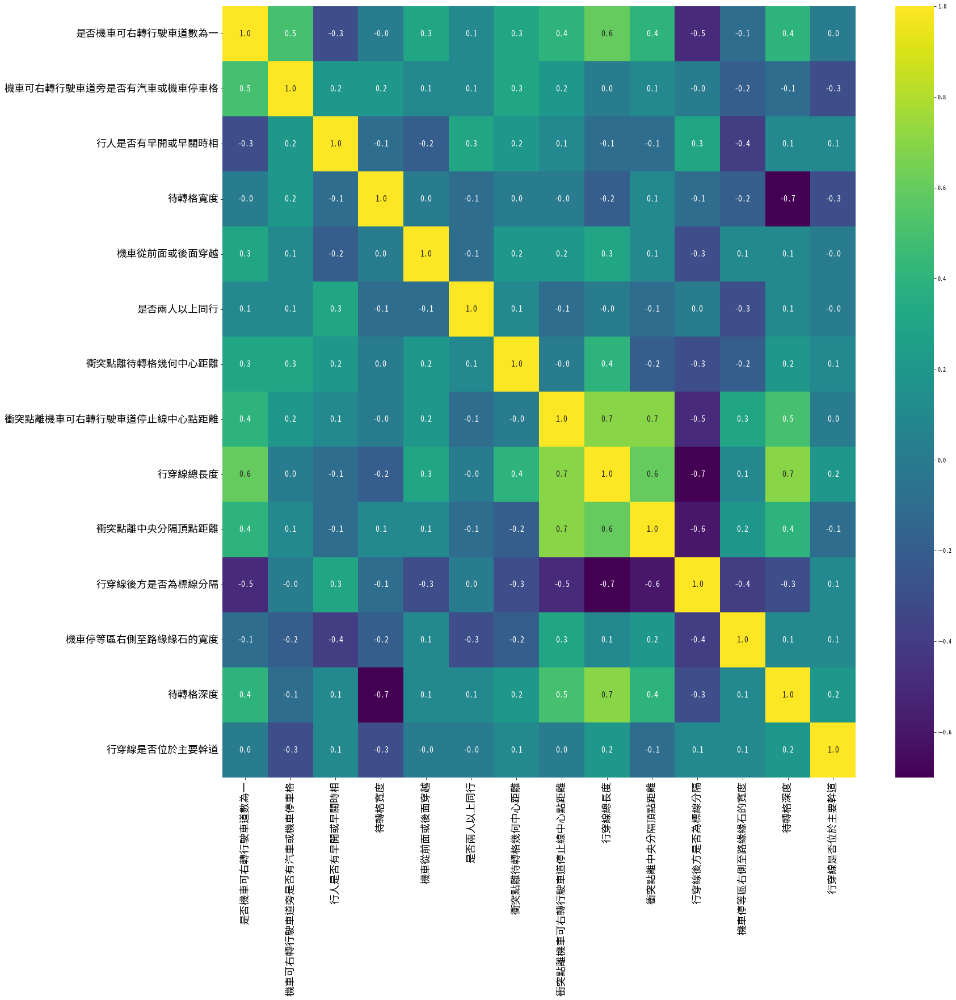

In [123]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])
X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

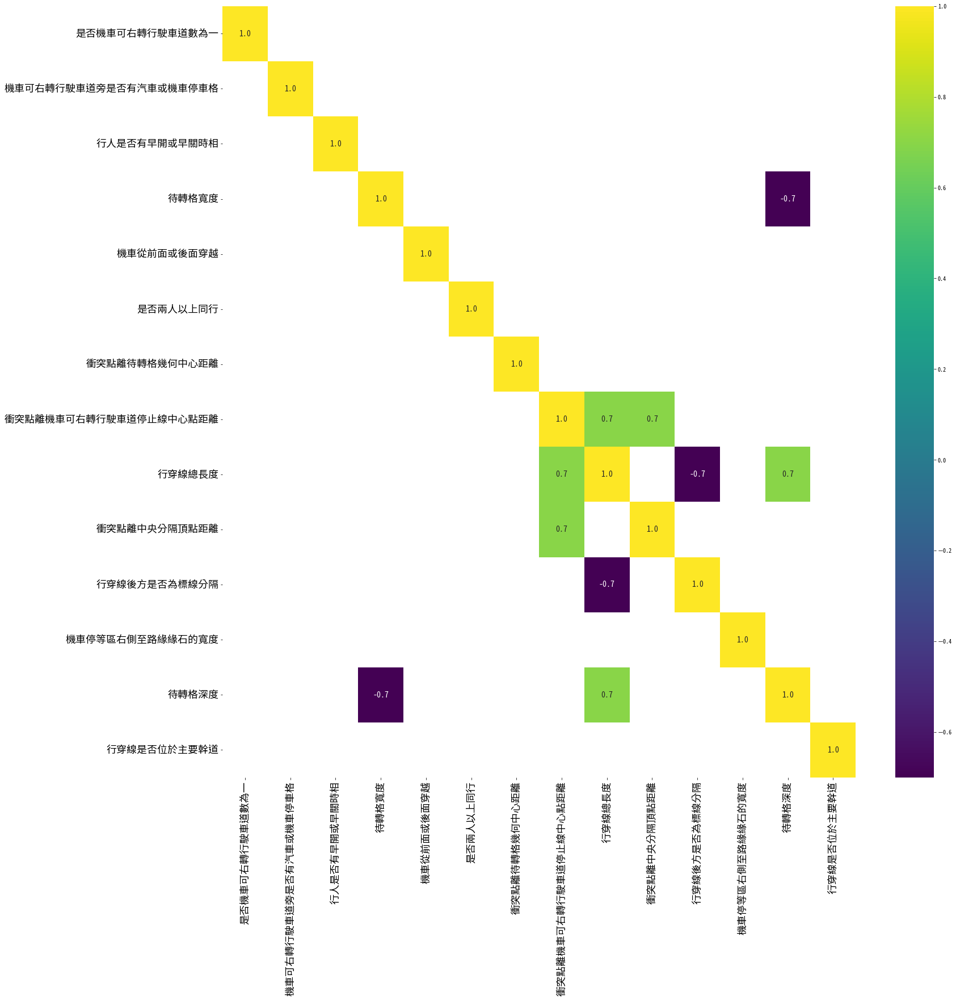

In [124]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])
X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

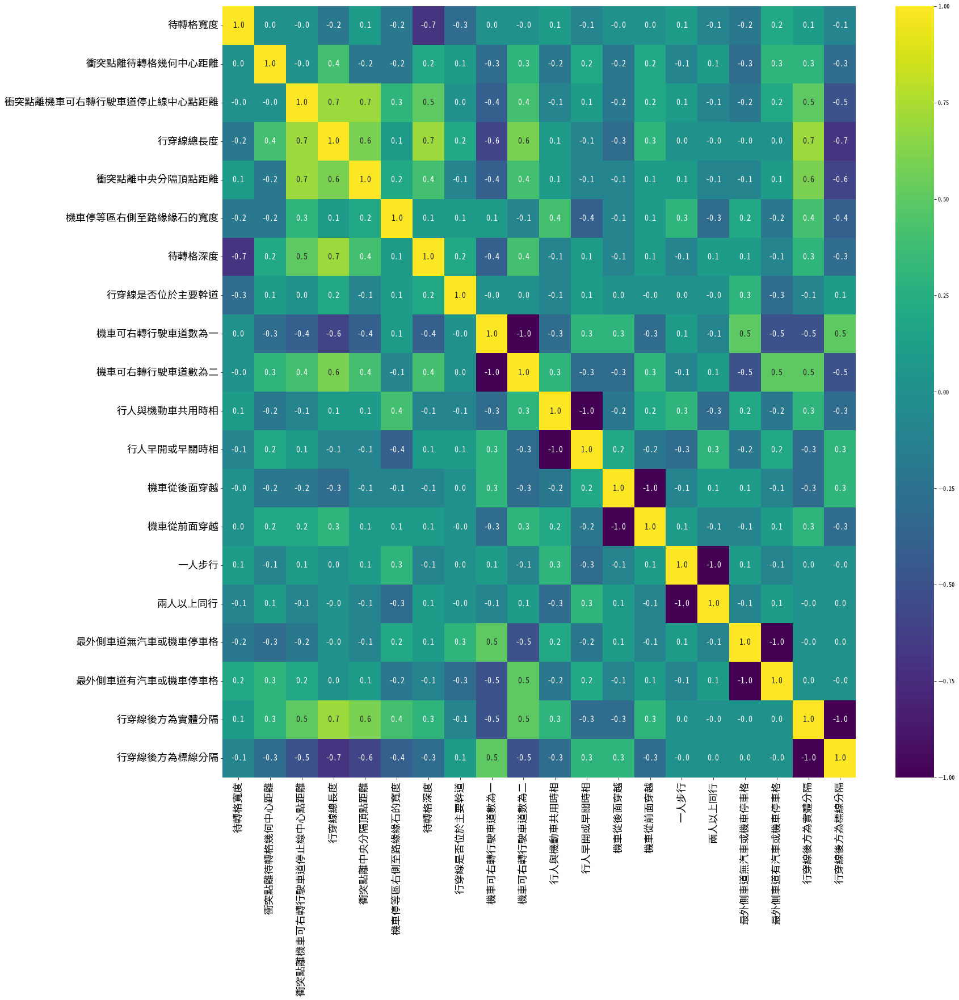

In [125]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線後方是否為標線分隔'])#,'行穿線是否位於主要幹道'

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])
X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

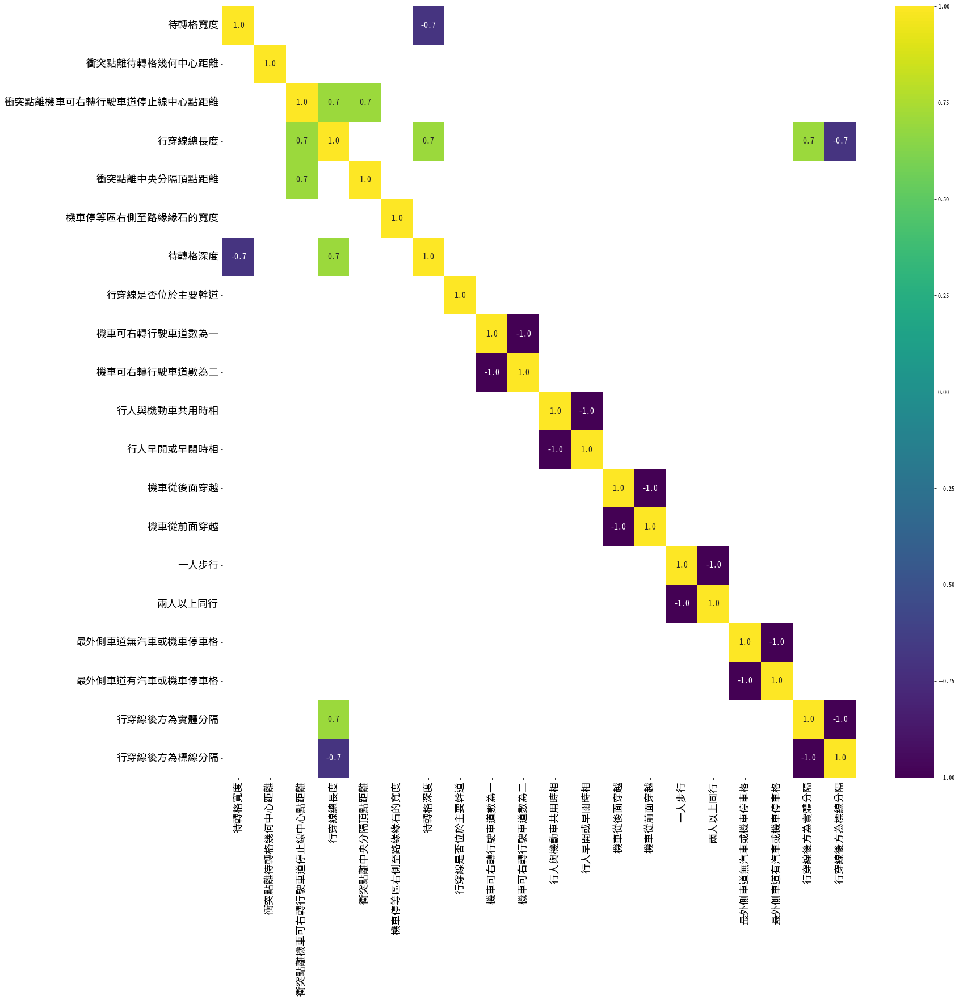

In [126]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線後方是否為標線分隔'])#,'行穿線是否位於主要幹道'

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])
X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

# XGBoost13個變數

In [127]:
new_feature = ['是否機車可右轉行駛車道數為一','機車可右轉行駛車道旁是否有汽車或機車停車格',
              '行人是否有早開或早關時相',
              '待轉格寬度','機車從前面或後面穿越',
              '是否兩人以上同行','衝突點離待轉格幾何中心距離','衝突點離機車可右轉行駛車道停止線中心點距離',
               '行穿線總長度','衝突點離中央分隔頂點距離',
               '行穿線總寬度','行穿線後方是否為標線分隔','機車停等區右側至路緣緣石的寬度'
              ]#'衝突點至行穿線退縮距離臨向右側路口路緣的長度','待轉格深度','行穿線至代轉格的直線距離','行穿線是否位於主要幹道'

# backup_X = X[new_feature].copy()
X = backup_X[new_feature]
len(new_feature)

13

In [128]:
# cat_cols = ['機車從前面或後面穿越','是否機車可右轉行駛車道數為一',
#             '兩人以上同行','行人是否有早開或早關時相','最外側車道是否有汽車或機車停車格',
#            '行穿線後方是否為標線分隔']#'行穿線是否位於主要幹道','是否有超速科技執法','是否有汽車指引線','右轉機車駛入交叉口之車道數是否為一',

cat_cols = ['機車從前面或後面穿越','是否機車可右轉行駛車道數為一',
            '是否兩人以上同行','行人是否有早開或早關時相','機車可右轉行駛車道旁是否有汽車或機車停車格',
           '行穿線後方是否為標線分隔']#'行穿線是否位於主要幹道','是否有超速科技執法','是否有汽車指引線','右轉機車駛入交叉口之車道數是否為一',

### SMOTE + 13個變數 +SHAP

In [129]:
from imblearn.over_sampling import SMOTE
from collections import Counter

# 顯示原始數據的類別分佈
print('Original dataset shape %s' % Counter(y))

# SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

# 顯示經過SMOTE處理後的數據集的類別分佈
print('Resampled dataset shape %s' % Counter(y_res))


Original dataset shape Counter({1: 507, 0: 186, 2: 82})
Resampled dataset shape Counter({2: 507, 1: 507, 0: 507})


### SMOTE後自變數四分位數

In [130]:
X_res.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
是否機車可右轉行駛車道數為一,1521.0,1.418803,0.493525,1.0,1.000000,1.000000,2.0,2.0
機車可右轉行駛車道旁是否有汽車或機車停車格,1521.0,0.760026,0.427208,0.0,1.000000,1.000000,1.0,1.0
行人是否有早開或早關時相,1521.0,0.104536,0.306056,0.0,0.000000,0.000000,0.0,1.0
待轉格寬度,1521.0,4.405578,0.921349,3.1,4.000000,4.291558,4.8,5.9
機車從前面或後面穿越,1521.0,0.387903,0.487432,0.0,0.000000,0.000000,1.0,1.0
是否兩人以上同行,1521.0,0.196581,0.397544,0.0,0.000000,0.000000,0.0,1.0
衝突點離待轉格幾何中心距離,1521.0,6.498798,3.928984,2.0,3.700000,5.279156,8.4,24.0
衝突點離機車可右轉行駛車道停止線中心點距離,1521.0,24.370463,8.316836,13.1,18.500000,21.100000,29.7,47.1
行穿線總長度,1521.0,21.166459,8.286306,13.6,15.100000,16.300000,32.8,34.8
衝突點離中央分隔頂點距離,1521.0,6.275673,3.067123,2.0,4.300000,5.400000,7.1,19.7


### SMOTE後組合變數與風險程度統計(類別型)

In [131]:
merged_data_cat_cols = pd.concat([X_res[cat_cols], y_res], axis=1)

import pandas as pd
result_data = []

for column in X_res[cat_cols].columns:
    variable_values = merged_data_cat_cols[column].unique()
    
    value_counts = merged_data_cat_cols[column].value_counts().to_dict()
    
    value_proportions = {}
    for value, count in value_counts.items():
        proportions = merged_data_cat_cols[merged_data_cat_cols[column] == value]['衝突嚴重程度'].value_counts(normalize=True).to_dict()
        value_proportions[value] = proportions
        
#         proportions_data = {'低衝突風險(%)': round(proportions.get(0, 0) * 100, 2),
#                             '中衝突風險(%)': round(proportions.get(1, 0) * 100, 2),
#                             '高衝突風險(%)': round(proportions.get(2, 0) * 100, 2)}
    
    for value, count in value_counts.items():
        proportions = value_proportions.get(value, {})
        result_data.append({'變數': column, 
                            '變數描述': value,  
                            '衝突風險程度件數': count,
                            **proportions})

result_df = pd.DataFrame(result_data)

result_df.rename(columns={0: '低衝突風險',1: '中衝突風險',2: '高衝突風險'}, inplace=True)

result_df.insert(3, '低衝突風險', result_df.pop('低衝突風險'))

result_df

,變數,變數描述,衝突風險程度件數,低衝突風險,高衝突風險,中衝突風險
0,機車從前面或後面穿越,0,931,0.342642,0.431794,0.225564
1,機車從前面或後面穿越,1,590,0.318644,0.177966,0.503390
2,是否機車可右轉行駛車道數為一,1,884,0.328054,0.487557,0.184389
3,是否機車可右轉行駛車道數為一,2,637,0.340659,0.119309,0.540031
4,是否兩人以上同行,0,1222,0.369885,0.315057,0.315057
5,是否兩人以上同行,1,299,0.183946,0.408027,0.408027
6,行人是否有早開或早關時相,0,1362,0.362702,0.302496,0.334802
7,行人是否有早開或早關時相,1,159,0.081761,0.597484,0.320755
8,機車可右轉行駛車道旁是否有汽車或機車停車格,1,1156,0.286332,0.343426,0.370242
9,機車可右轉行駛車道旁是否有汽車或機車停車格,0,365,0.482192,0.301370,0.216438


  0%|          | 0/152 [00:00<?, ?it/s]

Logistic Regression


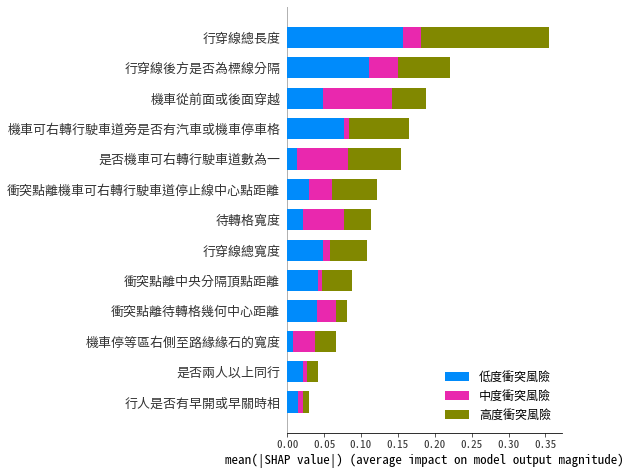

  0%|          | 0/152 [00:00<?, ?it/s]

Support Vector Machine


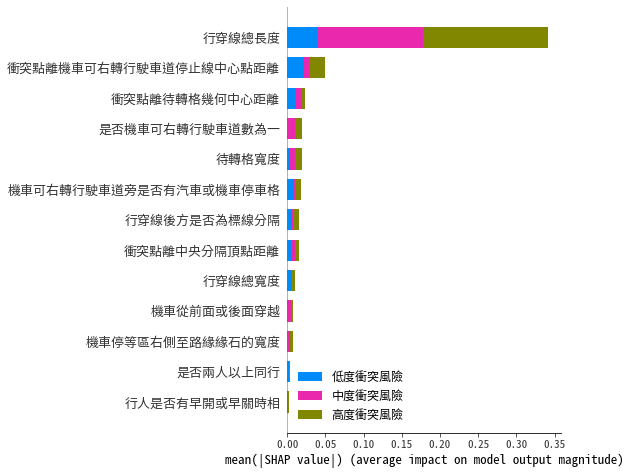

Decision Tree


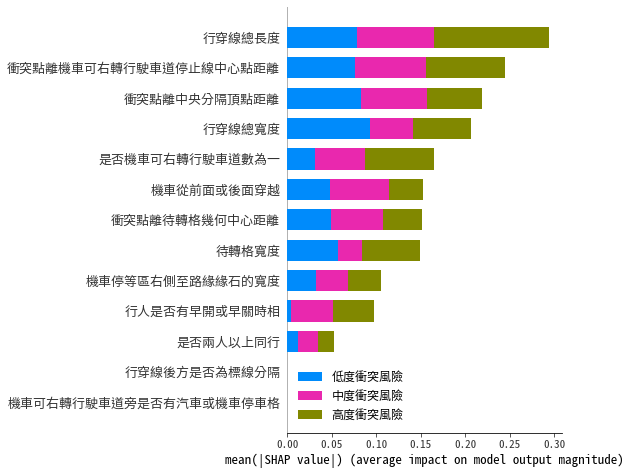

Random Forest


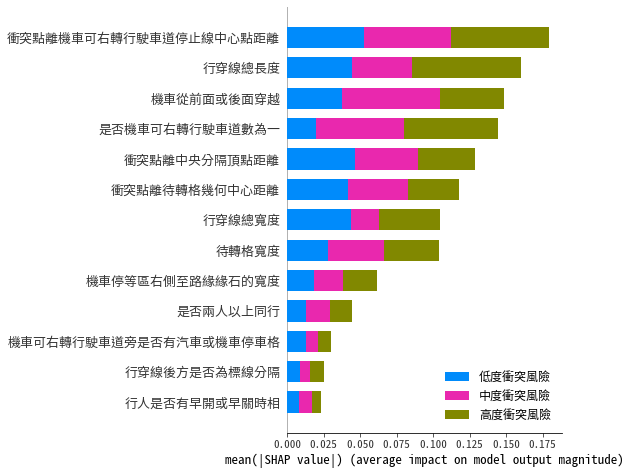

XGBoost


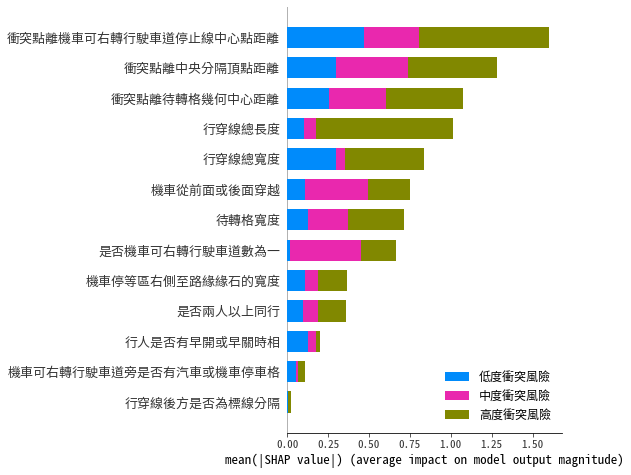


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.596999,0.581380,0.761603,0.591834,0.595643,0.605962,0.595360,0.770863,0.603090,0.605877
1,Support Vector Machine,0.491168,0.406785,0.747048,0.582659,0.493242,0.497771,0.416756,0.755535,0.482128,0.497497
2,Decision Tree,0.733058,0.731726,0.822826,0.734347,0.733178,0.896778,0.896859,0.984335,0.898265,0.896773
3,Random Forest,0.742935,0.740863,0.880998,0.743244,0.742532,0.896778,0.896730,0.978456,0.897093,0.896780
4,XGBoost,0.755427,0.753382,0.887945,0.756272,0.755014,0.895463,0.895410,0.981013,0.895723,0.895472


In [132]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)

results = []
step_results = []

for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res, y_res):
        X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)

    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    

    
results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [133]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.562092,0.552444,0.736367,0.578953,0.583269,0.613304,0.600243,0.774261,0.611556,0.611333
1,Logistic Regression,0.572368,0.554393,0.699871,0.561388,0.570770,0.618700,0.608709,0.778410,0.616766,0.618975
2,Logistic Regression,0.657895,0.630512,0.799577,0.636828,0.639815,0.591673,0.582366,0.762294,0.589378,0.593192
3,Logistic Regression,0.565789,0.554233,0.782548,0.557548,0.564462,0.600438,0.590234,0.767992,0.596907,0.600450
4,Logistic Regression,0.605263,0.600889,0.772758,0.618751,0.607183,0.613587,0.602053,0.771672,0.609850,0.613356
5,Logistic Regression,0.578947,0.556138,0.759785,0.573081,0.575784,0.598247,0.588807,0.769584,0.595313,0.598634
6,Logistic Regression,0.592105,0.584650,0.747831,0.591289,0.602279,0.607743,0.596796,0.772648,0.603896,0.606687
7,Logistic Regression,0.618421,0.614627,0.786600,0.621528,0.634362,0.610665,0.599793,0.773258,0.607776,0.609115
8,Logistic Regression,0.631579,0.583170,0.768929,0.588148,0.584747,0.595325,0.587041,0.772424,0.595507,0.599533
9,Logistic Regression,0.585526,0.582745,0.761764,0.590821,0.593757,0.609934,0.597555,0.766086,0.603949,0.607500


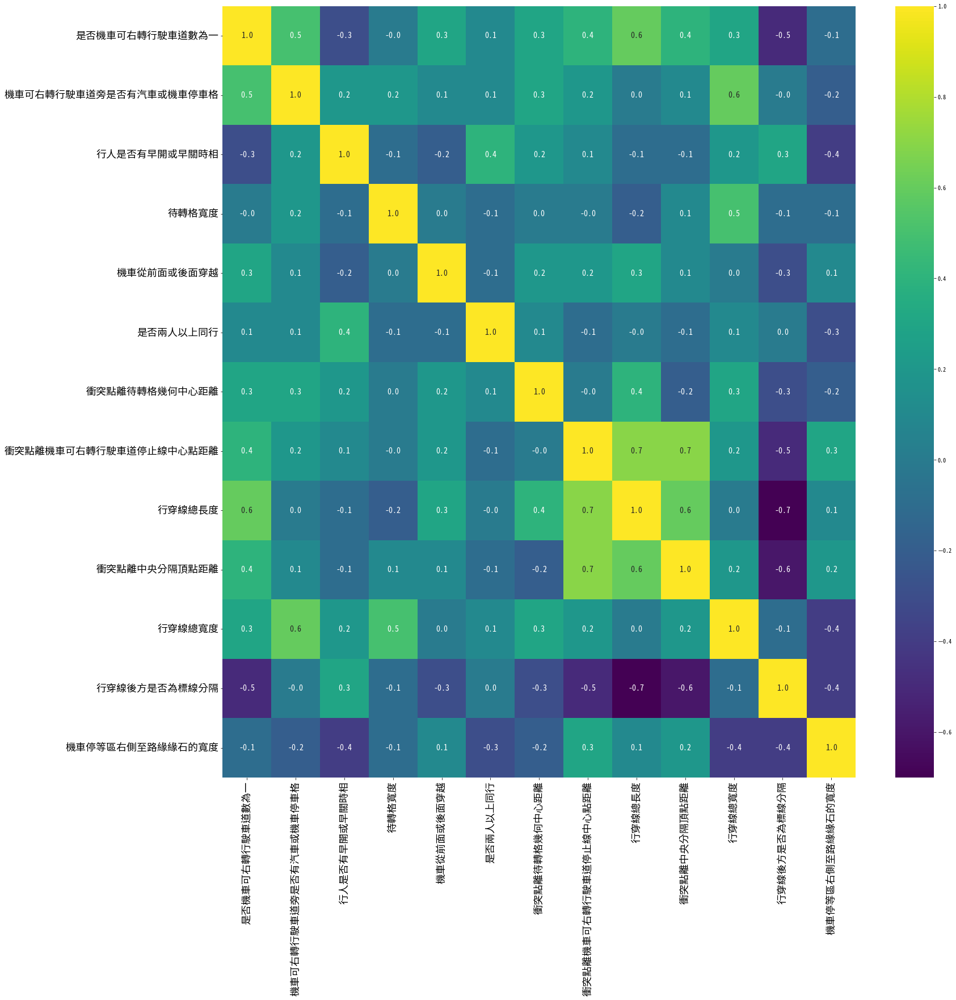

In [134]:
from scipy.stats import spearmanr


correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

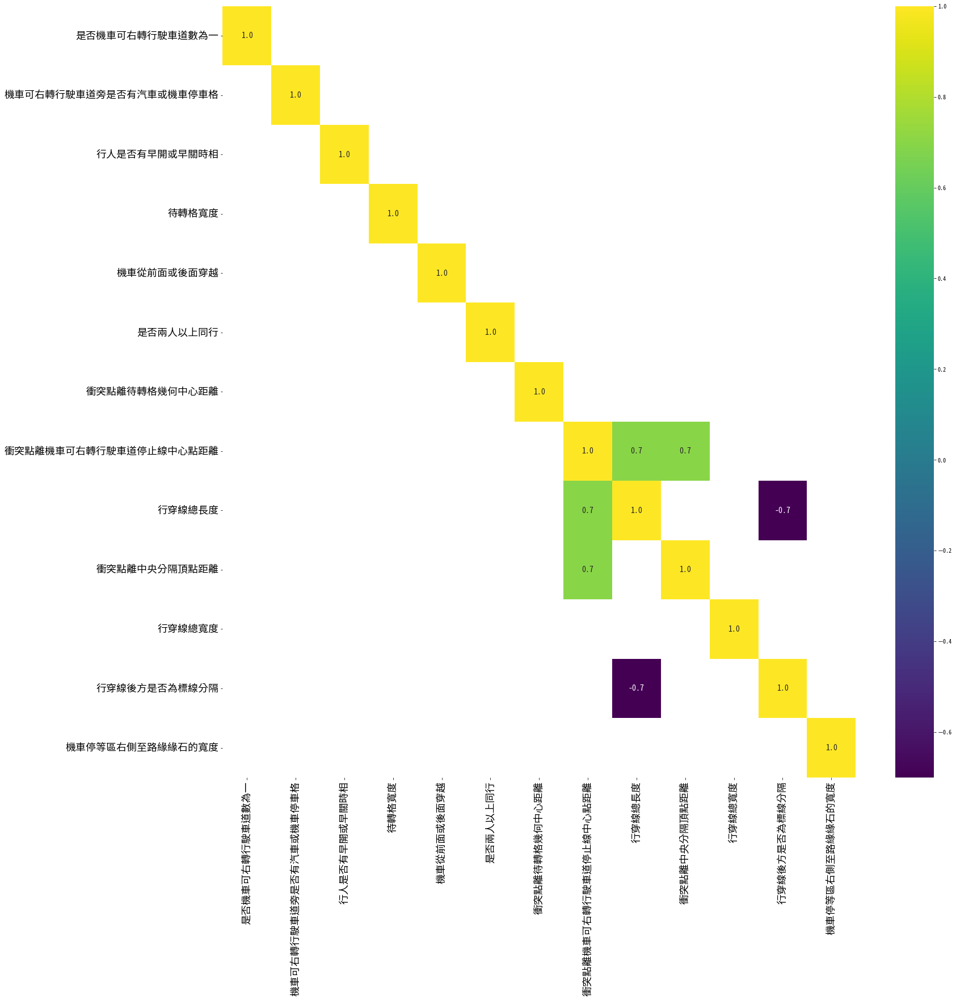

In [135]:
from scipy.stats import spearmanr

correlation_matrix, _ = spearmanr(X_res)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res.columns, columns=X_res.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

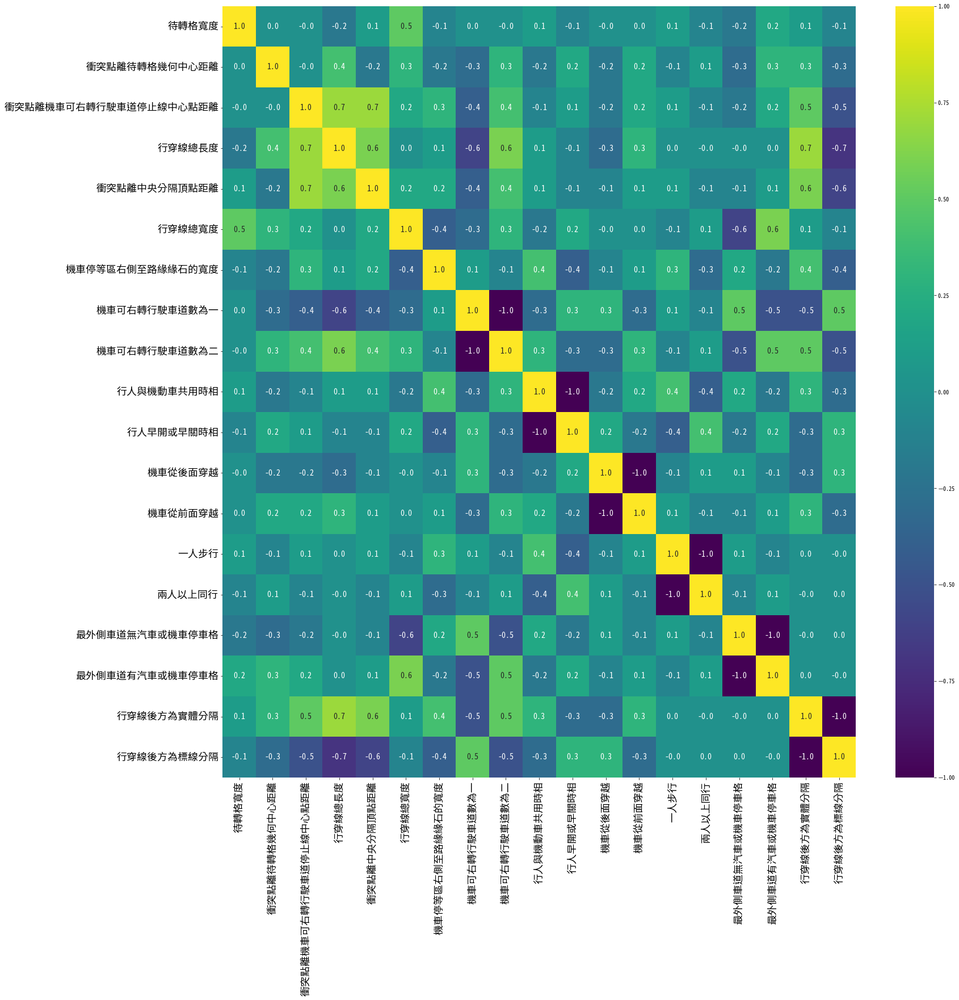

In [136]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線後方是否為標線分隔'])#,'行穿線是否位於主要幹道'

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

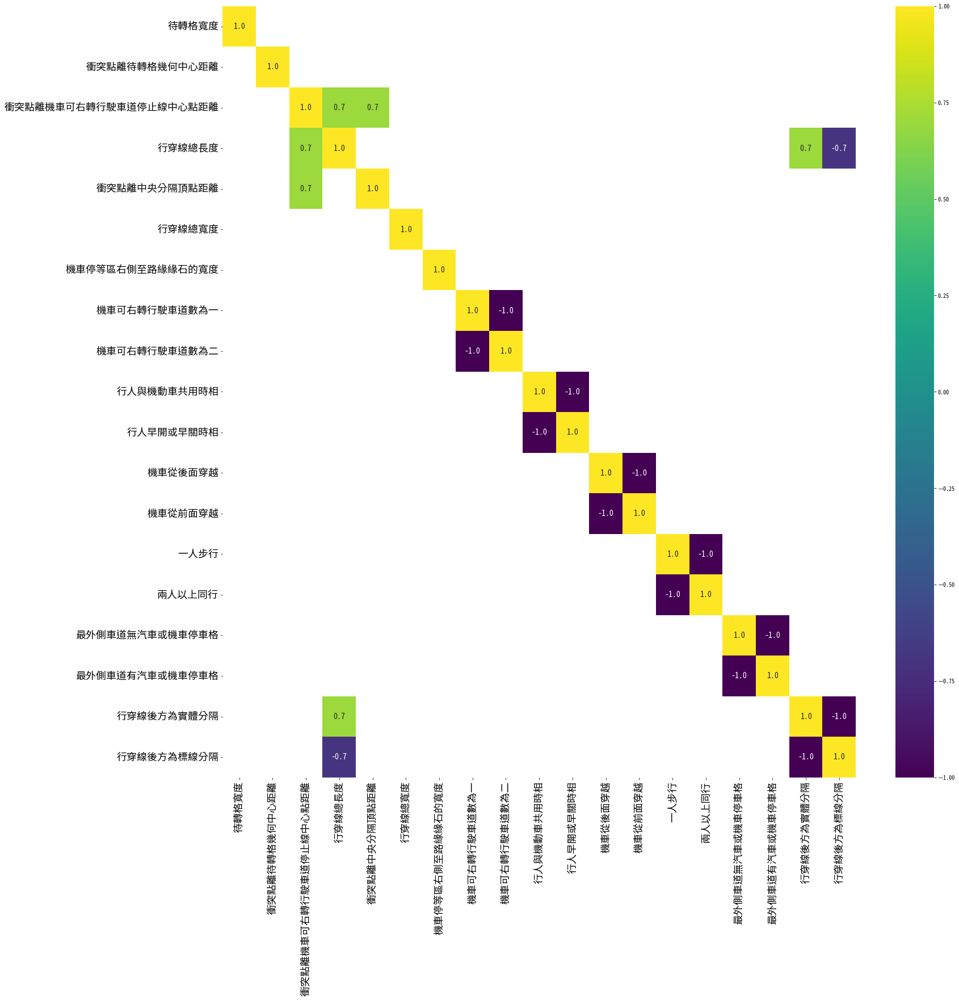

In [137]:
from scipy.stats import spearmanr
X_res_tmp = pd.get_dummies(X_res, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相','機車從前面或後面穿越','是否兩人以上同行',
                                          '機車可右轉行駛車道旁是否有汽車或機車停車格','行穿線後方是否為標線分隔'])#,'行穿線是否位於主要幹道'

X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_1': '機車可右轉行駛車道數為一'}, inplace=True)
X_res_tmp.rename(columns={'是否機車可右轉行駛車道數為一_2': '機車可右轉行駛車道數為二'}, inplace=True)

X_res_tmp.rename(columns={'行人是否有早開或早關時相_0': '行人與機動車共用時相'}, inplace=True)
X_res_tmp.rename(columns={'行人是否有早開或早關時相_1': '行人早開或早關時相'}, inplace=True)

X_res_tmp.rename(columns={'機車從前面或後面穿越_0': '機車從後面穿越'}, inplace=True)
X_res_tmp.rename(columns={'機車從前面或後面穿越_1': '機車從前面穿越'}, inplace=True)

X_res_tmp.rename(columns={'是否兩人以上同行_0': '一人步行'}, inplace=True)
X_res_tmp.rename(columns={'是否兩人以上同行_1': '兩人以上同行'}, inplace=True)

X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_0': '最外側車道無汽車或機車停車格'}, inplace=True)
X_res_tmp.rename(columns={'機車可右轉行駛車道旁是否有汽車或機車停車格_1': '最外側車道有汽車或機車停車格'}, inplace=True)

# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_0': '行穿線位於次要幹道'}, inplace=True)
# X_res_tmp.rename(columns={'行穿線是否位於主要幹道_1': '行穿線位於主要幹道'}, inplace=True)

X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_0': '行穿線後方為實體分隔'}, inplace=True)
X_res_tmp.rename(columns={'行穿線後方是否為標線分隔_1': '行穿線後方為標線分隔'}, inplace=True)

'''
1.是否機車可右轉行駛車道為一 :
機車可行駛車道數為一 -1
機車可行駛車道數為二 -2

2.行人是否有早開或早關時相
行人早開或早關時相 -1
行人與機動車共用時相 -0

3.機車從前面或後面穿越 
機車從後面穿越 -0
機車從前面穿越 -1

4.兩人是否同行 
一人步行 -0
兩人以上同行-1 

5.最外側車道是否有汽車或機車停車格
最外側車道有汽車或機車停車格-1
最外側車道無汽車或機車停車格-0

6.行穿線是否位於主要幹道
行穿線位於主要幹道-1
行穿線位於次要幹道-0
'''

correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

### SMOTE後 precision/recall roc 圖

第1次測試結果


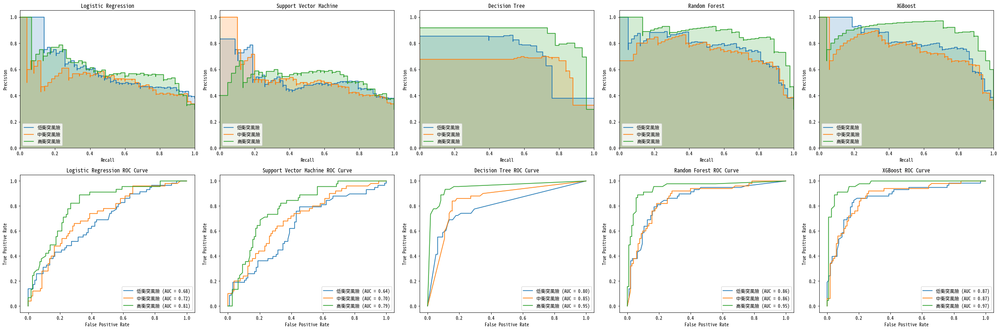

第2次測試結果


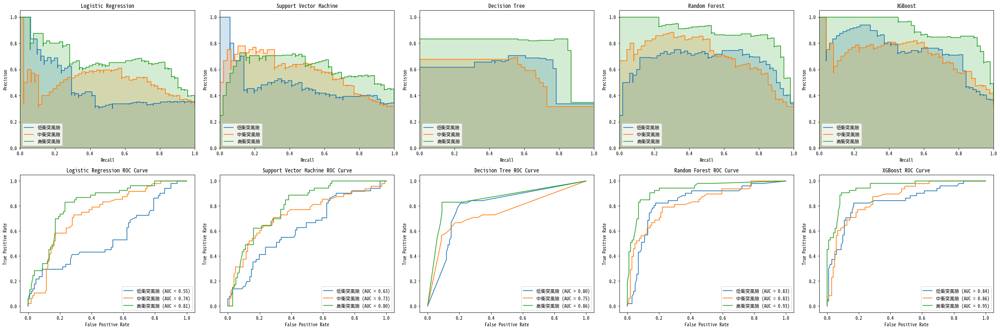

第3次測試結果


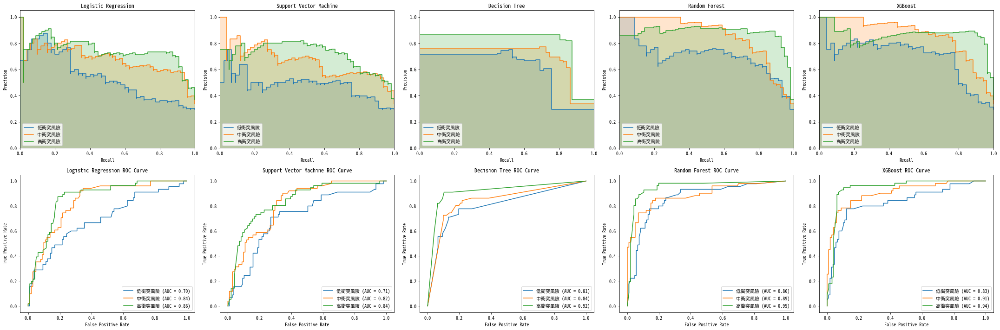

第4次測試結果


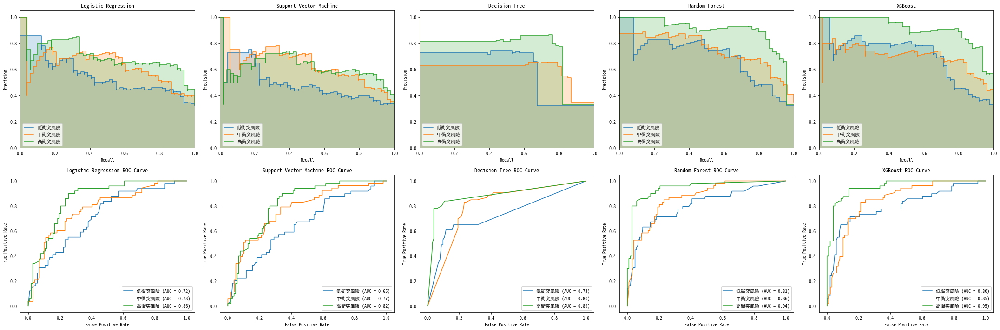

第5次測試結果


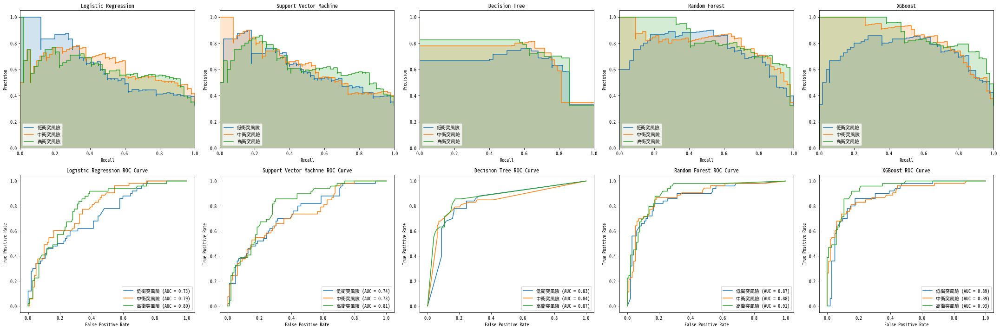

第6次測試結果


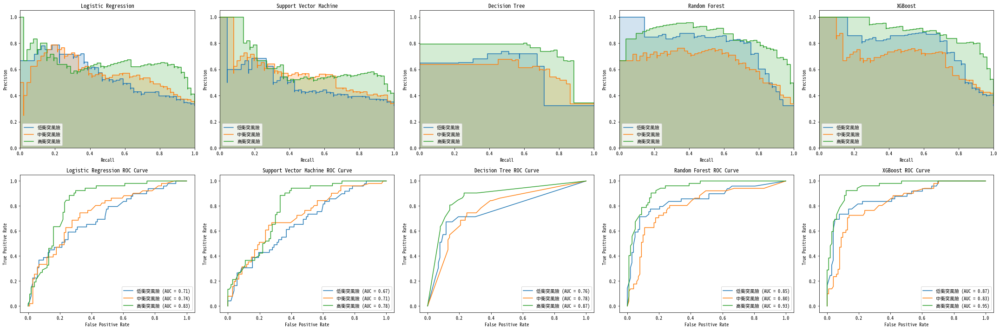

第7次測試結果


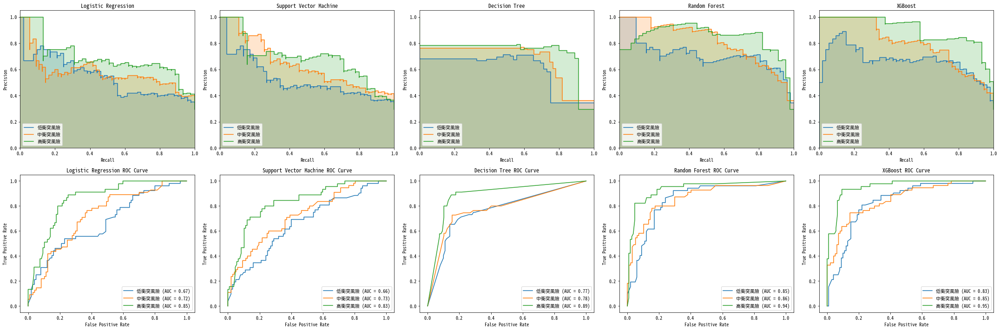

第8次測試結果


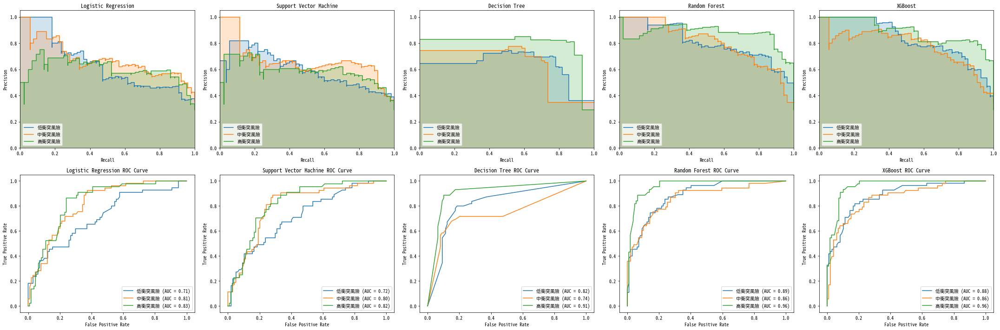

第9次測試結果


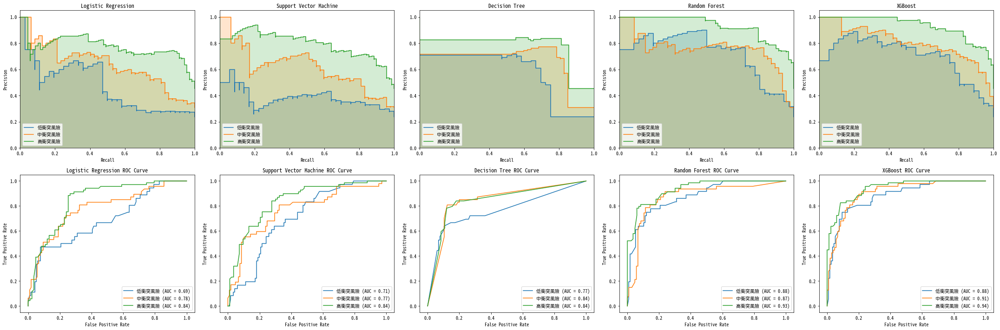

第10次測試結果


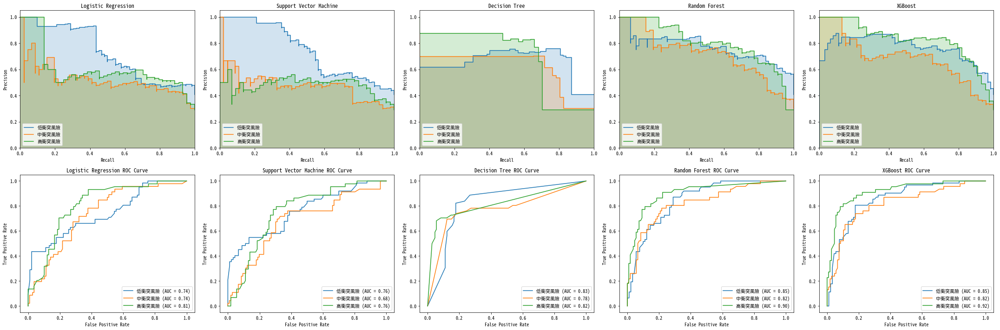

In [51]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix
from sklearn.metrics import precision_recall_curve, roc_curve, auc
import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}


def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)
        
step = 1
for train_index, test_index in split_data(X_res, y_res):
    X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
    y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]
    plt.figure(figsize=(30, 10))
    print(f'第{step}次測試結果')
    step+=1
    i = 1
    for name, model_fn in models.items():
        plt.subplot(2, 5, i)
        model = model_fn(X_train, y_train)
        y_scores = model.predict_proba(X_test)
        
        precision = dict()
        recall = dict()
        for j in range(len(model.classes_)):
            y_true_class_j = (y_test == j).astype(int)
            precision[j], recall[j], _ = precision_recall_curve(y_true_class_j, y_scores[:, j])
        for j, label in enumerate(["低衝突風險", "中衝突風險", "高衝突風險"]):
            plt.step(recall[j], precision[j], where='post', label=label)
            plt.fill_between(recall[j], precision[j], step='post', alpha=0.2)
        plt.title(name)
        plt.xlabel('Recall')
        plt.ylabel('Precision')
        plt.ylim([0.0, 1.05])
        plt.xlim([0.0, 1.0])
        plt.legend(loc='lower left')
        i+=1
        
    i = 1    
    for name, model_fn in models.items():
        plt.subplot(2, 5, i+5)
        model = model_fn(X_train, y_train)
        y_scores = model.predict_proba(X_test)
        
        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        for j in range(len(model.classes_)):
            y_true_class_j = (y_test == j).astype(int)
            fpr[j], tpr[j], _ = roc_curve(y_true_class_j, y_scores[:, j])
            roc_auc[j] = auc(fpr[j], tpr[j])
        for j, label in enumerate(["低衝突風險", "中衝突風險", "高衝突風險"]):
            plt.plot(fpr[j], tpr[j], label=f'{label} (AUC = {roc_auc[j]:0.2f})')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'{name} ROC Curve')
        plt.legend(loc='lower right') 
        i+=1
        
    plt.tight_layout()
    plt.show()

### 所有變數與風險程度的分布

In [138]:
merged_data = pd.concat([X_res, y_res], axis=1)

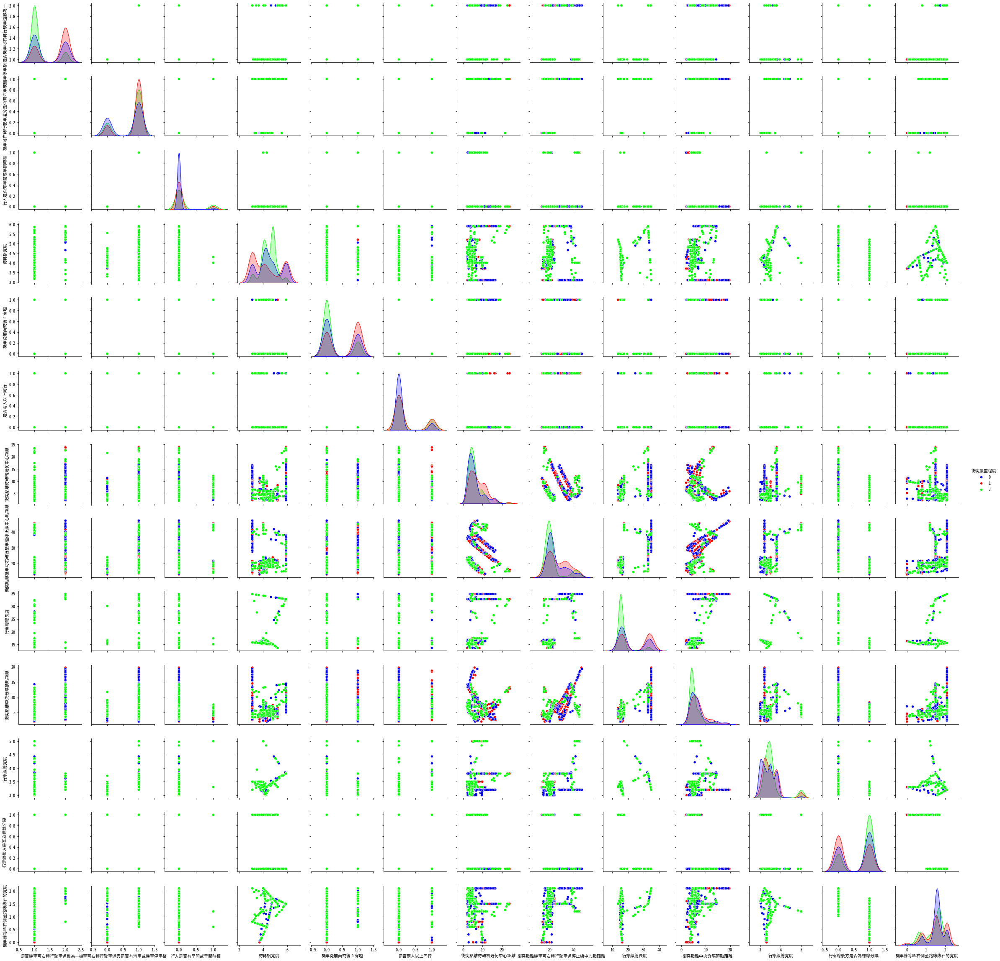

In [139]:
import warnings

# 忽略特定類型的警告
warnings.filterwarnings("ignore", category=UserWarning)


#warning 跑有夠久
sns.pairplot(merged_data,hue='衝突嚴重程度',palette = ["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"])#藍(低)、紅(中)、綠(高)
plt.show()

# some attempts

待轉格寬度: <待轉格寬度3.9-4.85m為高風險衝突>

衝突點離待轉格幾何中心距離: <4.85m以下衝突點離待轉格幾何中心距離為高風險衝突>

衝突點右轉機車離最外側車道停止線中心點: <衝突點右轉機車離最外側車道停止線中心點13-18.5m為高風險衝突>

行穿線總長度 : <行穿線總長度11-17.5m為高風險衝突>

衝突點離中央分隔島頂點距離: <衝突點離中央分隔島頂點距離2.5-6m為高風險衝突>

行穿線總寬度: <行穿線總寬度3.2-3.5m為高風險衝突>

右轉機車可行駛的車道路肩寬度: <右轉機車可行駛的車道路肩寬度1.4-1.8m為高風險衝突>

--

待轉格寬度: <待轉格寬度2.5-3m為中風險衝突>

衝突點離代轉格幾何中心距離: <衝突點離代轉格幾何中心距離6-11m為中風險衝突>

衝突點右轉機車離最外側車道停止線中心點: <衝突點右轉機車離最外側車道停止線中心點29-35m為中風險衝突>

行穿線總長度 : <行穿線總長度30-35m為中風險衝突>

衝突點離中央分隔島頂點距離: <衝突點離中央分隔島頂點距離10-13m為中風險衝突>

行穿線總寬度: <行穿線總寬2.8-3.1m為中風險衝突>

右轉機車可行駛的車道路肩寬度: <右轉機車可行駛的車道路肩寬度2-2.2m為中風險衝突>

In [140]:
#1、0測試
X_res_tmp = X_res.copy()

#下降
# X_res_tmp['待轉格寬度3.9-4.85m為高風險衝突'] = np.where((X_res['待轉格寬度'] <= 4.85) & (3.9 <= X_res['待轉格寬度']), 1, 0)

#一樣
# X_res_tmp['4.85m以下衝突點離待轉格幾何中心距離為高風險衝突'] = np.where((X_res['衝突點離待轉格幾何中心距離'] <= 4.85), 1, 0)

#上升
# X_res_tmp['衝突點右轉機車離最外側車道停止線的中心點距離13-18.5m為高風險衝突'] = np.where((X_res['衝突點右轉機車離最外側車道停止線的中心點距離'] <= 18.5) & (13 <= X_res['衝突點右轉機車離最外側車道停止線的中心點距離']), 1, 0)

#一樣
# X_res_tmp['行穿線總長度11-17.5m為高風險衝突'] = np.where((X_res['行穿線總長度'] <= 17.5) & (11 <= X_res['行穿線總長度']), 1, 0)

#下降
# X_res_tmp['衝突點離中央分隔島頂點距離2.5-6m為高風險衝突'] = np.where((X_res['衝突點離中央分隔島頂點距離'] <= 6) & (2.5 <= X_res['衝突點離中央分隔島頂點距離']), 1, 0)

#上升
# X_res_tmp['行穿線總寬度3.2-3.5m為高風險衝突'] = np.where((X_res['行穿線總寬度'] <= 3.5) & (3.2 <= X_res['行穿線總寬度']), 2, 0)

#上升
X_res_tmp['機車停等區右側至路緣緣石的寬度1.4-1.8m為高風險衝突'] = np.where((X_res['機車停等區右側至路緣緣石的寬度'] <= 1.8) & (1.4 <= X_res['機車停等區右側至路緣緣石的寬度']), 2, 999)

#---------------------------------
#上升
X_res_tmp['衝突點離機車可右轉行駛車道停止線中心點距離27m-37m不為高風險衝突'] = np.where((X_res['衝突點離機車可右轉行駛車道停止線中心點距離'] <= 37) & (27 <= X_res['衝突點離機車可右轉行駛車道停止線中心點距離']), 1, 0)


# X_res_tmp['衝突點離中央分隔島頂點距離17-20m為低風險衝突'] = np.where((X_res['衝突點離中央分隔島頂點距離'] <= 20) & (17 <= X_res['衝突點離中央分隔島頂點距離']), 1, 0)

#---------------------------------
#上升
# X_res_tmp['待轉格寬度2.5-3m為中風險衝突'] = np.where((X_res['待轉格寬度'] <= 3) & (2.5 <= X_res['待轉格寬度']), 1, 0)

#上升
# X_res_tmp['衝突點離待轉格幾何中心距離6-11m為中風險衝突'] = np.where((X_res['衝突點離待轉格幾何中心距離'] <= 11) & (6 <= X_res['衝突點離待轉格幾何中心距離']), 1, 0)

#一樣
# X_res_tmp['衝突點右轉機車離最外側車道停止線的中心點距離29-35m為中風險衝突'] = np.where((X_res['衝突點右轉機車離最外側車道停止線的中心點距離'] <= 35) & (29 <= X_res['衝突點右轉機車離最外側車道停止線的中心點距離']), 1, 0)

#上升
# X_res_tmp['行穿線總長度30-35m為中風險衝突'] = np.where((X_res['行穿線總長度'] <= 35) & (30 <= X_res['行穿線總長度']), 1, 0)

#上升
# X_res_tmp['衝突點離中央分隔島頂點距離10-13m為中風險衝突'] = np.where((X_res['衝突點離中央分隔島頂點距離'] <= 13) & (10 <= X_res['衝突點離中央分隔島頂點距離']), 1, 0)

#上升
# X_res_tmp['行穿線總寬2.8-3.1m為中風險衝突'] = np.where((X_res['行穿線總寬度'] <= 3.1) & (2.8 <= X_res['行穿線總寬度']), 1, 0)

#上升
# X_res_tmp['右轉機車可行駛的車道路肩寬度2-2.2m為中風險衝突'] = np.where((X_res['右轉機車可行駛的車道路肩寬度'] <= 2.2) & (2 <= X_res['右轉機車可行駛的車道路肩寬度']), 1, 999)


  0%|          | 0/152 [00:00<?, ?it/s]

Logistic Regression


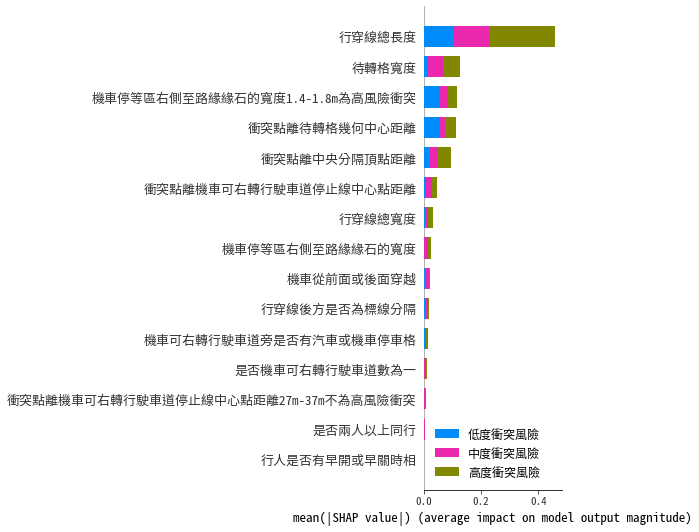

  0%|          | 0/152 [00:00<?, ?it/s]

Support Vector Machine


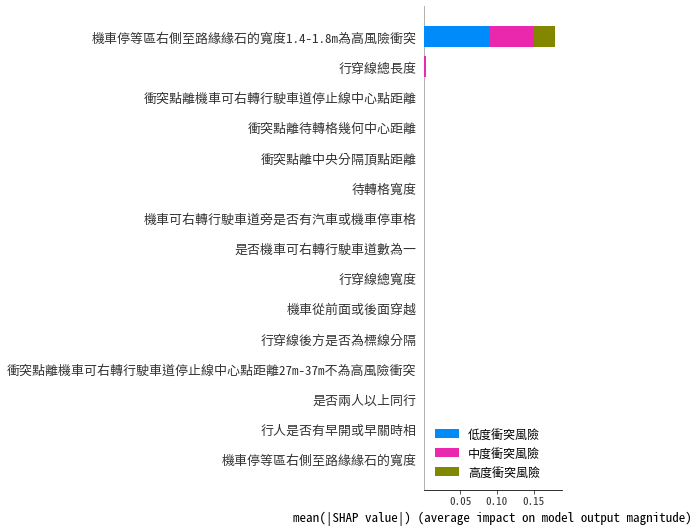

Decision Tree


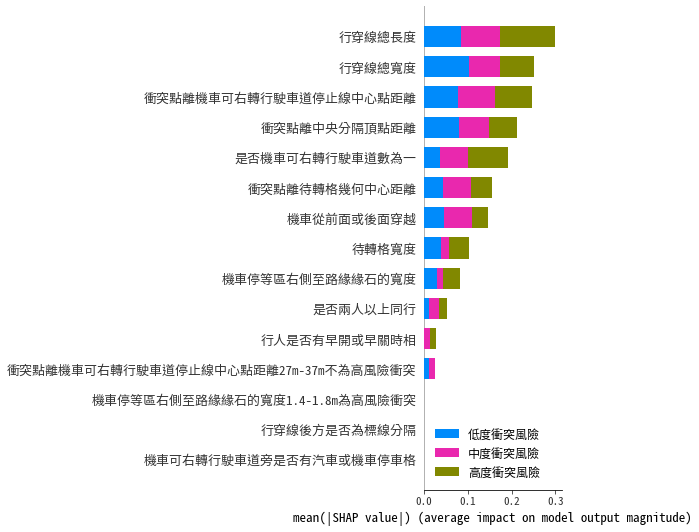

Random Forest


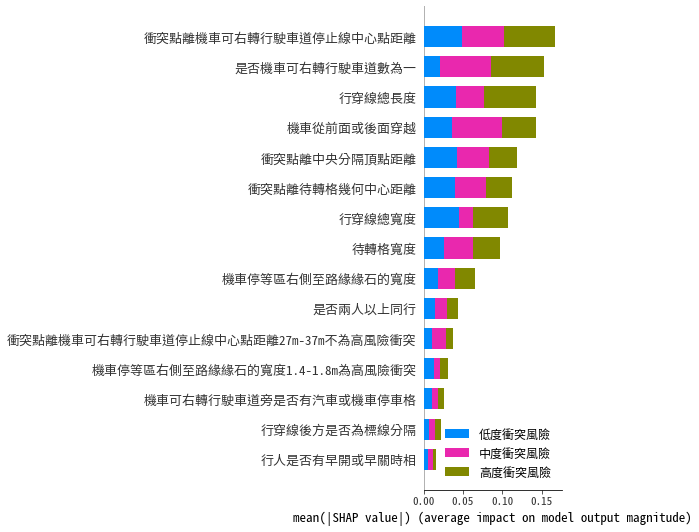

XGBoost


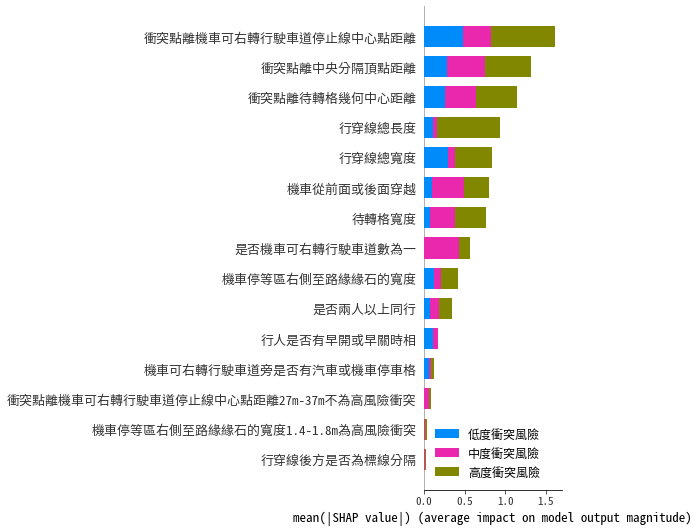


Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.570038,0.551473,0.732530,0.572950,0.569206,0.570751,0.556196,0.737269,0.575228,0.570703
1,Support Vector Machine,0.416809,0.331524,0.658422,0.611507,0.417125,0.416831,0.332702,0.660662,0.610894,0.416832
2,Decision Tree,0.729777,0.728110,0.819693,0.730504,0.729328,0.896778,0.896859,0.984335,0.898265,0.896773
3,Random Forest,0.742922,0.740589,0.881407,0.742221,0.742518,0.896778,0.896737,0.978374,0.897213,0.896779
4,XGBoost,0.759370,0.757210,0.888315,0.760085,0.759050,0.895902,0.895844,0.981073,0.896161,0.895907


In [141]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)

results = []
step_results = []

for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res_tmp, y_res):
        X_train, X_test = X_res_tmp.iloc[train_index], X_res_tmp.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)
    
    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    
    if (name == 'Logistic Regression'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_poly_log = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_poly_log = explainer_poly_log.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_poly_log, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")


    if (name == 'Support Vector Machine'):
        # 使用 KernelExplainer 計算 SHAP 值
        explainer_svm = shap.KernelExplainer(model.predict_proba, shap.kmeans(X_train, 10))
        shap_values_svm = explainer_svm.shap_values(X_test)

        # 繪製 SHAP 值
        print(name)
        shap.summary_plot(shap_values_svm, X_test,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original',plot_type="bar")

        
    if (name != 'Logistic Regression') and (name != 'Support Vector Machine') and (name != 'Gradient Boosting'):
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        print(name)
        shap_summary = shap.summary_plot(shap_values, X_train,class_names={0:'低度衝突風險', 1:'中度衝突風險', 2:'高度衝突風險'},class_inds='original')
    

    
results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df


In [142]:
step_results_df

,Model,Test Accuracy(10 fold),Test F1(10 fold),Test AUC(10 fold),Test Precision(10 fold),Test Recall(10 fold),Train Accuracy(10 fold),Train F1(10 fold),Train AUC(10 fold),Train Precision(10 fold),Train Recall(10 fold)
0,Logistic Regression,0.542484,0.534724,0.696444,0.570068,0.561430,0.578216,0.564354,0.731406,0.579492,0.576379
1,Logistic Regression,0.539474,0.506092,0.691383,0.522376,0.535061,0.577794,0.564668,0.731812,0.584268,0.578394
2,Logistic Regression,0.611842,0.590638,0.784046,0.608456,0.597261,0.550767,0.531433,0.736527,0.556503,0.552460
3,Logistic Regression,0.592105,0.584958,0.728533,0.594455,0.593454,0.555880,0.548987,0.730581,0.554991,0.555720
4,Logistic Regression,0.519737,0.511237,0.733132,0.534817,0.524154,0.563915,0.545710,0.742614,0.572606,0.563460
5,Logistic Regression,0.578947,0.550012,0.746428,0.593424,0.575800,0.571950,0.553999,0.743835,0.581266,0.572413
6,Logistic Regression,0.539474,0.531885,0.709745,0.539745,0.550751,0.573411,0.559079,0.734986,0.573201,0.571769
7,Logistic Regression,0.572368,0.563972,0.734453,0.582672,0.592310,0.577794,0.563681,0.734255,0.578635,0.575947
8,Logistic Regression,0.651316,0.602754,0.767593,0.614761,0.601124,0.574872,0.564949,0.742689,0.583834,0.580112
9,Logistic Regression,0.552632,0.538462,0.733540,0.568726,0.560712,0.582907,0.565101,0.743980,0.587487,0.580382


### 特徵創建後的新增特徵之新相關係數圖

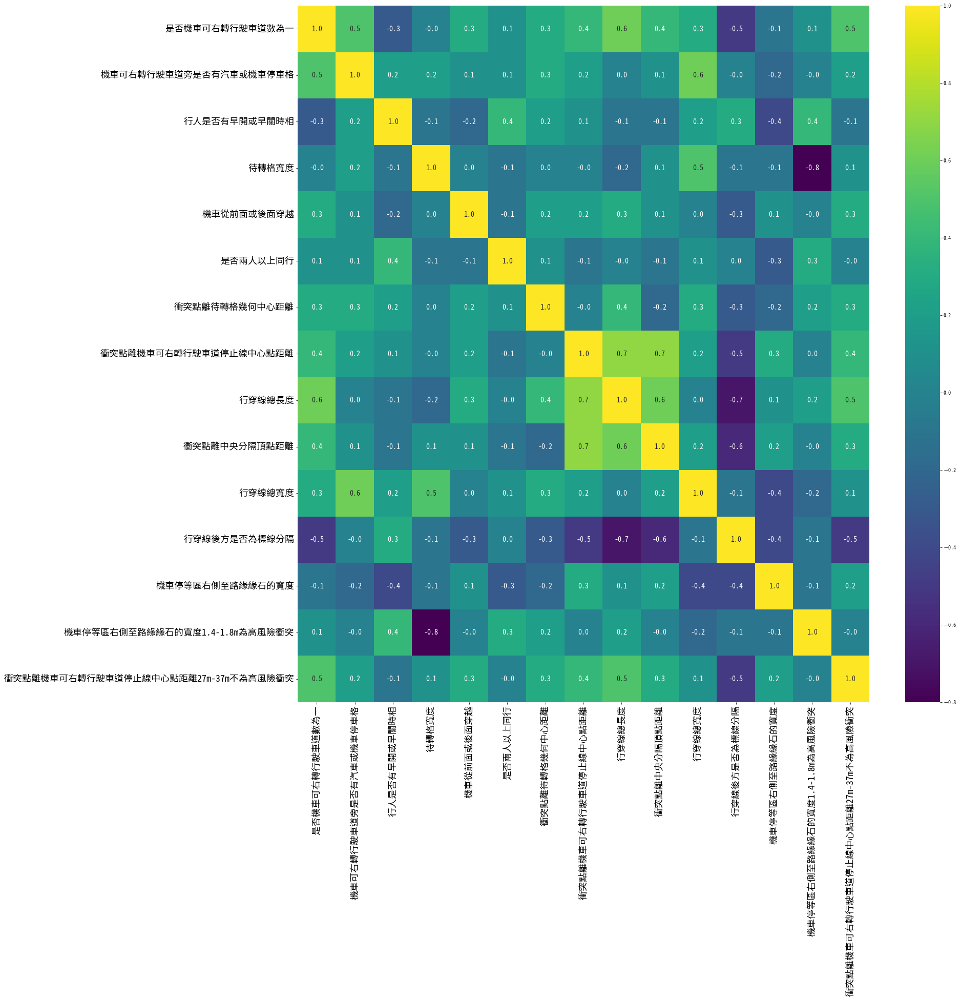

In [143]:
correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis', annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

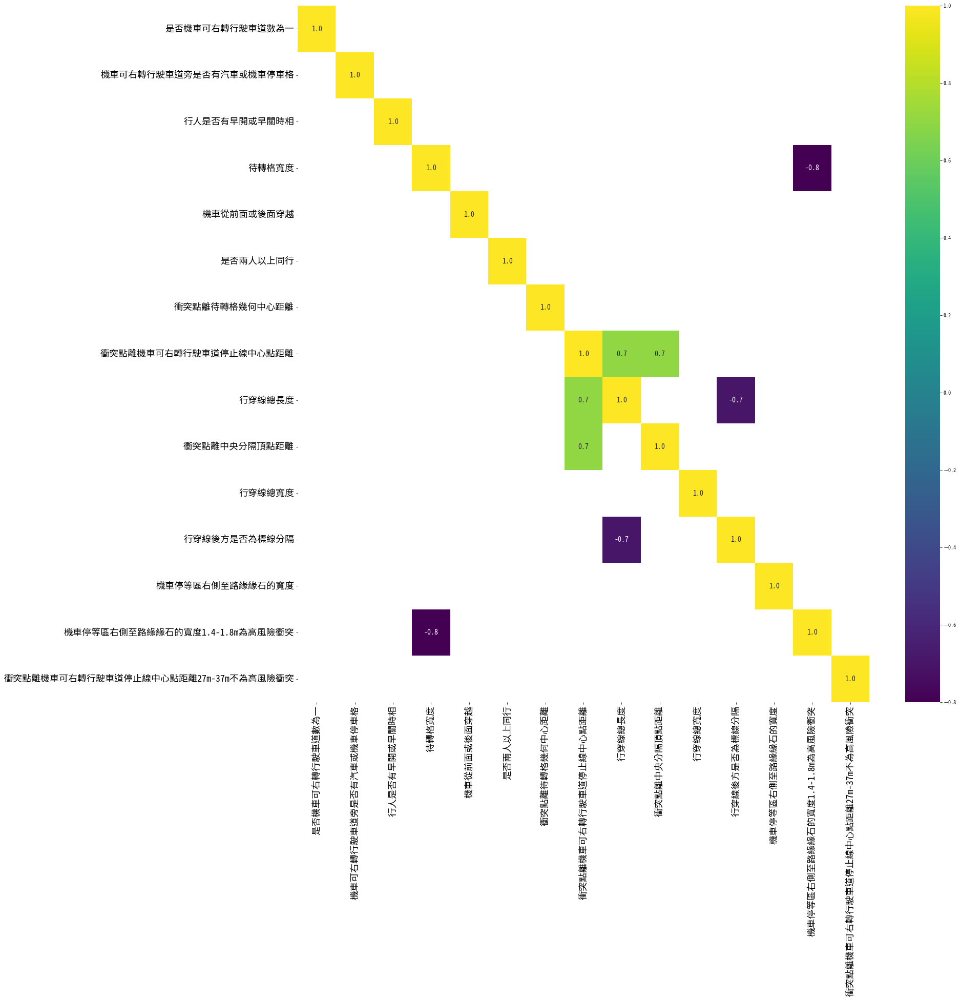

In [144]:
correlation_matrix, _ = spearmanr(X_res_tmp)
correlation_df = pd.DataFrame(correlation_matrix, index=X_res_tmp.columns, columns=X_res_tmp.columns)


fig = plt.figure(figsize=(25,25))
gs = fig.add_gridspec(1,1)
gs.update(wspace=0.3, hspace=0.15)
ax = fig.add_subplot(gs[0,0])

X_corr = correlation_df.round(1)
sns.heatmap(X_corr,fmt=".1f",annot=True,cmap='viridis',mask=((X_corr<0.7) & (X_corr>-0.7)), annot_kws={"fontsize": 14})
ax.tick_params(axis='x', labelsize=18)
ax.tick_params(axis='y', labelsize=18)
plt.show()

### 特徵工程後取7個變數的XGB高風險詳細shap

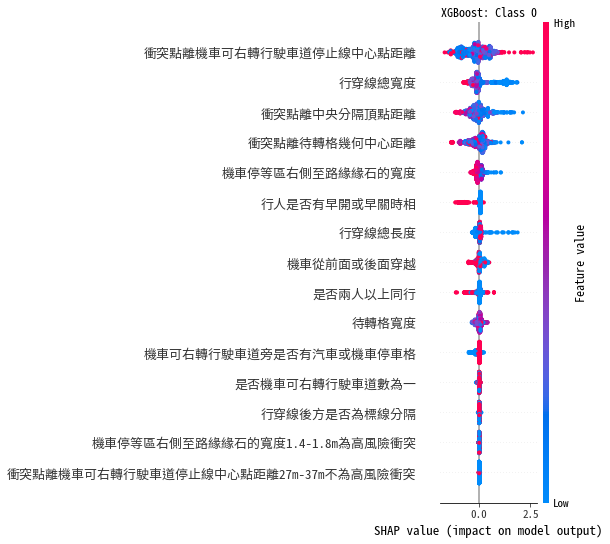

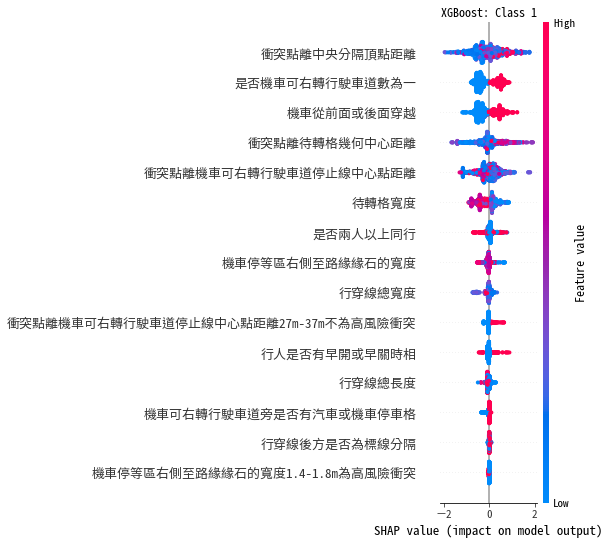

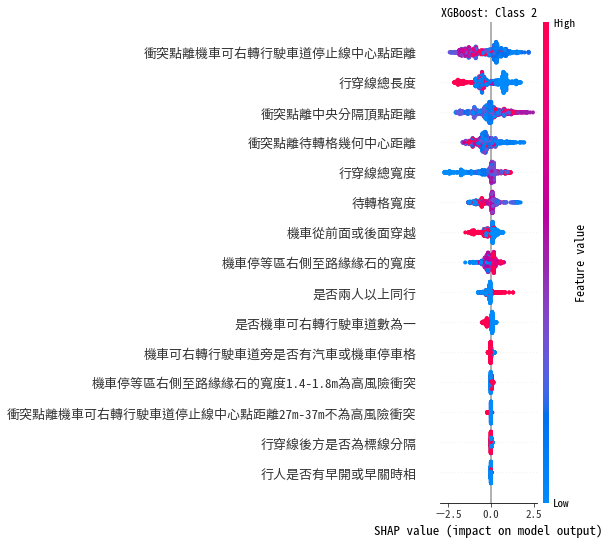

In [147]:
for i in range(len(np.unique(y_train))):
    shap.summary_plot(shap_values[i], X_train, feature_names=X_train.columns, title=f"XGBoost: Class {i}", show=False)
    plt.title(f"XGBoost: Class {i}")
    plt.show()

In [148]:
# 找出 SHAP 值對應的特徵名稱
shap_feature_names = X_train.columns[np.argsort(np.abs(shap_values[2]).mean(axis=0))[::-1]]
print("\nSHAP Feature Names:")
print(shap_feature_names)
list(shap_feature_names)


SHAP Feature Names:
Index(['衝突點離機車可右轉行駛車道停止線中心點距離', '行穿線總長度', '衝突點離中央分隔頂點距離', '衝突點離待轉格幾何中心距離',
       '行穿線總寬度', '待轉格寬度', '機車從前面或後面穿越', '機車停等區右側至路緣緣石的寬度', '是否兩人以上同行',
       '是否機車可右轉行駛車道數為一', '機車可右轉行駛車道旁是否有汽車或機車停車格',
       '機車停等區右側至路緣緣石的寬度1.4-1.8m為高風險衝突', '衝突點離機車可右轉行駛車道停止線中心點距離27m-37m不為高風險衝突',
       '行穿線後方是否為標線分隔', '行人是否有早開或早關時相'],
      dtype='object')


['衝突點離機車可右轉行駛車道停止線中心點距離',
 '行穿線總長度',
 '衝突點離中央分隔頂點距離',
 '衝突點離待轉格幾何中心距離',
 '行穿線總寬度',
 '待轉格寬度',
 '機車從前面或後面穿越',
 '機車停等區右側至路緣緣石的寬度',
 '是否兩人以上同行',
 '是否機車可右轉行駛車道數為一',
 '機車可右轉行駛車道旁是否有汽車或機車停車格',
 '機車停等區右側至路緣緣石的寬度1.4-1.8m為高風險衝突',
 '衝突點離機車可右轉行駛車道停止線中心點距離27m-37m不為高風險衝突',
 '行穿線後方是否為標線分隔',
 '行人是否有早開或早關時相']

In [151]:
# # 用來查找的 list
# lookup_list = list(shap_feature_names)

# # 需要被查找的 list
# # target_list = ['衝突點右轉機車離最外側車道停止線的中心點距離','衝突點離中央分隔島頂點距離',
# #                '衝突點離待轉格幾何中心距離','行穿線總寬度','待轉格寬度','行穿線總長度','右轉機車可行駛的車道路肩寬度']

# target_list = list(shap_feature_names)


# for item in target_list:
#     if item in lookup_list:
#         index = lookup_list.index(item)
#         x = X_train[item]
#         y = shap_values[2][:,index]

#         plt.scatter(x,y)
#         plt.title(f"XGBoost: 高衝突風險\n{item}")
#         plt.ylabel("SHAP Value")
#         plt.xlabel(f"{item}")
# #         plt.show()
#         filename = f'./image_high_FE_vs_shap_value/Left_{item}.png'
#         plt.savefig(filename)
#         plt.clf()
#     else:
#         print(f"'{item}' 不在用來查找的 list 中")


<Figure size 432x288 with 0 Axes>

In [152]:
# 載入資料
def load_data(csv_file):
    data = pd.read_csv(csv_file,encoding='big5')
    data = data[data['行人性別'] != '不確定']
    X = data.drop(columns=['衝突嚴重程度'])  # 將目標變數以外的特徵當作 X
    y = data['衝突嚴重程度']  # 目標變數當作 y
    return X, y

# 切分資料集
def split_data(X, y, test_size=0.2):
    return train_test_split(X, y, test_size=test_size, random_state=42)

# 邏輯回歸模型
def logistic_regression(X_train, y_train):
    model = LogisticRegression()
    model.fit(X_train, y_train)
    return model

# 支持向量機模型
def support_vector_machine(X_train, y_train):
    model = SVC(probability=True)
    model.fit(X_train, y_train)
    return model

# 決策樹模型
def decision_tree(X_train, y_train):
    model = DecisionTreeClassifier()#random_state=42,max_depth=4
    model.fit(X_train, y_train)
    return model

# 隨機森林模型
def random_forest(X_train, y_train):
    model = RandomForestClassifier()#random_state=42,n_estimators=50,max_depth=3
    model.fit(X_train, y_train)
    return model

# XGBoost 模型
def xgboost_model(X_train, y_train):
    model = xgb.XGBClassifier(objective ='multi:softmax', num_class=len(np.unique(y_train)),n_estimators=500,eta=0.7)#, random_state=42
    model.fit(X_train, y_train)
    return model

In [153]:
import pandas as pd
import shap
import xgboost as xgb
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.model_selection import KFold
from sklearn.metrics import accuracy_score
import numpy as np
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix

import warnings
from sklearn.exceptions import ConvergenceWarning

# 忽略收斂警告
warnings.filterwarnings("ignore", category=ConvergenceWarning)

models = {
    'Logistic Regression': logistic_regression,
    'Support Vector Machine': support_vector_machine,
    'Decision Tree': decision_tree,
    'Random Forest': random_forest,
    'XGBoost' : xgboost_model
}

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)

results = []
step_results = []

for name, model_fn in models.items():
    accuracy_scores = []
    f1 = []
    auc = []
    precision = []
    recall = []
    
    train_accuracy_scores = []
    train_f1 = []
    train_auc = []
    train_precision = []
    train_recall = []
    
    for train_index, test_index in split_data(X_res_tmp, y_res):
        X_train, X_test = X_res_tmp.iloc[train_index], X_res_tmp.iloc[test_index]
        y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]

        model = model_fn(X_train, y_train)
        
        train_y_pred = model.predict(X_train)
        
        train_f1_tmp = f1_score(y_train, train_y_pred, average='macro')
        train_accuracy_tmp = accuracy_score(y_train, train_y_pred)
        
        train_accuracy_scores.append(train_accuracy_tmp)
        train_f1.append(train_f1_tmp)
        
        #auc
        y_pred_proba_train = model.predict_proba(X_train)
        train_auc_tmp = roc_auc_score(y_train, y_pred_proba_train, multi_class='ovr')
        train_auc.append(train_auc_tmp)
        
        #precision
        train_precision_tmp = precision_score(y_train, train_y_pred, average='macro', zero_division=1)
        train_precision.append(train_precision_tmp)

        #recall
        train_recall_tmp = recall_score(y_train, train_y_pred, average='macro')
        train_recall.append(train_recall_tmp)
        
        
        y_pred = model.predict(X_test)
        
        accuracy_tmp = accuracy_score(y_test, y_pred)
        f1_tmp = f1_score(y_test, y_pred, average='macro')
        
        f1.append(f1_tmp)
        accuracy_scores.append(accuracy_tmp)

        #auc
        y_pred_proba = model.predict_proba(X_test)
        auc_tmp = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
        auc.append(auc_tmp)
        
        #precision
        precision_tmp = precision_score(y_test, y_pred, average='macro', zero_division=1)
        precision.append(precision_tmp)

        #recall
        recall_tmp = recall_score(y_test, y_pred, average='macro')
        recall.append(recall_tmp)
        
        
        step_results.append({'Model': name, 
                            'Test Accuracy(10 fold)': accuracy_tmp,
                            'Test F1(10 fold)': f1_tmp,
                            'Test AUC(10 fold)': auc_tmp,
                            'Test Precision(10 fold)': precision_tmp,
                            'Test Recall(10 fold)': recall_tmp,
                            'Train Accuracy(10 fold)': train_accuracy_tmp,
                            'Train F1(10 fold)': train_f1_tmp,
                            'Train AUC(10 fold)': train_auc_tmp,
                            'Train Precision(10 fold)': train_precision_tmp,
                            'Train Recall(10 fold)': train_recall_tmp})
        

    mean_accuracy_final = np.mean(accuracy_scores)
    mean_f1_final = np.mean(f1)
    mean_auc_final = np.mean(auc)
    mean_precision_final = np.mean(precision)
    mean_recall_final = np.mean(recall)
    
    mean_train_accuracy_scores_final = np.mean(train_accuracy_scores)
    mean_train_f1_final = np.mean(train_f1)
    mean_train_auc_final = np.mean(train_auc)
    mean_train_precision_final = np.mean(train_precision)
    mean_train_recall_final = np.mean(train_recall)
    
    results.append({'Model': name, 
                    'Test Accuracy(mean)': mean_accuracy_final,
                    'Test F1(mean)': mean_f1_final,
                    'Test AUC(mean)': mean_auc_final,
                    'Test Precision(mean)': mean_precision_final,
                    'Test Recall(mean)': mean_recall_final,
                    'Train Accuracy(mean)': mean_train_accuracy_scores_final,
                    'Train F1(mean)': mean_train_f1_final,
                    'Train AUC(mean)': mean_train_auc_final,
                    'Train Precision(mean)': mean_train_precision_final,
                    'Train Recall(mean)': mean_train_recall_final})
    


results_df = pd.DataFrame(results)

step_results_df = pd.DataFrame(step_results)

print("\nFinal results")
results_df



Final results


,Model,Test Accuracy(mean),Test F1(mean),Test AUC(mean),Test Precision(mean),Test Recall(mean),Train Accuracy(mean),Train F1(mean),Train AUC(mean),Train Precision(mean),Train Recall(mean)
0,Logistic Regression,0.570038,0.551473,0.732530,0.572950,0.569206,0.570751,0.556196,0.737269,0.575228,0.570703
1,Support Vector Machine,0.416809,0.331524,0.659702,0.611507,0.417125,0.416831,0.332702,0.660739,0.610894,0.416832
2,Decision Tree,0.726479,0.724734,0.816605,0.728115,0.725729,0.896778,0.896859,0.984335,0.898265,0.896773
3,Random Forest,0.753461,0.752573,0.883009,0.755085,0.754094,0.896778,0.896723,0.978421,0.897161,0.896782
4,XGBoost,0.763962,0.761841,0.879815,0.764232,0.763397,0.896413,0.896363,0.984219,0.896624,0.896405


第1次測試結果


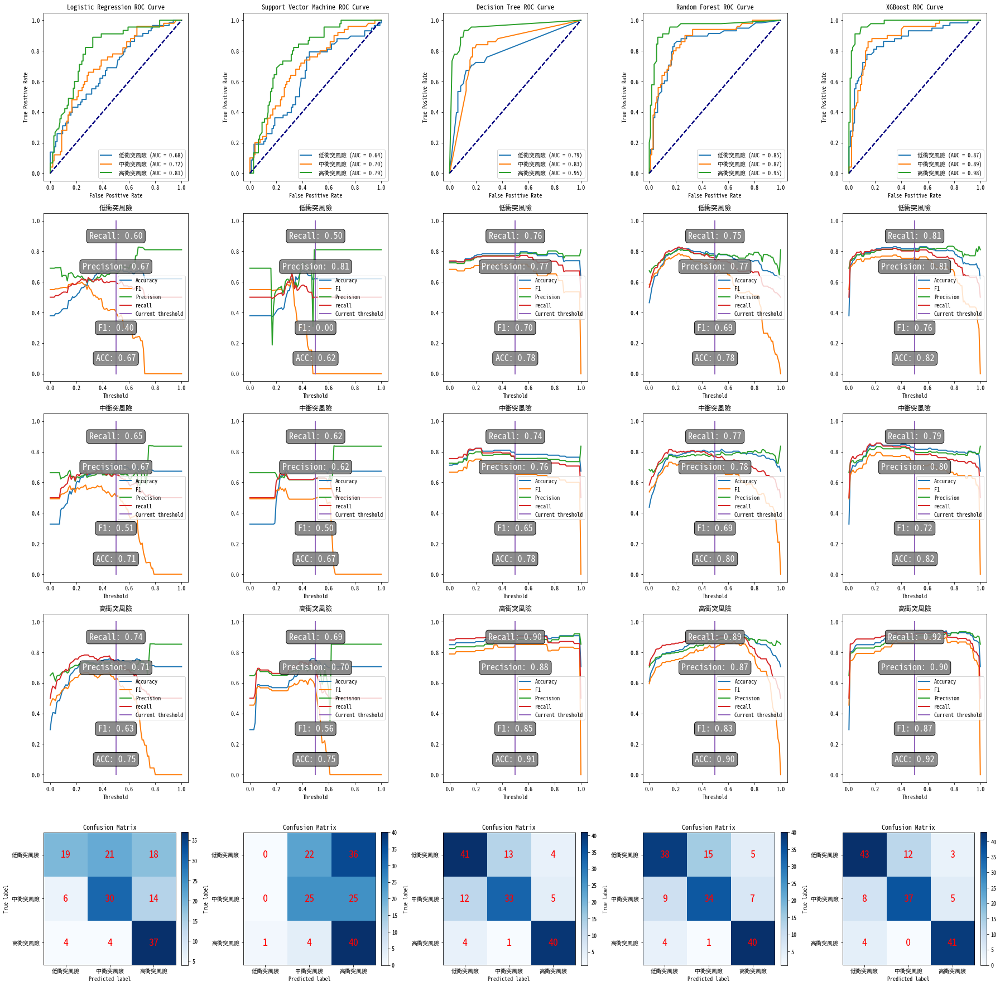

第2次測試結果


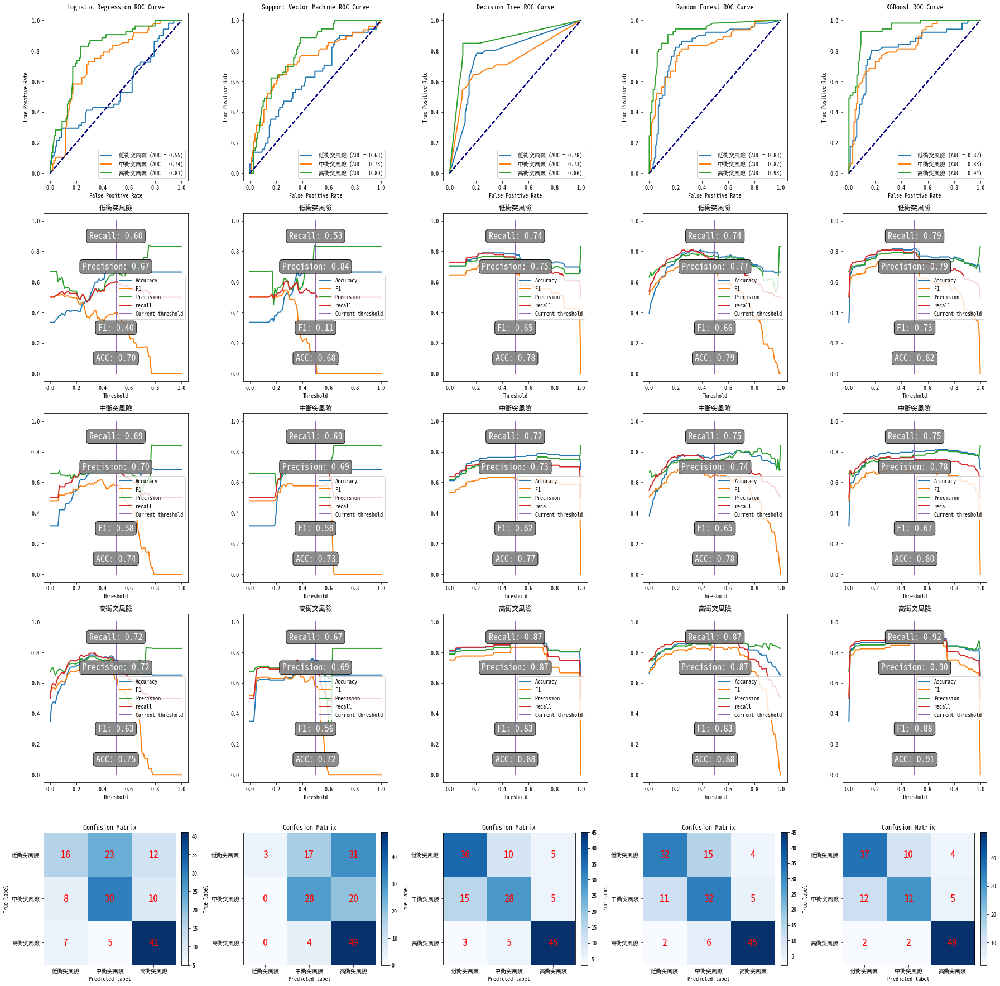

第3次測試結果


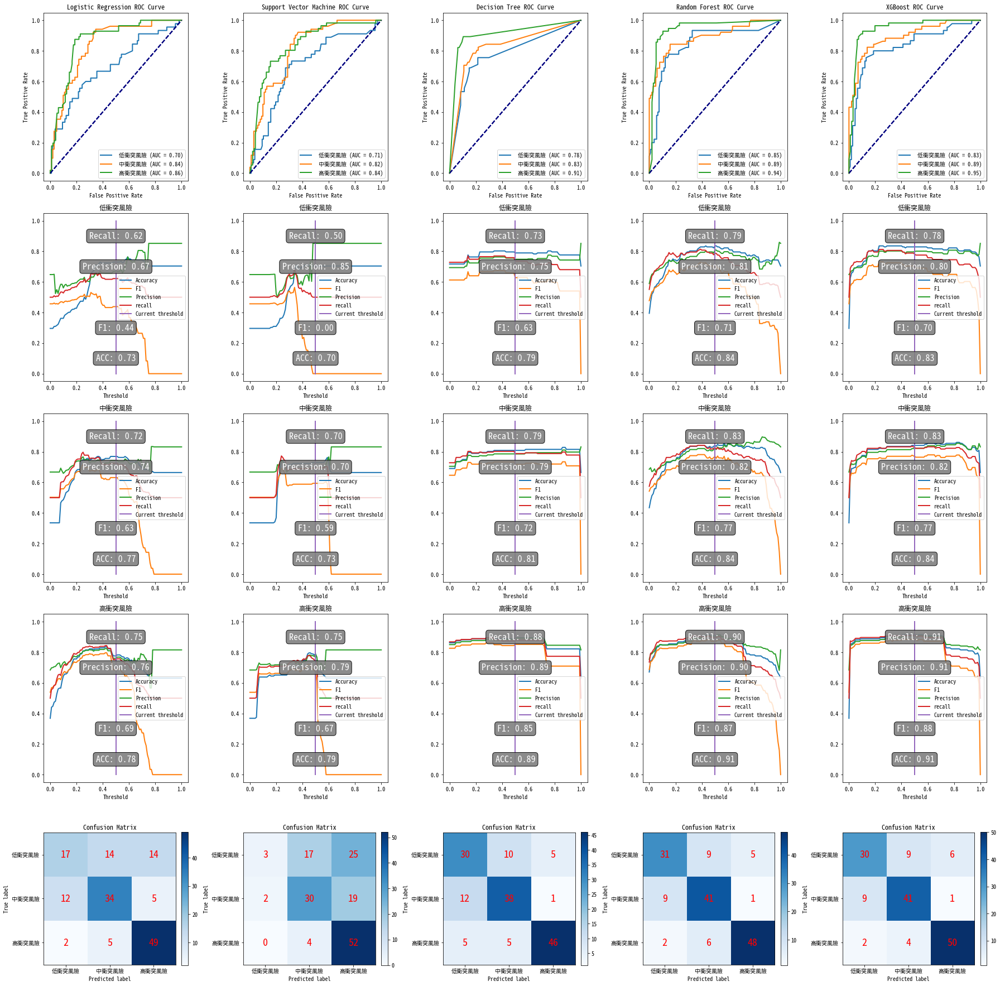

第4次測試結果


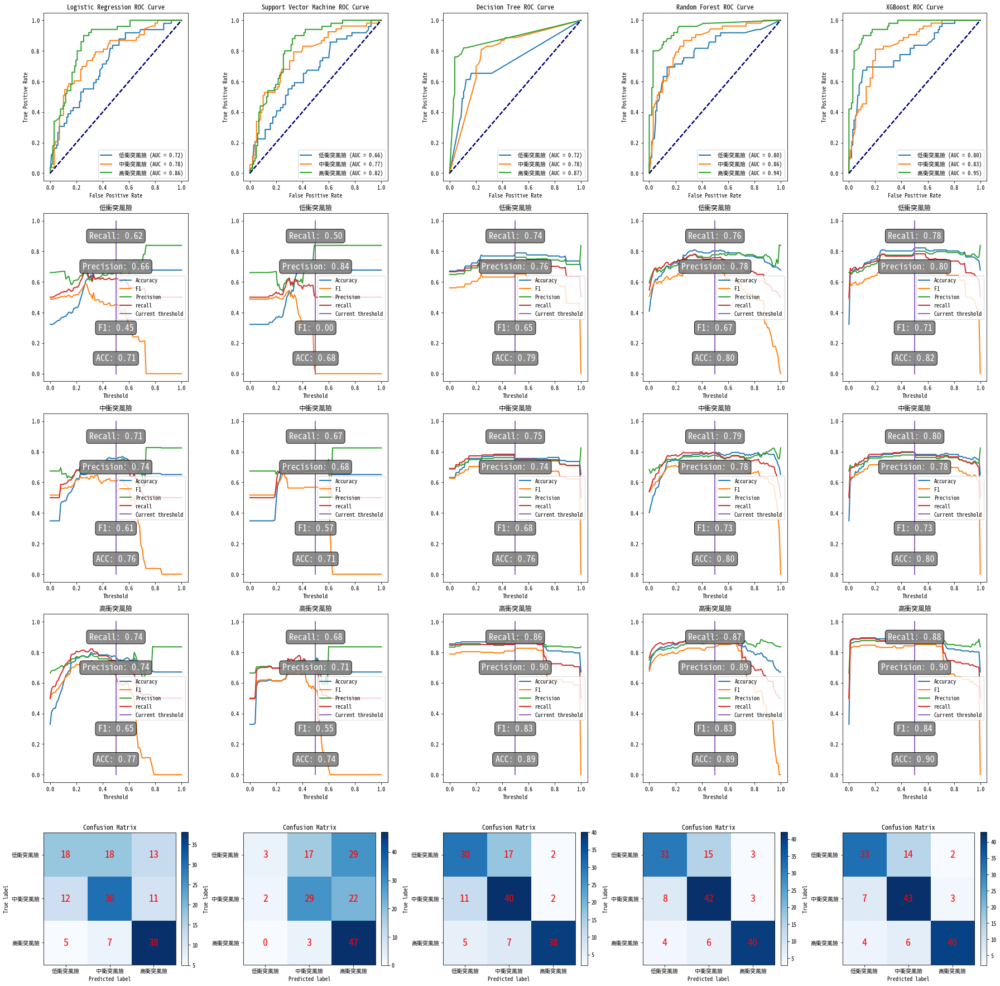

第5次測試結果


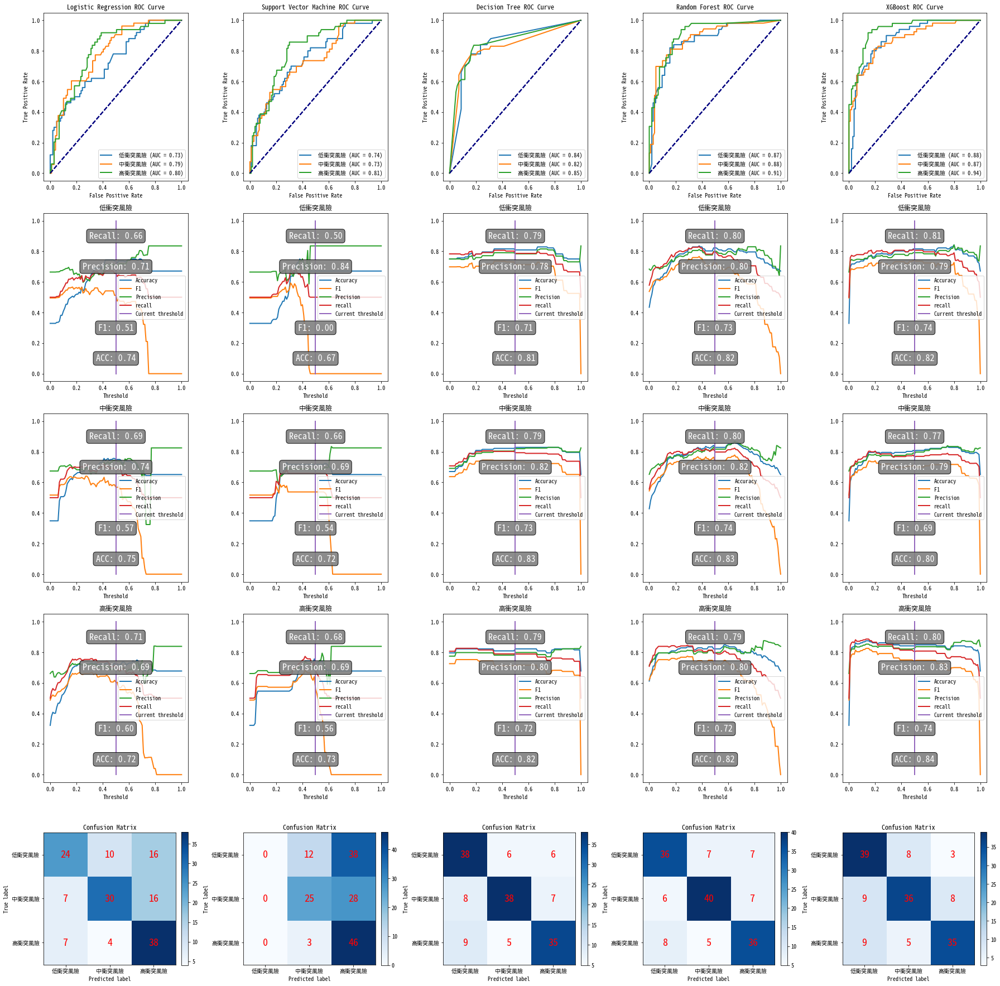

第6次測試結果


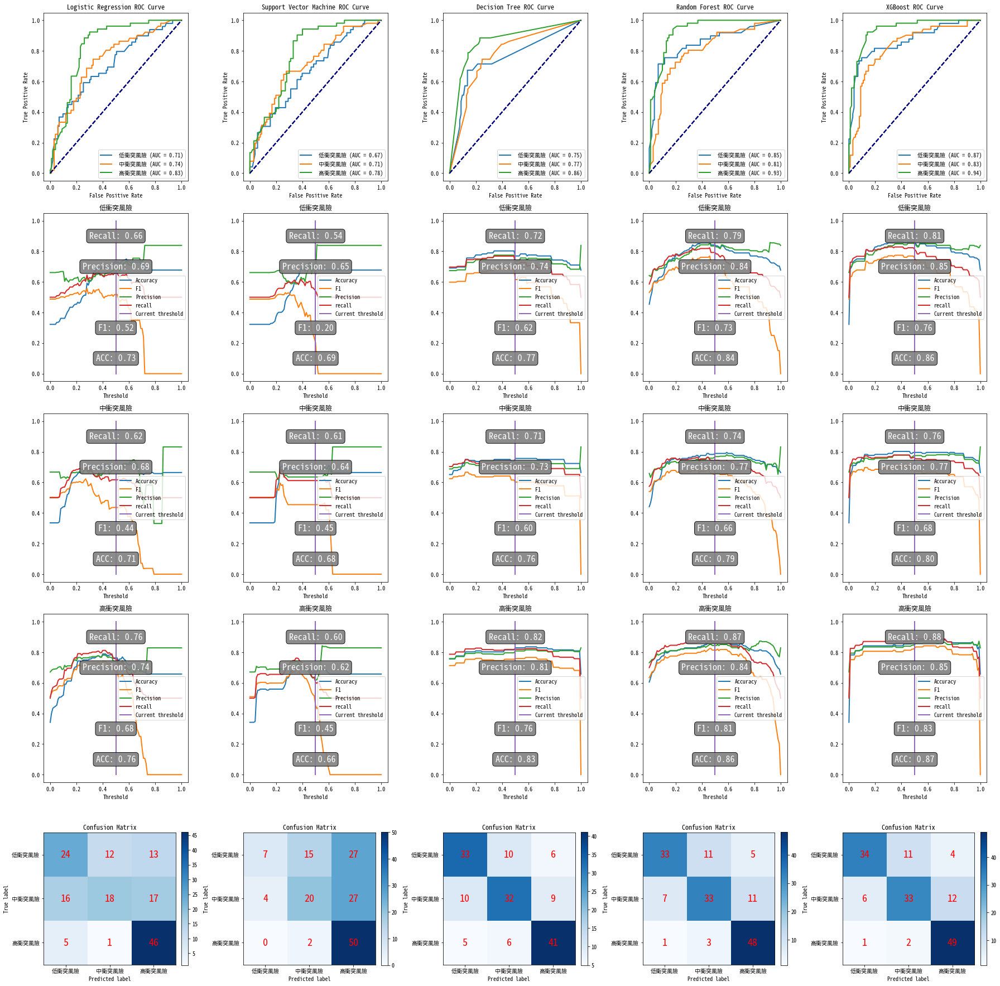

第7次測試結果


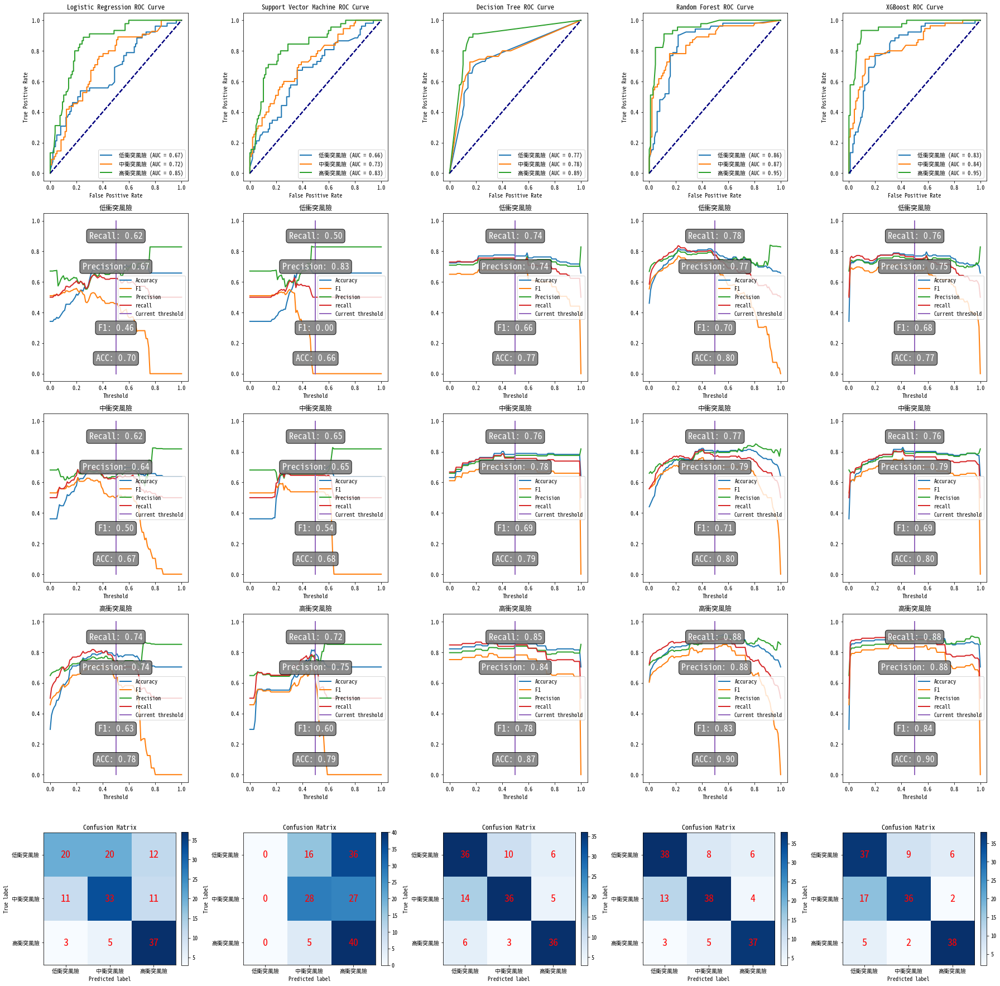

第8次測試結果


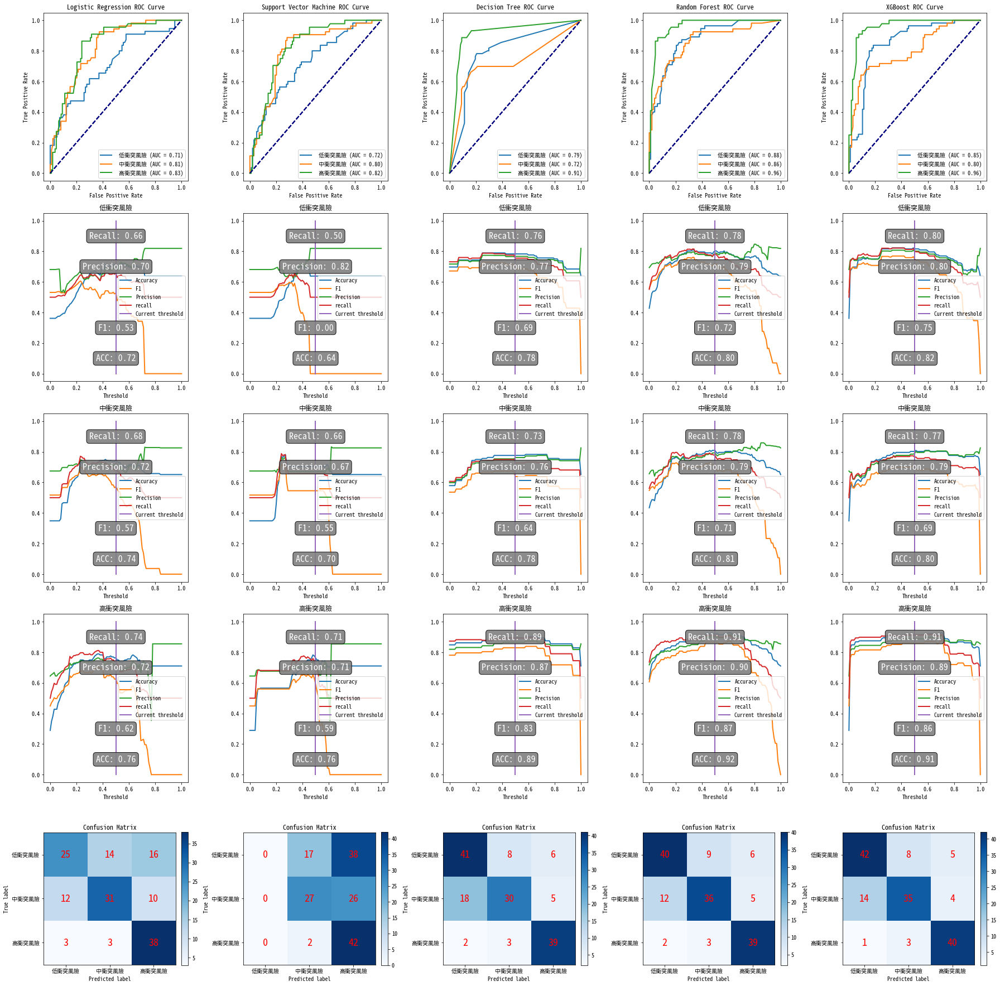

第9次測試結果


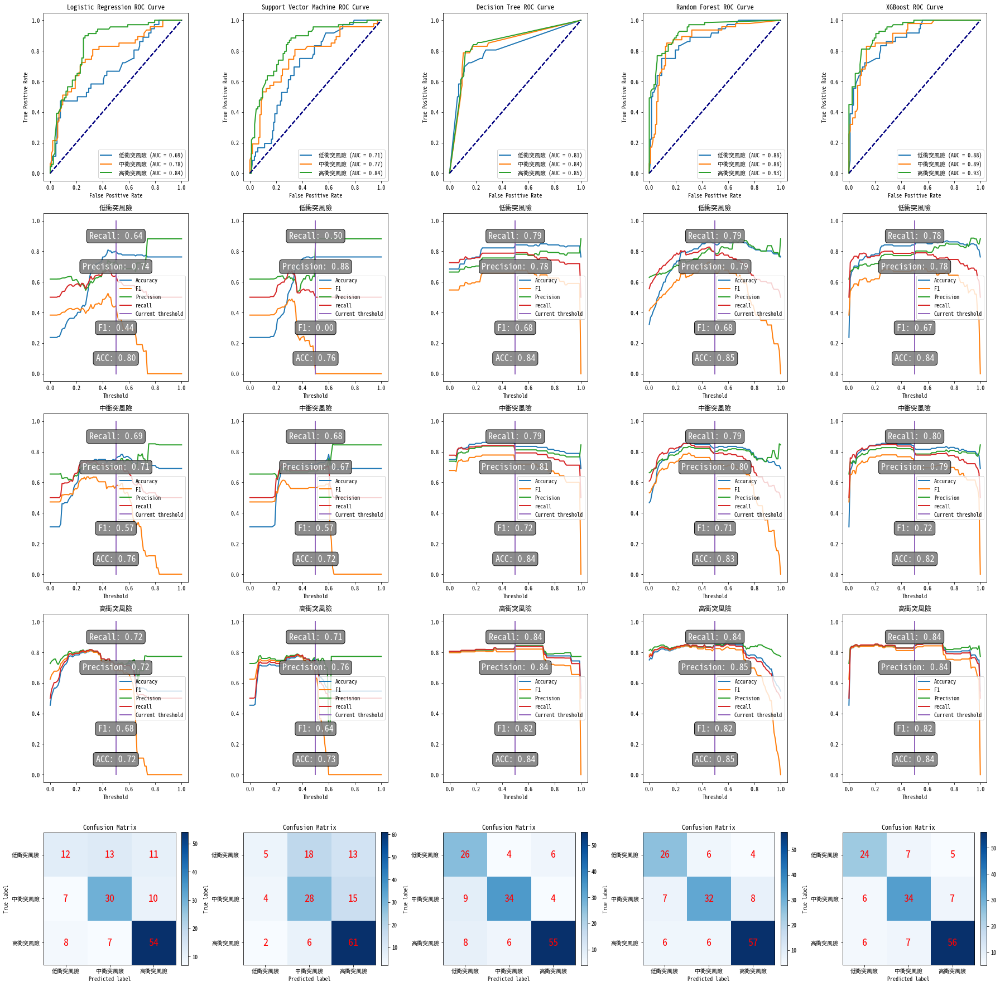

第10次測試結果


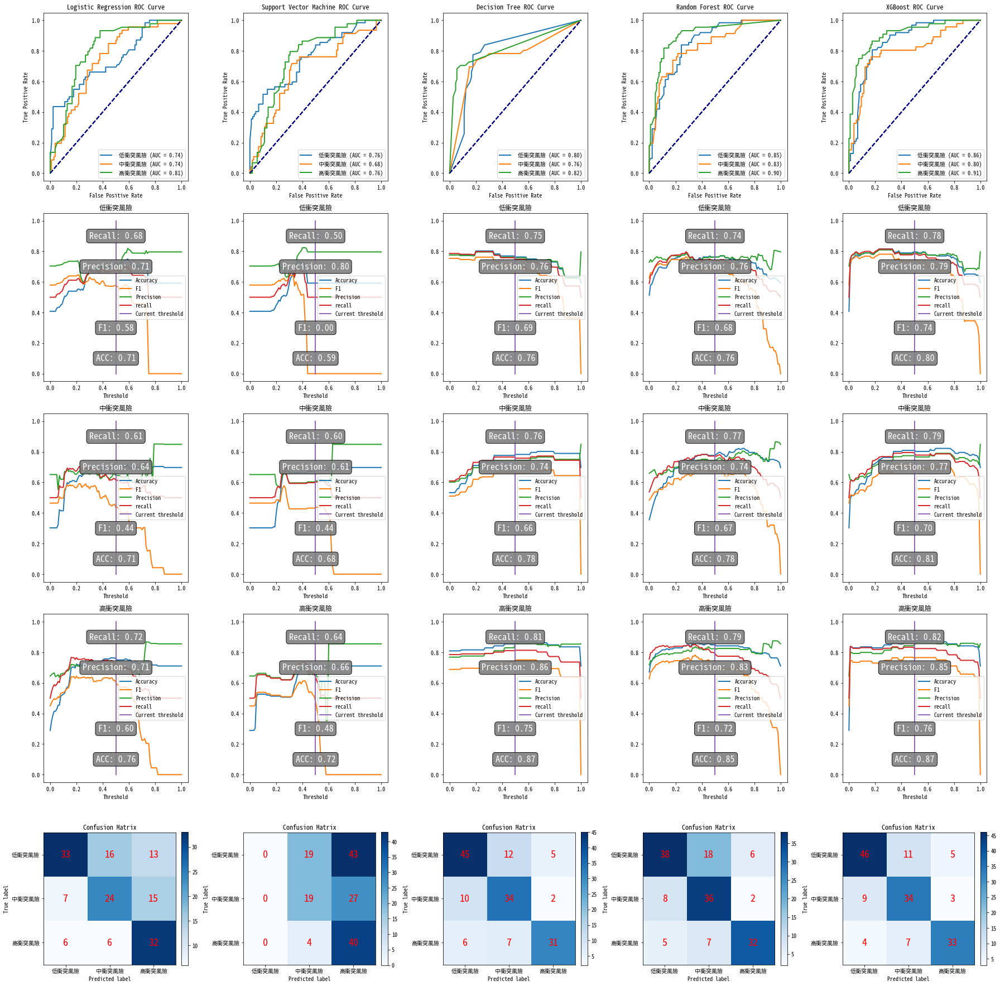

In [154]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, auc, confusion_matrix, f1_score, precision_score, recall_score
import matplotlib.pyplot as plt

threshold_setting = 0.5

def split_data(X, y, n_splits=10):
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)
    return kf.split(X, y)
        
step = 1
for train_index, test_index in split_data(X_res, y_res):
    X_train, X_test = X_res.iloc[train_index], X_res.iloc[test_index]
    y_train, y_test = y_res.iloc[train_index], y_res.iloc[test_index]
    fig, axs = plt.subplots(5, 5, figsize=(25, 25))
    
    
    print(f'第{step}次測試結果')
    step+=1
    i = 0
    for name, model_fn in models.items():
        
        #row1
        model = model_fn(X_train, y_train)
        y_pred_proba = model.predict_proba(X_test)

        fpr = dict()
        tpr = dict()
        roc_auc = dict()
        for j in range(len(model.classes_)):
            y_true_class_j = (y_test == j).astype(int)
            fpr[j], tpr[j], _ = roc_curve(y_true_class_j, y_pred_proba[:, j])
            roc_auc[j] = auc(fpr[j], tpr[j])
            
            
        for j, label in enumerate(["低衝突風險", "中衝突風險", "高衝突風險"]):            
            axs[0, i].plot(fpr[j], tpr[j], lw=2, label=f' {label} (AUC = {roc_auc[j]:.2f})')
            axs[0, i].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
            axs[0, i].set_xlabel('False Positive Rate')
            axs[0, i].set_ylabel('True Positive Rate')
            axs[0, i].set_title(f'{name} ROC Curve')
            axs[0, i].legend(loc="lower right")
        
        #row2
        for j, label in enumerate(["低衝突風險", "中衝突風險", "高衝突風險"]):  
            thres_list = []
            acc_tmp = []
            f1_tmp = []
            precision_tmp = []
            recall_tmp = []
            for thres_idx in range(101):
                thres_tmp = float(thres_idx)/100

                y_test_pred_tmp = (y_pred_proba[:,j] > thres_tmp).astype(int)
                y_true_class_j = (y_test == j).astype(int)
                thres_list.append(thres_tmp)

                cm_tmp = confusion_matrix(y_true_class_j, y_test_pred_tmp)
                acc_tmp.append(accuracy_score(y_true_class_j, y_test_pred_tmp))
                f1_tmp.append(f1_score(y_true_class_j, y_test_pred_tmp))
                precision_tmp.append(precision_score(y_true_class_j, y_test_pred_tmp, average='macro', zero_division=1))
                recall_tmp.append(recall_score(y_true_class_j, y_test_pred_tmp, average='macro'))

                if (threshold_setting == thres_tmp):
                    current_threshold_acc = accuracy_score(y_true_class_j, y_test_pred_tmp)
                    current_threshold_f1 = f1_score(y_true_class_j, y_test_pred_tmp)
                    current_threshold_cm = confusion_matrix(y_true_class_j, y_test_pred_tmp)
                    current_threshold_precision = precision_score(y_true_class_j, y_test_pred_tmp, average='macro', zero_division=1)
                    current_threshold_recall = recall_score(y_true_class_j, y_test_pred_tmp, average='macro')
                  
            axs[j+1, i].plot(thres_list, acc_tmp, lw=2, label=f'Accuracy')
            axs[j+1, i].plot(thres_list, f1_tmp, lw=2, label=f'F1')
            axs[j+1, i].plot(thres_list, precision_tmp, lw=2, label=f'Precision')
            axs[j+1, i].plot(thres_list, recall_tmp, lw=2, label=f'recall')
            axs[j+1, i].plot([threshold_setting,threshold_setting], [0, 1], lw=2, label=f'Current threshold')

            axs[j+1, i].set_xlabel('Threshold')
            axs[j+1, i].legend(loc="right")
            axs[j+1, i].set_title(f'{label}')

            axs[j+1, i].text(0.5, 0.1, f'ACC: {current_threshold_acc:.2f}',
                         fontsize=16, ha='center', va='center',
                         bbox=dict(boxstyle='round', facecolor='gray', alpha=0.9),
                         color='white')
            axs[j+1, i].text(0.5, 0.3, f'F1: {current_threshold_f1:.2f}',
                         fontsize=16, ha='center', va='center',
                         bbox=dict(boxstyle='round', facecolor='gray', alpha=0.9),
                         color='white')
            axs[j+1, i].text(0.5, 0.7, f'Precision: {current_threshold_precision:.2f}',
                         fontsize=16, ha='center', va='center',
                         bbox=dict(boxstyle='round', facecolor='gray', alpha=0.9),
                         color='white')
            axs[j+1, i].text(0.5, 0.9, f'Recall: {current_threshold_recall:.2f}',
                         fontsize=16, ha='center', va='center',
                         bbox=dict(boxstyle='round', facecolor='gray', alpha=0.9),
                         color='white')
            
        #row 3
        # 繪製混淆矩陣
        y_pred = model.predict(X_test)
        cm = confusion_matrix(y_test, y_pred)
        
        im = axs[4, i].imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
        axs[4, i].set_title(f'Confusion Matrix')
        plt.colorbar(im, ax=axs[4, i], fraction=0.046, pad=0.04)
        tick_marks = np.arange(len(np.unique(y_test)))
        axs[4, i].set_xticks(tick_marks)
        axs[4, i].set_yticks(tick_marks)
        axs[4, i].set_xticklabels(["低衝突風險", "中衝突風險", "高衝突風險"])
        axs[4, i].set_yticklabels(["低衝突風險", "中衝突風險", "高衝突風險"])
        axs[4, i].set_ylabel('True label')
        axs[4, i].set_xlabel('Predicted label')

        # 在每個格子上顯示數量
        for ii in range(len(np.unique(y_test))):
            for jj in range(len(np.unique(y_test))):
                axs[4, i].text(jj, ii, f'{cm[ii, jj]}', ha='center', va='center', color='red',fontsize=18)
            
            
            
        i+=1
                
        
    plt.tight_layout()
    plt.show()

### 個別畫圖

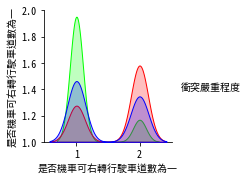

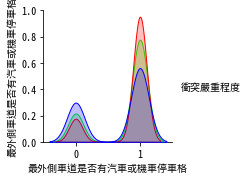

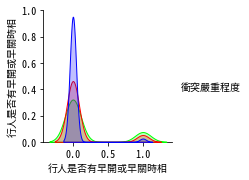

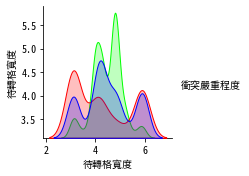

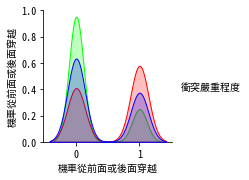

...

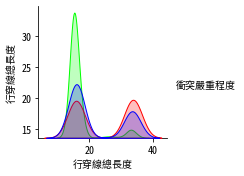

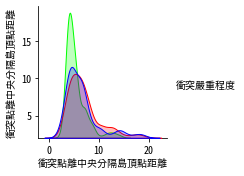

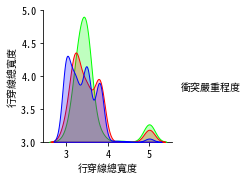

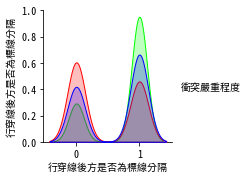

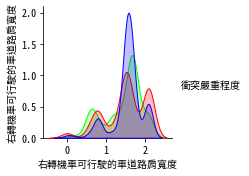

In [48]:
# #對角分布圖
# import seaborn as sns
# import matplotlib.pyplot as plt
# import pandas as pd

# # 合併 X 和 y 資料
# merged_data = pd.concat([X_res, y_res], axis=1)

# # 循环处理每个变量
# for column in merged_data.columns[:-1]:  # 不包括最后一列作为目标变量
#     # 计算变量的最小值和最大值
#     min_value = merged_data[column].min()
#     max_value = merged_data[column].max()
    
#     # 绘制带有目标变量 y 的核密度估计图
#     g = sns.pairplot(data=merged_data, hue='衝突嚴重程度', palette=["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"], vars=[column], kind='kde')
#     g.set(ylim=(min_value, max_value))  # 设置 y 轴范围为变量的最小值到最大值
    
#     # 根据变量名称生成文件名
#     filename = f'./image_left/對角圖_{column}.png'
    
#     # 保存图形
#     plt.savefig(filename)
    
#     # 显示图形
# #     plt.show()
    
# #~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


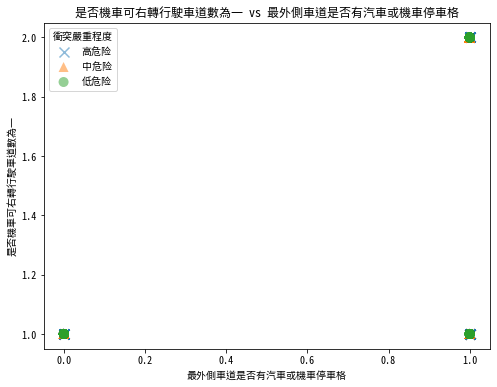

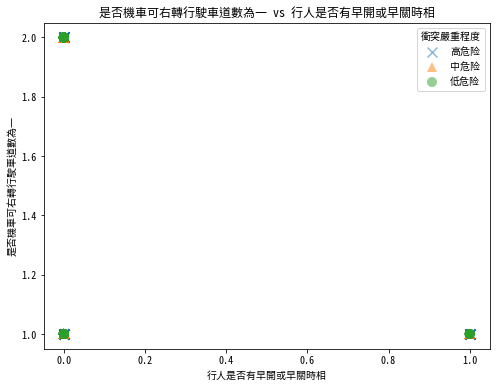

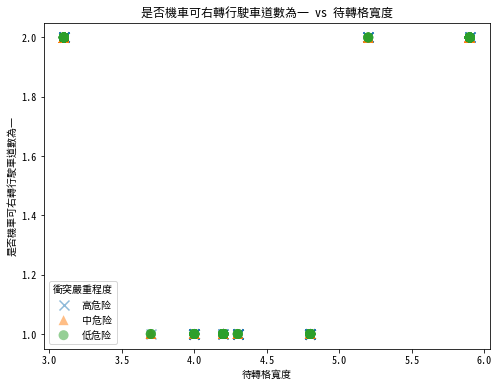

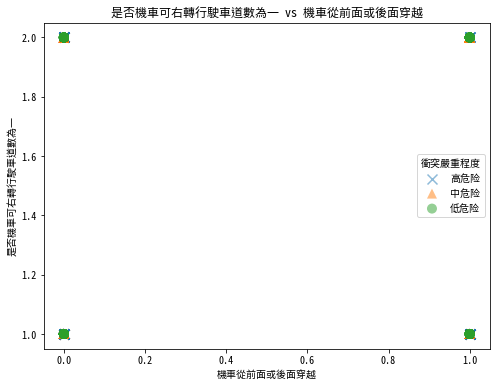

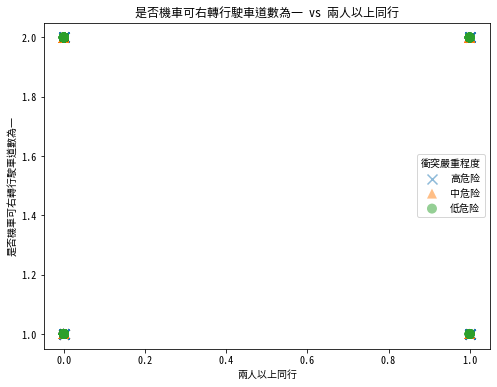

...

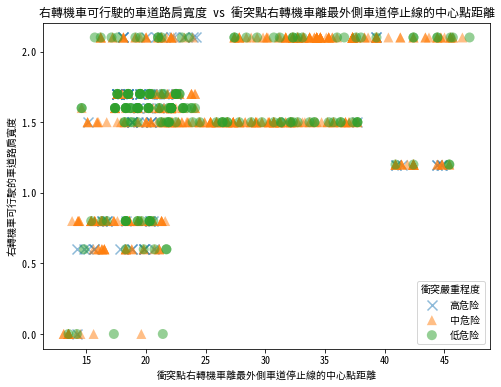

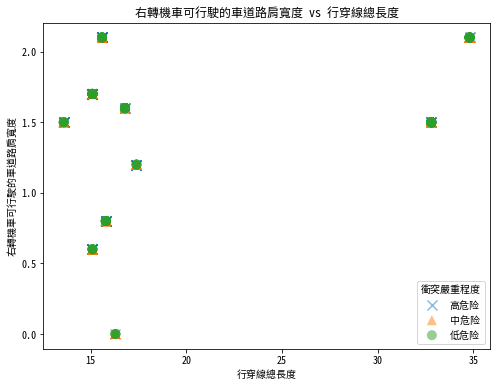

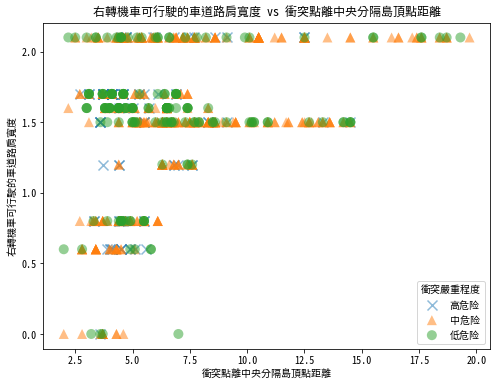

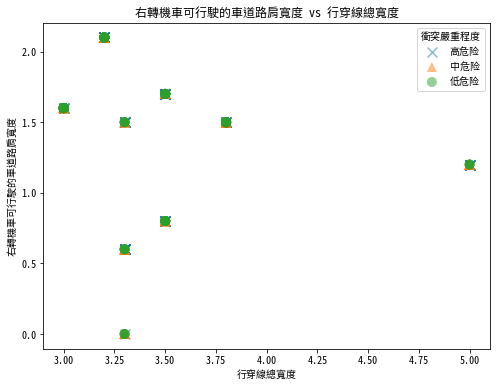

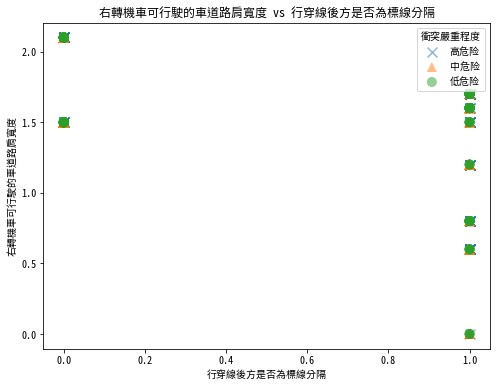

In [85]:
# #非對角分布圖
# import seaborn as sns
# import matplotlib.pyplot as plt
# import pandas as pd

# # 合併 X 和 y 資料
# merged_data = pd.concat([X, y], axis=1)
# # merged_data = merged_data.drop('const', axis=1)
# # 定義不同形狀
# markers_dict = {2:"x", 1:"^", 0:"o"}
# label_dict = {"x": '高危险', "^": '中危险', "o": '低危险'}
# # 使用雙層迴圈繪製每個子圖
# for i, column_i in enumerate(merged_data.columns[:-1]):  # 不包括最后一列作为目标变量
#     for j, column_j in enumerate(merged_data.columns[:-1]):
#         # 对角线上的图不保存
#         if i != j:
#             # 创建新的图形
#             plt.figure(figsize=(8, 6))
            
#             # 绘制散点图
# #             sns.scatterplot(data=merged_data, x=merged_data.columns[j], y=merged_data.columns[i], markers_dict, hue='衝突嚴重程度', palette=["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"], edgecolor='face', legend=False)
            
#             # 根據 '衝突嚴重程度' 選擇形狀
#             markers = merged_data['衝突嚴重程度'].map(markers_dict)
            
#             # 绘制散点图，根據不同的形狀
# #             sns.scatterplot(data=merged_data, x=merged_data.columns[j], y=merged_data.columns[i], hue='衝突嚴重程度', palette=["#0000FF","#FF0000","#00FF00","#FFFF00","#FF00FF","#00FFFF"], style=markers, markers=markers_dict.values(), edgecolor='face', legend=False)
#             # 繪製散點圖，根據不同的形狀
#             for marker_type in markers_dict.values():
#                 subset = merged_data[markers == marker_type]
#                 plt.scatter(subset[merged_data.columns[j]], subset[merged_data.columns[i]], marker=marker_type, label=label_dict[marker_type], edgecolor='none', alpha=0.5, s=100)


#             # 设置标题
#             plt.title(f'{column_i} vs {column_j}')
            
#             plt.legend(title='衝突嚴重程度')
            
#             # 设置 x 轴和 y 轴标签
#             plt.xlabel(column_j)
#             plt.ylabel(column_i)
            
#             # 保存图形
#             filename = f'./image_left/{column_i}_{column_j}.png'
#             plt.savefig(filename)
            
#             # 显示图形
# #             plt.show()


# 測試

In [49]:
X.columns
# X.shape

Index(['右轉機車可行駛的車道路肩寬度', '待轉格深度', '待轉格寬度', '行穿線至代轉格的直線距離', '行穿線總長度', '行穿線總寬度',
       '衝突點至行穿線退縮距離臨向右側路口路緣的長度', '衝突點離中央分隔島頂點距離', '衝突點離待轉格幾何中心距離',
       '衝突點右轉機車離最外側車道停止線的中心點距離', '是否機車可右轉行駛車道數為一_1', '是否機車可右轉行駛車道數為一_2',
       '行人是否有早開或早關時相_0', '行人是否有早開或早關時相_1'],
      dtype='object')

In [451]:
# X = X.drop('const', axis=1)

In [93]:
X = X.drop(['機車從前面或後面穿越','兩人以上同行'], axis=1)
X = pd.get_dummies(X, columns=['是否機車可右轉行駛車道數為一', '行人是否有早開或早關時相'])


In [102]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import numpy as np
# from tqdm import tqdm
# from itertools import combinations
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import accuracy_score
# from sklearn.linear_model import LogisticRegression
# from sklearn.svm import SVC
# from sklearn.tree import DecisionTreeClassifier
# from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
# import math
# import statsmodels.api as sm
# from statsmodels.stats.outliers_influence import variance_inflation_factor
# from sklearn.metrics import cohen_kappa_score
# from sklearn.metrics import matthews_corrcoef
# from sklearn.metrics import roc_auc_score
# from sklearn.metrics import precision_score, recall_score, f1_score
# from scipy.stats import spearmanr
# import xgboost as xgb




# print(f'組合有 ： {len(list(combinations(X.columns, 8)))}')
# print(f'特徵有 ： {len(X.columns)}\n{X.columns}')

# # 先取7个特徵開始
# total_combinations = math.comb(len(X.columns), 8)
# progress_bar = tqdm(total=total_combinations)

# # 创建特征名称到索引的映射字典
# feature_index_map = {feature: i for i, feature in enumerate(X.columns)}

# for features_combination in combinations(X.columns, 8):
#     X_combination = X[list(features_combination)]
#     X_train, X_test, y_train, y_test = train_test_split(X_combination, y, test_size=0.2, random_state=42)
        
#     #spearmanr
#     correlation_matrix, _ = spearmanr(X_train)
#     correlation_X_train = pd.DataFrame(correlation_matrix, index=X_train.columns, columns=X_train.columns)
#     features_combination_indices = [feature_index_map[feature] for feature in features_combination]
#     features_combination_string = '_'.join(map(str, features_combination_indices))
#     correlation_X_train.to_csv(f'./output/Details folder/spearmanr/{features_combination_string}.csv', index=False, encoding='utf-8')

#     progress_bar.update(1)

# progress_bar.close()

                                    

# print(f"\n\ndone!")

組合有 ： 3003
特徵有 ： 14
Index(['右轉機車可行駛的車道路肩寬度', '待轉格深度', '待轉格寬度', '行穿線至代轉格的直線距離', '行穿線總長度', '行穿線總寬度',
       '衝突點至行穿線退縮距離臨向右側路口路緣的長度', '衝突點離中央分隔島頂點距離', '衝突點離待轉格幾何中心距離',
       '衝突點右轉機車離最外側車道停止線的中心點距離', '是否機車可右轉行駛車道數為一_1', '是否機車可右轉行駛車道數為一_2',
       '行人是否有早開或早關時相_0', '行人是否有早開或早關時相_1'],
      dtype='object')


100%|██████████| 3003/3003 [01:31<00:00, 32.86it/s]



done!


In [103]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import numpy as np
# from tqdm import tqdm
# from itertools import combinations
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import accuracy_score
# from sklearn.linear_model import LogisticRegression
# from sklearn.svm import SVC
# from sklearn.tree import DecisionTreeClassifier
# from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
# import math
# import statsmodels.api as sm
# from statsmodels.stats.outliers_influence import variance_inflation_factor
# from sklearn.metrics import cohen_kappa_score
# from sklearn.metrics import matthews_corrcoef
# from sklearn.metrics import roc_auc_score
# from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix
# from scipy.stats import spearmanr
# import xgboost as xgb

# # 初始化模型
# logistic_regression = LogisticRegression(max_iter=1000)
# support_vector_machine = SVC(probability=True)
# decision_tree = DecisionTreeClassifier()
# random_forest = RandomForestClassifier()
# gradient_boosting = GradientBoostingClassifier()
# xgboost = xgb.XGBClassifier(objective ='multi:softmax', num_class=len(np.unique(y_train)))

# # 建立模型字典
# models = {
#     'Logistic Regression': logistic_regression,
#     'Support Vector Machine': support_vector_machine,
#     'Decision Tree': decision_tree,
#     'Random Forest': random_forest,
#     'XGBoost' : xgboost
# }

# # 儲存精確度的字典
# accuracy_dict = {name: [] for name in models}
# auc_dict = {name: [] for name in models}
# f1_dict = {name: [] for name in models}
# precision_dict = {name: [] for name in models}
# recall_dict = {name: [] for name in models}


# print(f'組合有 ： {len(list(combinations(X.columns, 8)))}')
# print(f'特徵有 ： {len(X.columns)}\n{X.columns}')

# # 先取7个特徵開始
# total_combinations = math.comb(len(X.columns), 8)
# progress_bar = tqdm(total=total_combinations)

# # 创建特征名称到索引的映射字典
# feature_index_map = {feature: i for i, feature in enumerate(X.columns)}

# for features_combination in combinations(X.columns, 8):
#     X_combination = X[list(features_combination)]
#     X_train, X_test, y_train, y_test = train_test_split(X_combination, y, test_size=0.2, random_state=42)
#     for name, model in models.items():
#         model.fit(X_train, y_train)
#         y_pred = model.predict(X_test)
        
#         accuracy = accuracy_score(y_test, y_pred)
#         accuracy_dict[name].append((list(features_combination), accuracy))

#         #auc
# #             y_pred_auc = np.array(y_pred).reshape(-1, 1)
#         y_pred_proba = model.predict_proba(X_test)
#         auc = roc_auc_score(y_test, y_pred_proba, multi_class='ovr')
#         auc_dict[name].append((list(features_combination), auc))

#         #f1
#         f1 = f1_score(y_test, y_pred, average='macro')
#         f1_dict[name].append((list(features_combination), f1))

#         #precision
#         precision = precision_score(y_test, y_pred, average='macro', zero_division=1)
#         precision_dict[name].append((list(features_combination), precision))

#         #recall
#         recall = recall_score(y_test, y_pred, average='macro')
#         recall_dict[name].append((list(features_combination), recall))

#     progress_bar.update(1)

# progress_bar.close()


# data_auc = {name: [auc[1] for auc in aucs] for name, aucs in auc_dict.items()}
# feature_combinations = list(auc_dict.values())[0]
# data_auc["features_combination"] = [auc[0] for auc in feature_combinations]  # 使用第一个模型的特征组合作为参考
# df_auc = pd.DataFrame(data_auc)
# df_auc.to_csv('./output/auc_results.csv', index=False, encoding='utf-8')             
                                     

# data_f1 = {name: [f1[1] for f1 in f1s] for name, f1s in f1_dict.items()}
# feature_combinations = list(f1_dict.values())[0]
# data_f1["features_combination"] = [f1[0] for f1 in feature_combinations]  # 使用第一个模型的特征组合作为参考
# df_f1 = pd.DataFrame(data_f1)
# df_f1.to_csv('./output/f1_results.csv', index=False, encoding='utf-8')                                        
                                     
# data_precision = {name: [precision[1] for precision in precisions] for name, precisions in precision_dict.items()}
# feature_combinations = list(precision_dict.values())[0]
# data_precision["features_combination"] = [precision[0] for precision in feature_combinations]  # 使用第一个模型的特征组合作为参考
# df_precision = pd.DataFrame(data_precision)
# df_precision.to_csv('./output/precision_results.csv', index=False, encoding='utf-8')
                                     
# data_recall = {name: [recall[1] for recall in recalls] for name, recalls in recall_dict.items()}
# feature_combinations = list(recall_dict.values())[0]
# data_recall["features_combination"] = [recall[0] for recall in feature_combinations]  # 使用第一个模型的特征组合作为参考
# df_recall = pd.DataFrame(data_recall)
# df_recall.to_csv('./output/recall_results.csv', index=False, encoding='utf-8')

# data_acc = {name: [acc[1] for acc in accuracies] for name, accuracies in accuracy_dict.items()}
# feature_combinations = list(accuracy_dict.values())[0]
# data_acc["features_combination"] = [acc[0] for acc in feature_combinations]  # 使用第一个模型的特征组合作为参考
# df_acc = pd.DataFrame(data_acc)
# df_acc.to_csv('./output/accuracy_results.csv', index=False, encoding='utf-8')

# print(f"\n\ndone!")

組合有 ： 3003
特徵有 ： 14
Index(['右轉機車可行駛的車道路肩寬度', '待轉格深度', '待轉格寬度', '行穿線至代轉格的直線距離', '行穿線總長度', '行穿線總寬度',
       '衝突點至行穿線退縮距離臨向右側路口路緣的長度', '衝突點離中央分隔島頂點距離', '衝突點離待轉格幾何中心距離',
       '衝突點右轉機車離最外側車道停止線的中心點距離', '是否機車可右轉行駛車道數為一_1', '是否機車可右轉行駛車道數為一_2',
       '行人是否有早開或早關時相_0', '行人是否有早開或早關時相_1'],
      dtype='object')


  9%|▊         | 256/3003 [03:13<35:07,  1.30it/s]lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 25%|██▍       | 744/3003 [09:26<30:16,  1.24it/s]lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
 58%|█████▊    | 1730/3003 [22:15<17:14,  1.23it/s]lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the num



done!
